In [52]:
### Make notebook wider:

from IPython.display import display, HTML

display(HTML(data="""
<style>
    div#notebook-container    { width: 95%; }
    div#menubar-container     { width: 65%; }
    div#maintoolbar-container { width: 99%; }
</style>
"""))

In [53]:
import pandas as pd
import os
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import statistics
import json
from PIL import Image, ImageDraw, ImageFont

def sortperm_neurons(bkgd_log_proportions_array,config,neuron_response_df, sequence_ordering=None, th=0.2):
    ## this is number of neurons in total
    N_neurons= bkgd_log_proportions_array.shape[1]
    ## number of sequences from json file 
    n_sequences = config["num_sequence_types"]
    # the 18 neuron params for each neuron from the last iteration
    all_final_globals = neuron_response_df.iloc[-N_neurons:]
    # this cuts it down to just the first 6 params - i think this correspond sto the first param for each seq type? response probABILITY - ie the chance that a neuron spikes in a given latent seq 
    resp_prop = np.exp(all_final_globals.values[:, :n_sequences])#
    # this takes the next 6 params - which i think are the offset values
    offset = all_final_globals.values[-N_neurons:, n_sequences:2*n_sequences]
    ## finds the max response value - ie. which seq it fits to? 
    peak_response = np.amax(resp_prop, axis=1)
    # then threshold the reponse
    has_response = peak_response > np.quantile(peak_response, th)
    # I thin this is the sequence that the neuron has the max response for: ie. we are ordering them by max response 
    preferred_type = np.argmax(resp_prop, axis=1)
    if sequence_ordering is None:
        # order them by max reponse 
        ordered_preferred_type = preferred_type
    else:
        #order them differnetly 
        ordered_preferred_type = np.zeros(N_neurons)#
        # loop through each sequence
        for seq in range(n_sequences):
            # where does  max repsone = user defined seque
            seq_indices = np.where(preferred_type == sequence_ordering[seq])
            # change order to different seq
            ordered_preferred_type[seq_indices] = seq

    # reorder the offset params according to max respsone
    preferred_delay = offset[np.arange(N_neurons), preferred_type]
    Z = np.stack([has_response, ordered_preferred_type+1, preferred_delay], axis=1)
    indexes = np.lexsort((Z[:, 2], Z[:, 1], Z[:, 0]))
    return indexes,ordered_preferred_type

# Function to find corresponding number in another column
def find_corresponding(nums):
    return [df_dict[num] for num in nums]

def split_list(nums):
    sublists = []
    current_sublist = [nums[0]]
    current_element = nums[0]
    for i in range(1,len(nums)):
        if nums[i] == current_element:
            current_sublist.append(nums[i])
        else:
            sublists.append(current_sublist)
            current_sublist = [nums[i]]
            current_element = nums[i]
    sublists.append(current_sublist)
    return sublists

def conactinate_nth_items(startlist):
    concatinated_column_vectors = []
    for c in range(len(max(startlist, key=len))):
        column = []
        for t in range(len(startlist)):
            if c <= len(startlist[t])-1:
                column = column + [startlist[t][c]]
        concatinated_column_vectors.append(column)
    return concatinated_column_vectors

def load_H5_bodypart(tracking_path,video_type, tracking_point):

    # Load in all '.h5' files for a given folder:
    TFiles_unsort = list_files(tracking_path, 'h5')

    for file in TFiles_unsort:
        print(file)
        if video_type in file:
            if 'task' in file:
                back_file = pd.read_hdf(tracking_path + file)     
                
    # drag data out of the df
    scorer = back_file.columns.tolist()[0][0]
    body_part = back_file[scorer][tracking_point]
    
    parts=[]
    for item in list(back_file[scorer]):
        parts+=[item[0]]
    print(np.unique(parts))
    
    # clean and interpolate frames with less than 98% confidence
    clean_and_interpolate(body_part,0.98)
    
    return(body_part)
  
def load_H5_ports(tracking_path,video_type):

    # Load in all '.h5' files for a given folder:
    TFiles_unsort = list_files(tracking_path, 'h5')

    for file in TFiles_unsort:
        print(file)
        if video_type in file:
            if 'port' in file:
                back_ports_file = pd.read_hdf(tracking_path + file)

    ## same for the ports:
    scorer = back_ports_file.columns.tolist()[0][0]
        
    if video_type == 'back':
        port1 =back_ports_file[scorer]['port2']
        port2 =back_ports_file[scorer]['port1']
        port3 =back_ports_file[scorer]['port6']
        port4 =back_ports_file[scorer]['port3']
        port5 =back_ports_file[scorer]['port7']
    else:
        port1 =back_ports_file[scorer]['Port2']
        port2 =back_ports_file[scorer]['Port1']
        port3 =back_ports_file[scorer]['Port6']
        port4 =back_ports_file[scorer]['Port3']
        port5 =back_ports_file[scorer]['Port7']

    clean_and_interpolate(port1,0.98)
    clean_and_interpolate(port2,0.98)
    clean_and_interpolate(port3,0.98)
    clean_and_interpolate(port4,0.98)
    clean_and_interpolate(port5,0.98)
    
    return(port1,port2,port3,port4,port5)

def list_files(directory, extension):
    return (f for f in os.listdir(directory) if f.endswith('.' + extension))

def clean_and_interpolate(head_centre,threshold):
    bad_confidence_inds = np.where(head_centre.likelihood.values<threshold)[0]
    newx = head_centre.x.values
    newx[bad_confidence_inds] = 0
    newy = head_centre.y.values
    newy[bad_confidence_inds] = 0

    start_value_cleanup(newx)
    interped_x = interp_0_coords(newx)

    start_value_cleanup(newy)
    interped_y = interp_0_coords(newy)
    
    head_centre['interped_x'] = interped_x
    head_centre['interped_y'] = interped_y
    
def start_value_cleanup(coords):
    # This is for when the starting value of the coords == 0; interpolation will not work on these coords until the first 0 
    #is changed. The 0 value is changed to the first non-zero value in the coords lists
    for index, value in enumerate(coords):
        working = 0
        if value > 0:
            start_value = value
            start_index = index
            working = 1
            break
    if working == 1:
        for x in range(start_index):
            coords[x] = start_value
            
def interp_0_coords(coords_list):
    #coords_list is one if the outputs of the get_x_y_data = a list of co-ordinate points
    for index, value in enumerate(coords_list):
        if value == 0:
            if coords_list[index-1] > 0:
                value_before = coords_list[index-1]
                interp_start_index = index-1
                #print('interp_start_index: ', interp_start_index)
                #print('interp_start_value: ', value_before)
                #print('')

        if index < len(coords_list)-1:
            if value ==0:
                if coords_list[index+1] > 0:
                    interp_end_index = index+1
                    value_after = coords_list[index+1]
                    #print('interp_end_index: ', interp_end_index)
                    #print('interp_end_value: ', value_after)
                    #print('')

                    #now code to interpolate over the values
                    try:
                        interp_diff_index = interp_end_index - interp_start_index
                    except UnboundLocalError:
#                         print('the first value in list is 0, use the function start_value_cleanup to fix')
                        break
                    #print('interp_diff_index is:', interp_diff_index)

                    new_values = np.linspace(value_before, value_after, interp_diff_index)
                    #print(new_values)

                    interp_index = interp_start_index+1
                    for x in range(interp_diff_index):
                        #print('interp_index is:', interp_index)
                        #print('new_value should be:', new_values[x])
                        coords_list[interp_index] = new_values[x]
                        interp_index +=1
        if index == len(coords_list)-1:
            if value ==0:
                for x in range(30):
                    coords_list[index-x] = coords_list[index-30]
                    #print('')
#     print('function exiting')
    return(coords_list)

def SaveFig(file_name,figure_dir):
    if not os.path.isdir(figure_dir):
        os.makedirs(figure_dir)
    plt.savefig(figure_dir + file_name, bbox_inches='tight')
    plt.show()
    plt.close()

def convolve_movmean(y,N):
    y_padded = np.pad(y, (N//2, N-1-N//2), mode='edge')
    y_smooth = np.convolve(y_padded, np.ones((N,))/N, mode='valid') 
    return y_smooth

In [54]:
mouse_session_recording = '270_1_5'
region = 'striatum'

## PATHS
PP_PATH = r"Z:\projects\sequence_squad\organised_data\ppseq_data\finalised_output\striatum\awake\\"
DAT_PATH = r"Z:\projects\sequence_squad\organised_data\animals\\"



## set ppseq file
for file_ in os.listdir(PP_PATH):
    if mouse_session_recording in file_:
        file = file_
        
save_path = PP_PATH + file + '\\analysis_output\\'
        
## set dat_path:
for file_ in os.listdir(DAT_PATH):
    if mouse_session_recording.split('_')[0] in file_:
        if mouse_session_recording.split('_')[1] == file_[-1]:
            dat_path = os.path.join(DAT_PATH,file_)
for recording in os.listdir(os.path.join(DAT_PATH,dat_path)):
    if recording.split('_')[0][-1] == mouse_session_recording.split('_')[-1]:
        dat_path = os.path.join(dat_path,recording)
        
# set tracking path
for file_ in os.listdir(dat_path + r"\video\tracking\\"):
    if 'task' in file_:
        if not 'clock' in file_:
            tracking_path = os.path.join(dat_path + r"\video\tracking\\",file_) + '\\'
# set video paths
for file_ in os.listdir(dat_path + r"\video\videos\\"):
    if 'task' in file_:
        if not 'clock' in file_:
            cam_path = os.path.join(dat_path + r"\video\videos\\",file_) + '\\' 
            for vid_file in os.listdir(cam_path):
                if 'back' in vid_file and '.avi' in vid_file:
                    back_cam_avi_path = os.path.join(cam_path,vid_file)
                if 'side' in vid_file and '.avi' in vid_file:
                    side_cam_avi_path = os.path.join(cam_path,vid_file)

In [55]:

print('\n')
print("LOADING processed_spike_data")
### load in releavent things:

import pickle
with open(PP_PATH + file + "\\analysis_output\\" + "spikes_seq_type_adjusted.pickle", "rb") as input_file:
    unmasked_spikes_df = pickle.load(input_file)

with open(os.path.join(os.path.join(PP_PATH,file) + r"\analysis_output\reordered_recolored\neuron_order"), "rb") as input_file:
    neuron_order = pickle.load(input_file)
    
with open(os.path.join(os.path.join(PP_PATH,file) + r"\analysis_output\reordered_recolored\colors"), "rb") as input_file:
    colors = pickle.load(input_file)
    
with open(os.path.join(os.path.join(PP_PATH,file) + r"\analysis_output\reordered_recolored\neuron_index"), "rb") as input_file:
    neuron_index = pickle.load(input_file)
    
with open(PP_PATH + file + "\\analysis_output\\" + "latent_event_history_df_split.pickle", "rb") as input_file:
    latent_event_history_df_split = pickle.load(input_file)

ordered_preferred_type = np.load(PP_PATH + file + "\\analysis_output\\" + 'ordered_preferred_type.npy')

bkgd_log_proportions_array = pd.read_csv(PP_PATH + file + r"\bkgd_log_proportions_array.csv")


##### load deeplabcut tracking data
print('\n')
print("LOADING DLC TRACKING DATA")
back_head_centre = load_H5_bodypart(tracking_path,'back','head_centre')
back_p1,back_p2,back_p3,back_p4,back_p5 = load_H5_ports(tracking_path,'back')


## load in the timespan used for pppseq:
input_params_path = os.path.join(PP_PATH + file,'trainingData\\') + ('params_' + mouse_session_recording +'.json')
# Opening JSON file
f = open(input_params_path)
# returns JSON object as  a dictionary
input_config = json.load(f)
behav_time_interval_start = input_config['time_span'][0]
print(f"      A corresponding time span has been found. Time span set to {behav_time_interval_start}")


## LOAD behaviour data
print('\n')
print("LOADING BEHAV DATA")
behav_sync = pd.read_csv(dat_path + r'\behav_sync\2_task\Behav_Ephys_Camera_Sync.csv')
transitions = pd.read_csv(dat_path + r'\behav_sync\2_task\Transition_data_sync.csv')

behav_mask = (behav_sync.PokeIN_EphysTime>behav_time_interval_start[0])*(behav_sync.PokeIN_EphysTime<behav_time_interval_start[1])
poke_in_times = (behav_sync[behav_mask].PokeIN_EphysTime) - behav_time_interval_start[0]
ports = behav_sync[behav_mask].Port
print('done')







LOADING processed_spike_data


LOADING DLC TRACKING DATA
back_2023-05-17T17_44_44DLC_resnet50_port-tracking_back_viewMay2shuffle1_500000.h5
back_2023-05-17T17_44_44DLC_resnet50_Yellow-floor-task-tracking-backviewApr9shuffle1_800000.h5
side_2023-05-17T17_44_44DLC_resnet50_port-tracking_side-viewApr29shuffle1_700000.h5
side_2023-05-17T17_44_44DLC_resnet50_task-tracking-sideviewApr15shuffle1_670000.h5
['head_centre' 'implant_centre' 'left_ear' 'right_ear' 'tail_base']
back_2023-05-17T17_44_44DLC_resnet50_port-tracking_back_viewMay2shuffle1_500000.h5
back_2023-05-17T17_44_44DLC_resnet50_Yellow-floor-task-tracking-backviewApr9shuffle1_800000.h5
side_2023-05-17T17_44_44DLC_resnet50_port-tracking_side-viewApr29shuffle1_700000.h5
side_2023-05-17T17_44_44DLC_resnet50_task-tracking-sideviewApr15shuffle1_670000.h5
      A corresponding time span has been found. Time span set to [5450, 6050]


LOADING BEHAV DATA
done


# reorder and recolour if needed for generating synthetic data 

In [56]:
# # recolor and save these plots out

# current_color_order = [purple, blue, red, gold, yellow, green]


# colors = ['---',red,green,yellow,blue,purple,gold,dark_blue]
# # ## recolor based on current and desired color order

# new_order_inds = [0]
# for item in current_color_order:
#     new_order_inds += [np.where(np.array(colors) == item)[0][0]]

# # apply this ordering
# new_colors = colors.copy()
# for i,index in enumerate(new_order_inds):
#     colors[index] = new_colors[i]                     
                       
# # determine new ordering based on this as well
# ordering = list((np.array(new_order_inds)-1)[np.array(new_order_inds)-1 >=0])
# #swap last 'extra' seq down to the bottom 
# ordering = [ordering[-1]] + ordering[0:-1]

# print(ordering)



# # ########### IF ORDERING DOESNT WORK DO IT MANUALLY: ######

# # ordering = [1,5,3,0,4,2]

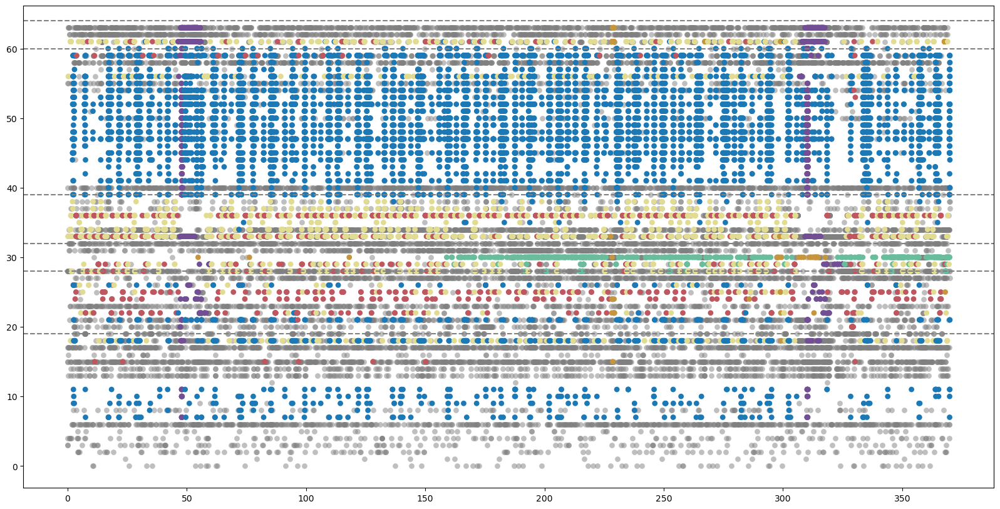

In [57]:
### Plot sequences - basic
timeframe = [0,370]
mask = (unmasked_spikes_df.timestamp>timeframe[0])*(unmasked_spikes_df.timestamp<timeframe[-1])

## neuron order:

#define neuron order
# neuron_index,ordered_preferred_type = sortperm_neurons(bkgd_log_proportions_array,config,neuron_response_df, sequence_ordering=ordering)
# # make a list of idndies for each neurons new position
# neuron_permute_loc = np.zeros(len(neuron_index))
# for i in range(len(neuron_index)):
#     neuron_permute_loc[i] = int(list(neuron_index).index(i))
# neuron_order = neuron_permute_loc[unmasked_spikes_df.neuron.values.astype(int)-1]

## plotting:

fig, ax = plt.subplots(1, 1,figsize=(20, 10))

#'#FF000000' is transparent
# colors = ['---','brown','red','blue','purple','orange','green','#FF000000']
    
# plot background in grey 
background_keep_mask = unmasked_spikes_df[mask].sequence_type_adjusted <= 0
ax.scatter(unmasked_spikes_df[mask][background_keep_mask].timestamp, neuron_order[mask][background_keep_mask],marker = 'o', s=40, linewidth=0,color = 'grey' ,alpha=0.5)

# plot spikes without background
background_remove_mask = unmasked_spikes_df[mask].sequence_type_adjusted >= 0
c_ = np.array(colors)[unmasked_spikes_df[mask][background_remove_mask].sequence_type_adjusted.values.astype(int)]
# ## faster:
ax.scatter(unmasked_spikes_df[mask][background_remove_mask].timestamp, neuron_order[mask][background_remove_mask],marker = 'o', s=40, linewidth=0,color = c_ ,alpha=1)

# for index, row in unmasked_spikes_df[mask].iterrows():
#     ax.plot(row.timestamp,np.where(neuron_index == row.neuron-1)[0][0], 'o', c = colors[int(row.sequence_type_adjusted)])



### add chunk lines:

## work out ordering chunk sizes
split_lists = split_list(ordered_preferred_type[neuron_index])
lens = []
for list_ in split_lists:
    lens += [len(list_)]
chunks = [sum(lens[0:int(np.unique(ordered_preferred_type)[-1]+1)])] + lens[int(np.unique(ordered_preferred_type)[-1]+1)::] 

## plot seq divding lines:
for i in range(len(chunks)):
    ax.axhline(y = np.cumsum(chunks)[i], color = 'grey', linestyle = '--')


### to do: move background neurons to the bottom and make them black

### now align to behaviour
## first in the same ay they did - ie. make the line plot 
#then align to deeplab cut 

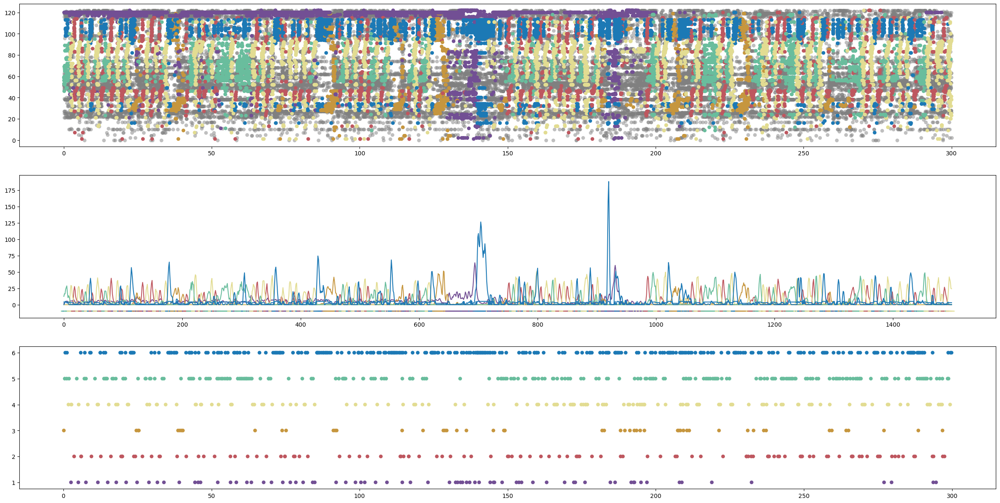

In [7]:
timeframe = [0,300]

#mask
# spikemask
mask = (unmasked_spikes_df.timestamp>timeframe[0])*(unmasked_spikes_df.timestamp<timeframe[-1])

fig, [ax1,ax2,ax3] = plt.subplots(3, 1,figsize=(30, 15))

1 ### plot ordered ppseq spikes as above:

# plot background in grey 
background_keep_mask = unmasked_spikes_df[mask].sequence_type_adjusted <= 0
ax1.scatter(unmasked_spikes_df[mask][background_keep_mask].timestamp, neuron_order[mask][background_keep_mask],marker = 'o', s=40, linewidth=0,color = 'grey' ,alpha=0.5)
# mask to remove background neurons from the color plot
background_remove_mask = unmasked_spikes_df[mask].sequence_type_adjusted >= 0
c_ = np.array(colors)[unmasked_spikes_df[mask][background_remove_mask].sequence_type_adjusted.values.astype(int)]
ax1.scatter(unmasked_spikes_df[mask][background_remove_mask].timestamp, neuron_order[mask][background_remove_mask],marker = 'o', s=40, linewidth=0,color = c_ ,alpha=1)


### bin the spiking and plot number of spikes for each seq type
seqs = np.unique(unmasked_spikes_df.sequence_type_adjusted)
seq_spikes = []
for seq_type_ in seqs:  
    seq_spikes += [unmasked_spikes_df.timestamp[np.where(unmasked_spikes_df.sequence_type_adjusted ==seq_type_)[0]].values]

# Define the bin size (in this case, 0.2s)
bin_size = 0.2

seq_spike_occurance = []
for spikes_ in seq_spikes:
    # Use the numpy.histogram function to bin the data
    hist, bins = np.histogram(spikes_, bins=np.arange(0, np.diff(behav_time_interval_start)[0], bin_size))
    seq_spike_occurance += [list(hist)]
    
strt_ = int(timeframe[0]/bin_size)
end_ = int(timeframe[1]/bin_size)

for i in range (1,len(seq_spike_occurance)):
#     ax2.plot(seq_spike_occurance[i][strt_:end_], c = colors[i])
    ax2.plot(convolve_movmean(seq_spike_occurance[i][strt_:end_],3), c = colors[i])
    

## plot the current seq type (based on binned spiking):
nth_vectors = conactinate_nth_items(seq_spike_occurance[1::])
max_index= []
max_index += [np.argmax(sublist) for sublist in nth_vectors] 

ax2.plot(max_index[strt_:end_])

ax2.scatter(np.linspace(0,end_ - strt_-1,end_ - strt_),np.ones(end_ - strt_)*-10, marker = '_',color = np.array(colors)[np.array(max_index)+1][strt_:end_], s = 100)

### plot the ppseq latent:

# mask for the timespan
latent_timespan_mask = (latent_event_history_df_split.timestamp>timeframe[0])*(latent_event_history_df_split.timestamp<timeframe[-1])

# ignore anything that is below threshold * max amplitude
thr_ = 0
thresh_value = max(latent_event_history_df_split.amplitude) * thr_


amplitude_mask = latent_event_history_df_split[latent_timespan_mask].amplitude > thresh_value

c_l = np.array(colors)[latent_event_history_df_split[latent_timespan_mask][amplitude_mask].seq_type.values.astype(int)]
ax3.scatter(latent_event_history_df_split[latent_timespan_mask][amplitude_mask].timestamp,latent_event_history_df_split[latent_timespan_mask][amplitude_mask].seq_type ,marker = 'o', s=40, linewidth=0,color = c_l ,alpha=1)


# SaveFig('seq_identities.png',save_path)

Text(0.5, 1.0, 'timeframe = [0, 300]')

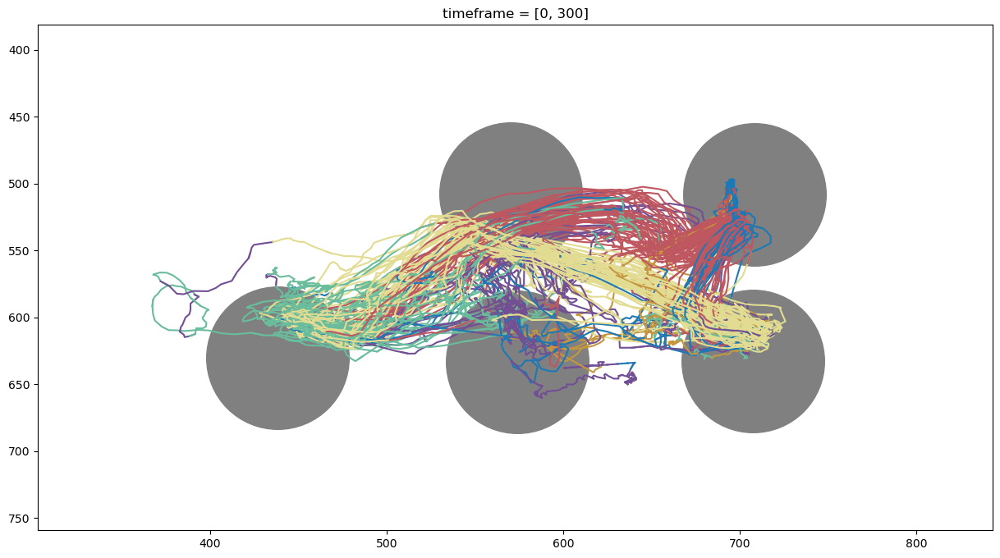

In [8]:
fps = 60
if mouse_session_recording == '148_2_2':
    fps = 40

# behav_mask
mask_ = (poke_in_times > timeframe[0]) * (poke_in_times < timeframe[1])

# tracking and ehys times are synced to poke in times so tracking position has to be aligned to first poke in time in this timeframe. 

# Find the difference between PokeIN_EphysTime and the start of the behavior interval
interval_pokeIn_spike_times = behav_sync.PokeIN_EphysTime[behav_mask][mask_].values - behav_time_interval_start[0]
# Find the offset between the first poke in time and the start of the timeframe
tracking_offset = interval_pokeIn_spike_times[0] - timeframe[0]

# Get the first synced time for the camera in the interval 
interval_cam_times =  behav_sync.backcam_aligned_pokein_times[behav_mask][mask_].values[0]
# Align the tracking start with the ephys by subtracting the offset
cam_start_time = interval_cam_times - tracking_offset

# Calculate the number of events based on the timeframe size and bin size
events = np.diff(timeframe)[0] /bin_size 
# Create a list for start times, with the first start time being the camera start time converted to timestamps - 60fps
start_ts = [cam_start_time * fps ]
# Convert the bin size to timestamps - 60fps
bin_ts = bin_size * fps

# Create an empty list for end times
end_ts = []
# Loop through the number of events
for i in range(int(events)):
    # If it is not the first event, set the start time as the end time of the previous event
    if i > 0:
        start_ts += [end_ts[i-1]]
    # Add the current start time plus the bin size to the list of end times
    end_ts += [start_ts[i] + bin_ts] 

    
    
nrow = 1 
ncol = 1
fig, axs = plt.subplots(nrow, ncol,figsize=(15, 8))

for ind, ax in enumerate(fig.axes):
    for item in [back_p1,back_p2,back_p3,back_p4,back_p5]:
        ax.plot(np.median(item['interped_x'].values),np.median(item['interped_y'].values),'o',color = 'grey', markersize = 125)
    for i in range(int(events)):
        ax.plot(back_head_centre['interped_x'].values[int(start_ts[i])-1:int(end_ts[i])+1],back_head_centre['interped_y'].values[int(start_ts[i])-1:int(end_ts[i])+1],'-',color = np.array(colors)[np.array(max_index)+1][strt_:end_][i], alpha = 1)

        
    min_x = np.median(back_p2['interped_x'].values) - (np.median(back_p1['interped_x'].values) - np.median(back_p2['interped_x'].values))
    max_x = np.median(back_p4['interped_x'].values) + (np.median(back_p1['interped_x'].values) - np.median(back_p2['interped_x'].values))
    min_y = np.median(back_p3['interped_y'].values) - (np.median(back_p1['interped_y'].values) - np.median(back_p3['interped_y'].values))
    max_y = np.median(back_p1['interped_y'].values) + (np.median(back_p1['interped_y'].values) - np.median(back_p3['interped_y'].values))
    ax.set_xlim(min_x,max_x)
    ax.set_ylim(min_y,max_y)

    ax.invert_yaxis()
    
ax.set_title('timeframe = ' + str(timeframe))
    

# generate synthetic data


In [174]:
# plot all neuron offsets for each seq - ordered by neuron permuteloc and alpha coloured by contribution to sequence? amplitude? something like this? 

In [204]:
# for each neuron in each sequence event, find percentage of sequences it appears in. This is usieng my own definittion of a sequence which is different to the latent. # this code wa sstarted for a different analsis and moved here as it might be useful 


def return_inds_for_seq_groups(lst):
    groups = []
    peak_inds = []
    new = True
    for ind,item in enumerate(lst):
        if new:
            if item > 0:
                start = ind
                new = False
                peak_ind = ind
        else:
            if item > lst[peak_ind]:
                peak_ind = ind
            if item == 0:
                end = ind
                if not start == 0:
                    groups.append((start-1, end))
                else:
                    groups.append((start, end))    
                peak_inds.append(peak_ind)
                new = True
    return groups,peak_inds
            
# setup structrue for later
output_df = pd.DataFrame(
    {'seq_type' : [],
    'midpoints' : [],
    'neuron_order' : [],
     'spike_profiles':[]})

        

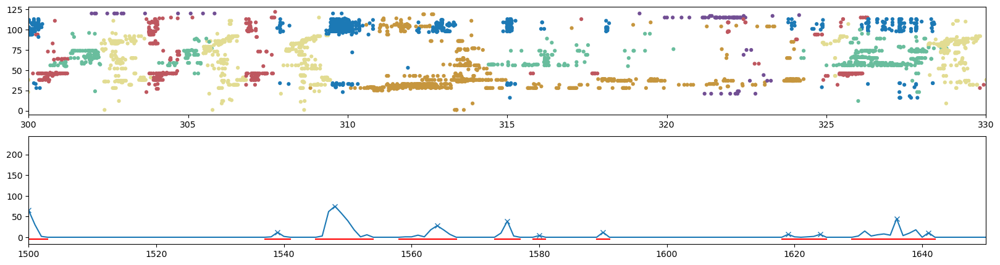

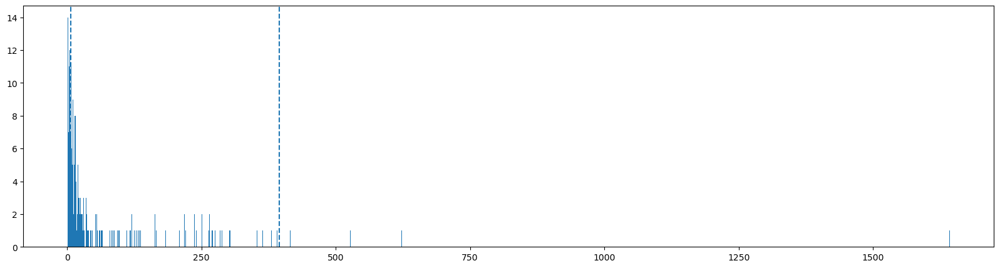

In [244]:
# iterate manually throug each seq
i = 6


seq_spike_count = seq_spike_occurance[i]
# find seq start and end, defined by whetehr there were spikes or not 
groups, peaks = return_inds_for_seq_groups(seq_spike_count)



### plot to check that I am accounting ofr sequences properly

#mask
# spikemask
timeframe = [0,800]
mask = (unmasked_spikes_df.timestamp>timeframe[0])*(unmasked_spikes_df.timestamp<timeframe[-1])
background_remove_mask = unmasked_spikes_df[mask].sequence_type_adjusted >= 0
c_ = np.array(colors)[unmasked_spikes_df[mask][background_remove_mask].sequence_type_adjusted.values.astype(int)]

fig,[ax1,ax2] = plt.subplots(2, 1,figsize=(20, 5))
ax1.scatter(unmasked_spikes_df[mask][background_remove_mask].timestamp, neuron_order[mask][background_remove_mask],marker = 'o', s=20, linewidth=0,color = c_ ,alpha=1)
ax2.plot(seq_spike_count, color = colors[i])
for item in groups:
    ax2.plot(item,[-5,-5], color = 'red')
    
ax1.set_xlim([300,330])
ax2.set_xlim([(300/bin_size),(330/bin_size)])

spikes_per_group = []
for group in groups:
    timeframe = [(group[0]*bin_size),(group[-1]*bin_size)]
    mask = (unmasked_spikes_df.timestamp>timeframe[0])*(unmasked_spikes_df.timestamp<timeframe[-1])
    spikes_present = list(unmasked_spikes_df[mask].sequence_type_adjusted.values.astype(int))
    spikes_per_group += [spikes_present.count(i)]
    
ax2.plot(peaks,np.array(seq_spike_count)[np.array(peaks)],'x')

fig,ax = plt.subplots(1, 1,figsize=(20, 5))
ax.hist(spikes_per_group, bins=range(min(spikes_per_group), max(spikes_per_group) + 1, 1))

# calculate the 25th and 75th percentiles


p25 = np.percentile(spikes_per_group, 30)
p75 = np.percentile(spikes_per_group, 98)

#----
# p25 = np.percentile(spikes_per_group, 40)
# p75 = np.percentile(spikes_per_group, 95)

# # p25 = np.percentile(spikes_per_group, 70)
# # p75 = np.percentile(spikes_per_group, 95)

# # p25 = np.percentile(spikes_per_group, 40)
# # p75 = np.percentile(spikes_per_group, 90)

# # p25 = np.percentile(spikes_per_group, 50)
# # p75 = np.percentile(spikes_per_group, 90)

# # p25 = np.percentile(spikes_per_group, 50)
# # p75 = np.percentile(spikes_per_group, 95)


ax.axvline(p25, linestyle="--")
ax.axvline(p75, linestyle="--")
    
# trim the list between the 25th and 75th percentiles and get the indices of the kept elements
indices = [i for i, num in enumerate(spikes_per_group) if num >= p25 and num <= p75]
trimmed_spg = [num for num in spikes_per_group if num >= p25 and num <= p75]

# filter for the chosen groups:
filtered_groups = np.array(groups)[np.array(indices)]
filtered_peaks =  np.array(peaks)[np.array(indices)]

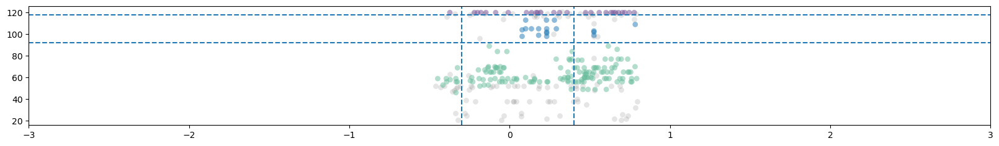

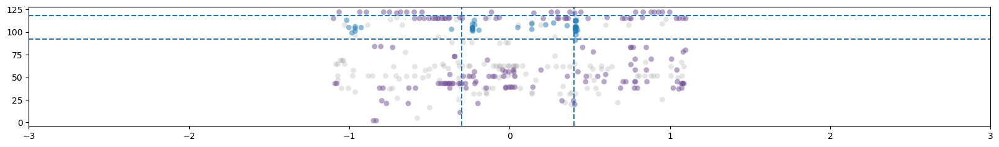

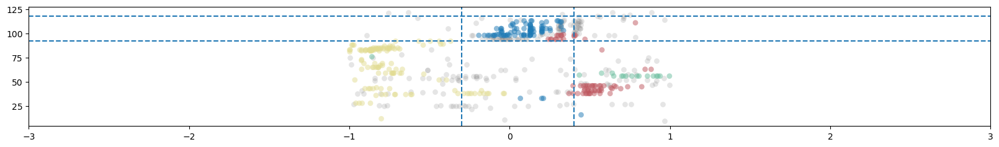

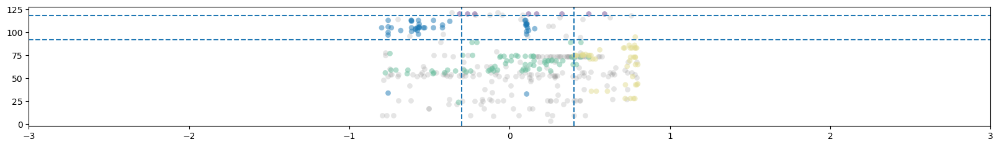

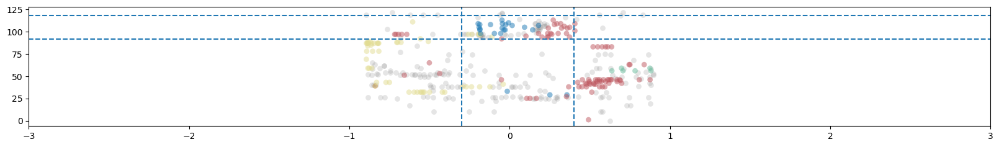

In [249]:
test_numbers = list(np.linspace(0,len(filtered_groups)-1,5).astype(int))


for test in test_numbers:

    fig,ax1 = plt.subplots(1, 1,figsize=(20, 2.5))


    # spikemask
    timeframe = [(filtered_groups[test][0] * bin_size)-0.5,(filtered_groups[test][-1] * bin_size)+0.5]
    mid_point_time = ((filtered_groups[test][0] + np.diff(filtered_groups[test])/2)[0] *bin_size)
    # use peaks instead - doesnt work as well 
#     mid_point_time = filtered_peaks[test] * bin_size
    
    # plot background in grey 
    mask = (unmasked_spikes_df.timestamp>timeframe[0])*(unmasked_spikes_df.timestamp<timeframe[-1])
    background_keep_mask = unmasked_spikes_df[mask].sequence_type_adjusted <= 0
    ax1.scatter(unmasked_spikes_df[mask][background_keep_mask].timestamp - mid_point_time, neuron_order[mask][background_keep_mask],marker = 'o', s=40, linewidth=0,color = 'grey' ,alpha=0.2)

    
    background_remove_mask = unmasked_spikes_df[mask].sequence_type_adjusted >= 0
    c_ = np.array(colors)[unmasked_spikes_df[mask][background_remove_mask].sequence_type_adjusted.values.astype(int)]
    ax1.scatter(unmasked_spikes_df[mask][background_remove_mask].timestamp- mid_point_time, neuron_order[mask][background_remove_mask],marker = 'o', s=40, linewidth=0,color = c_ ,alpha=0.5)

    ax1.set_xlim([-3,3])

    xlims = (-0.3,0.4)
    ylims = (92,118)

    
#=====
    
#     xlims = (-0.35,0.35)
#     ylims = (30,90)

#     xlims = (-0.55,0.35)
#     ylims = (90,125)

#     xlims = (-0.3,0.35)
#     ylims = (47,80)

#     xlims = (-0.5,0.4)
#     ylims = (25,100)

#     xlims = (-0.4,0.5)
#     ylims = (50,125)

    N_neurons= bkgd_log_proportions_array.shape[1]
    ax1.axvline(xlims[0], ymin=0, ymax=N_neurons, linestyle="--")
    ax1.axvline(xlims[1], ymin=0, ymax=N_neurons, linestyle="--")
    ax1.axhline(ylims[0], linestyle="--")
    ax1.axhline(ylims[1], linestyle="--")
    
#

#work out gaps in order to cut out squares
gap_to_mid1 = abs((filtered_groups[test][0]*bin_size) - mid_point_time)
remainder1 = gap_to_mid1 - abs(xlims[0])

gap_to_mid2 = abs((filtered_groups[test][1]*bin_size) - mid_point_time)
remainder2 = gap_to_mid2 - abs(xlims[1])


mid_point_times = []
for e in range(len(filtered_groups)):
    mid_point_times += [((filtered_groups[e][0] + np.diff(filtered_groups[e])/2)[0] *bin_size)]
    

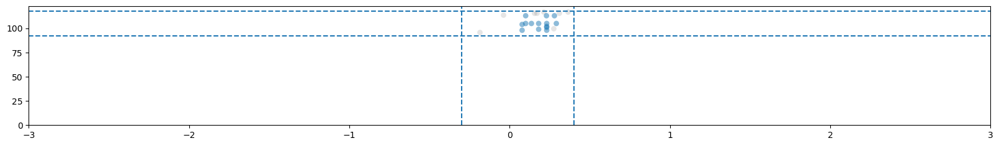

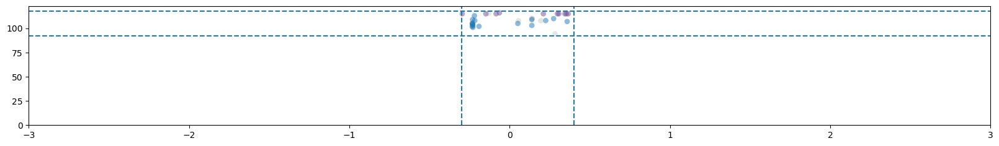

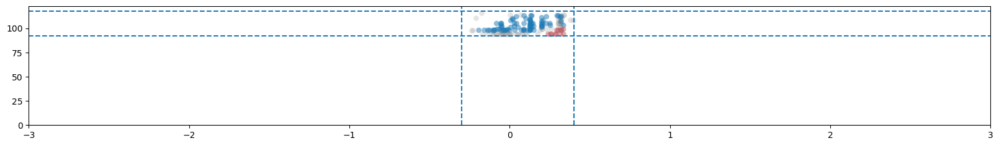

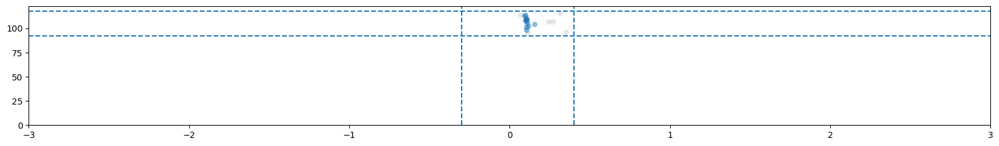

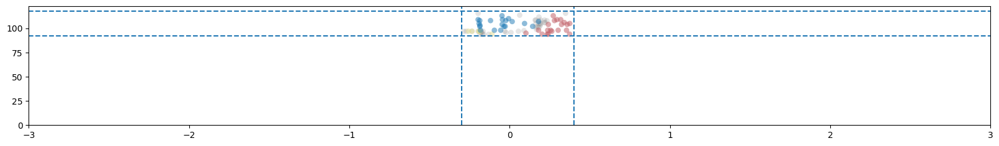

In [251]:
#### plot the cutting to check it is working - current not working.... 
group_spike_profiles= []
group_neuron_orders = []
spikes_to_background = []
spikes_to_other = []
tot_seq_spikes = []

for index in range(len(filtered_groups)):

    mid_point_time = mid_point_times[index]
    #work out gaps in order to cut out squares
    gap_to_mid1 = abs((filtered_groups[index][0]*bin_size) - mid_point_time)
    remainder1 = gap_to_mid1 - abs(xlims[0])

    gap_to_mid2 = abs((filtered_groups[index][1]*bin_size) - mid_point_time)
    remainder2 = gap_to_mid2 - abs(xlims[1])

    # spikemask
    timeframe = [(filtered_groups[index][0] * bin_size)+remainder1,(filtered_groups[index][-1] * bin_size)-remainder2]



    # mask for spike times and for neurons
    mask1 = (unmasked_spikes_df.timestamp>timeframe[0])*(unmasked_spikes_df.timestamp<timeframe[-1])

    spikes_to_keep = neuron_order[mask1]
    mask2 = (neuron_order[mask1] > ylims[0]) * (neuron_order[mask1] < ylims[1])


    background_keep_mask = unmasked_spikes_df[mask1][mask2].sequence_type_adjusted <= 0
    background_remove_mask = unmasked_spikes_df[mask1][mask2].sequence_type_adjusted >= 0
    if index in test_numbers:
        fig,ax1 = plt.subplots(1, 1,figsize=(20, 2.5))
        # plot background in grey 
        ax1.scatter(unmasked_spikes_df[mask1][mask2][background_keep_mask].timestamp - mid_point_time, neuron_order[mask1][mask2][background_keep_mask],marker = 'o', s=40, linewidth=0,color = 'grey' ,alpha=0.2)
        # plot seq spikes
        c_ = np.array(colors)[unmasked_spikes_df[mask1][mask2][background_remove_mask].sequence_type_adjusted.values.astype(int)]
        ax1.scatter(unmasked_spikes_df[mask1][mask2][background_remove_mask].timestamp- mid_point_time, neuron_order[mask1][mask2][background_remove_mask],marker = 'o', s=40, linewidth=0,color = c_ ,alpha=0.5)

        ax1.set_xlim([-3,3])
        ax1.set_ylim([0,N_neurons])
        N_neurons= bkgd_log_proportions_array.shape[1]
        ax1.axvline(xlims[0], ymin=0, ymax=N_neurons, linestyle="--")
        ax1.axvline(xlims[1], ymin=0, ymax=N_neurons, linestyle="--")
        ax1.axhline(ylims[0], linestyle="--")
        ax1.axhline(ylims[1], linestyle="--")
        
    
    ## save spike profile for each sleted group:
    group_spike_profiles.append(unmasked_spikes_df[mask1][mask2])
    group_neuron_orders.append(neuron_order[mask1][mask2])

    seq_types_present = list(unmasked_spikes_df[mask1][mask2][background_remove_mask].sequence_type_adjusted.values.astype(int))
    background_spikes = len(unmasked_spikes_df[mask1][mask2][background_keep_mask].timestamp)
    seq_spikes = seq_types_present.count(i)
    other_seqs = len(seq_types_present) - seq_types_present.count(i)

    spikes_to_background +=[seq_spikes/(seq_spikes + background_spikes) ]
    if seq_spikes + other_seqs ==  0:
        spikes_to_other += [0]
    else:
        spikes_to_other +=[seq_spikes / (seq_spikes + other_seqs)]
    tot_seq_spikes += [seq_spikes]




C:\Users\Emmett\AppData\Local\Temp\ipykernel_11448\2682067599.py:24: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  final_filtered_group_spike_profiles = np.array(group_spike_profiles)[filter_mask]
C:\Users\Emmett\AppData\Local\Temp\ipykernel_11448\2682067599.py:25: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  final_filtered_group_neuron_orders = np.array(group_neuron_orders)[filter_mask]


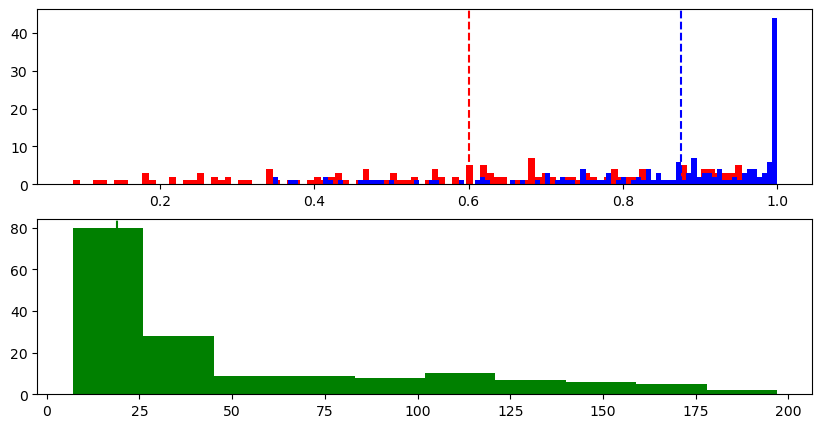

In [252]:
## filter out the bottom ten percente - seq with too muhc background and too much other sequences and not enough seq spikes overall 

# filter_thresh = 10
filter_thresh = 40

fig,[ax,ax1] = plt.subplots(2, 1,figsize=(10, 5))
ax.hist(spikes_to_background,100, color = 'red')
t1 = np.percentile(spikes_to_background, filter_thresh)
t2 = np.percentile(spikes_to_other, filter_thresh)
ax.axvline(t1, ymin=0, ymax=10, linestyle="--", color = 'red')
ax.axvline(t2, ymin=0, ymax=10, linestyle="--", color = 'blue')

ax.hist(spikes_to_other,100, color = 'blue')
ax1.hist(tot_seq_spikes, color = 'green')
t3 = np.percentile(tot_seq_spikes, filter_thresh)
ax1.axvline(t3, ymin=0, ymax=10, linestyle="--", color = 'green')

# t2 = np.array(0.1)

# filter for all 3:
filter_mask = (spikes_to_background > t1) * (spikes_to_other > t2) *(tot_seq_spikes>t3)

final_filtered_midpoints = np.array(mid_point_times)[filter_mask]
final_filtered_group_spike_profiles = np.array(group_spike_profiles)[filter_mask] 
final_filtered_group_neuron_orders = np.array(group_neuron_orders)[filter_mask] 

C:\Users\Emmett\AppData\Local\Temp\ipykernel_11448\3064304199.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,ax1 = plt.subplots(1, 1,figsize=(20, 2.5))


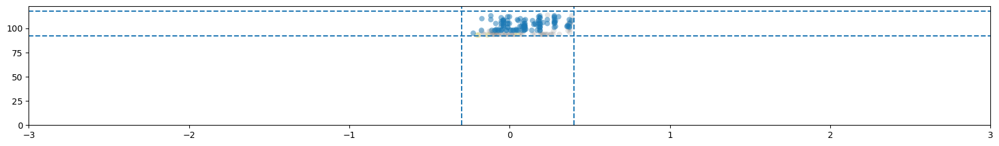

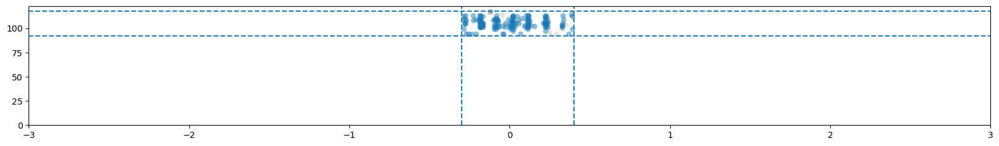

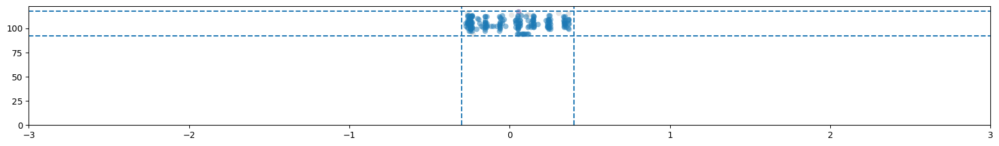

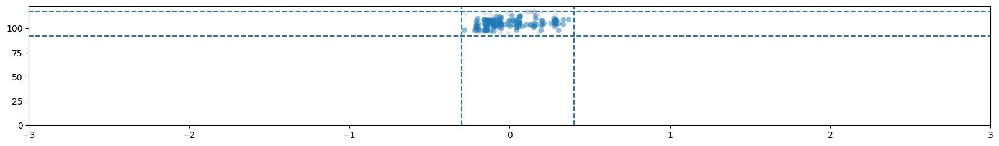

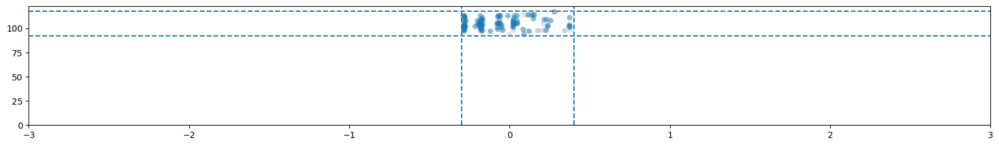

...

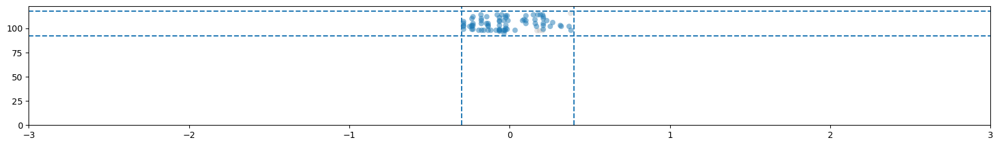

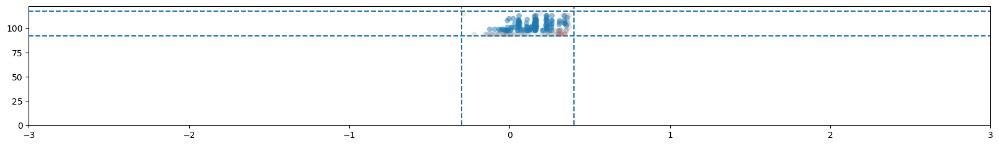

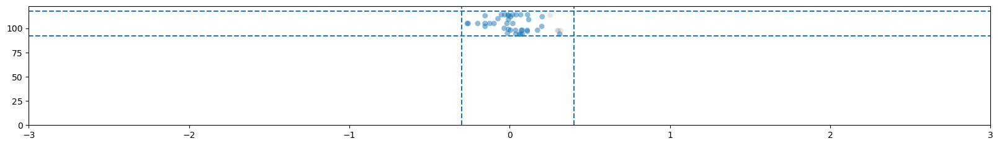

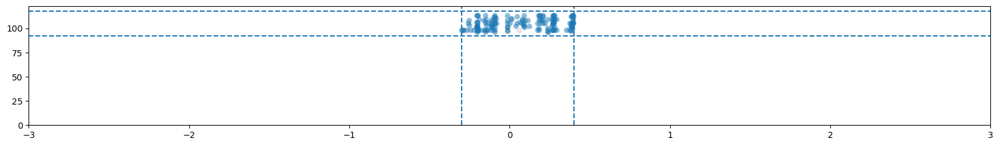

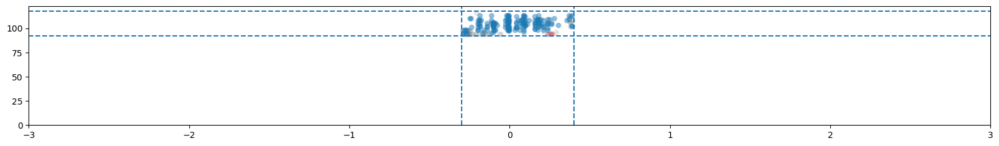

In [253]:
for index,test_data in enumerate(final_filtered_group_spike_profiles):
    fig,ax1 = plt.subplots(1, 1,figsize=(20, 2.5))
    
    mid_point_time = final_filtered_midpoints[index]
    
    background_keep_mask = test_data.sequence_type_adjusted <= 0
    background_remove_mask = test_data.sequence_type_adjusted >= 0
    # plot background in grey 
    ax1.scatter(test_data[background_keep_mask].timestamp - mid_point_time, final_filtered_group_neuron_orders[index][background_keep_mask],marker = 'o', s=40, linewidth=0,color = 'grey' ,alpha=0.2)
    # plot seq spikes
    c_ = np.array(colors)[test_data[background_remove_mask].sequence_type_adjusted.values.astype(int)]
    ax1.scatter(test_data[background_remove_mask].timestamp- mid_point_time, final_filtered_group_neuron_orders[index][background_remove_mask],marker = 'o', s=40, linewidth=0,color = c_ ,alpha=0.5)

    ax1.set_xlim([-3,3])
    ax1.set_ylim([0,N_neurons])
    N_neurons= bkgd_log_proportions_array.shape[1]
    ax1.axvline(xlims[0], ymin=0, ymax=N_neurons, linestyle="--")
    ax1.axvline(xlims[1], ymin=0, ymax=N_neurons, linestyle="--")
    ax1.axhline(ylims[0], linestyle="--")
    ax1.axhline(ylims[1], linestyle="--")

### if happy then store this out for that seq:


In [254]:
### if happy then save this out for that seq:

df = pd.DataFrame(
    {'seq_type' : [i]*len(final_filtered_midpoints),
    'midpoints' : final_filtered_midpoints,
    'neuron_order' : final_filtered_group_neuron_orders,
     'spike_profiles':final_filtered_group_spike_profiles})

output_df = output_df.append(df)

print('done')


done


C:\Users\Emmett\AppData\Local\Temp\ipykernel_11448\317238943.py:9: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  output_df = output_df.append(df)


In [255]:
output_df

,seq_type,midpoints,neuron_order,spike_profiles
0,2.0,16.3,"[53.0, 42.0, 42.0, 42.0, 42.0, 42.0, 94.0, 94....",neuron timestamp sequence_type seq_...
1,2.0,26.7,"[53.0, 53.0, 42.0, 94.0, 94.0, 94.0, 94.0, 94....",neuron timestamp sequence_type seq_...
2,2.0,29.8,"[29.0, 53.0, 94.0, 94.0, 94.0, 94.0, 94.0, 94....",neuron timestamp sequence_type seq_...
3,2.0,32.7,"[42.0, 42.0, 94.0, 94.0, 94.0, 94.0, 94.0, 94....",neuron timestamp sequence_type seq_...
4,2.0,65.5,"[64.0, 64.0, 64.0, 94.0, 94.0, 94.0, 94.0, 94....",neuron timestamp sequence_type seq_...
...,...,...,...,...
53,6.0,549.2,"[108.0, 108.0, 108.0, 108.0, 108.0, 108.0, 108...",neuron timestamp sequence_type seq_...
54,6.0,561.9,"[94.0, 94.0, 94.0, 94.0, 94.0, 94.0, 94.0, 94....",neuron timestamp sequence_type seq_...
55,6.0,568.7,"[94.0, 94.0, 94.0, 94.0, 94.0, 105.0, 105.0, 1...",neuron timestamp sequence_type seq_...
56,6.0,582.2,"[108.0, 108.0, 108.0, 108.0, 108.0, 108.0, 108...",neuron timestamp sequence_type seq_c...


## save out the data


In [256]:
# if less than 200 seqs to insert then duplicate some:
counter = 0
while len(output_df) < 200:
    counter += 1
    random_row = output_df.sample(n=1)
    output_df = output_df.append(random_row, ignore_index=True)
print('duplicating ' + str(counter) + ' seqs')

## save out the data 
output_df.reset_index(drop=True, inplace=True)

out_path = os.path.join("Z:\projects\sequence_squad\organised_data\ppseq_analysis\synthetic_data\\" + mouse_session_recording,region) + '\\'

if not os.path.isdir(out_path):
    os.makedirs(out_path)
output_df.to_pickle(out_path +  "all_extracted_spike_profiles")

duplicating 0 seqs


# load data 

In [58]:

out_path = os.path.join("Z:\projects\sequence_squad\organised_data\ppseq_analysis\synthetic_data\\" + mouse_session_recording,region) + '\\'
# reload origional  out_df 
out_df = pd.read_pickle(out_path + "all_extracted_spike_profiles")

neuron_permute_loc = np.zeros(len(neuron_index))
for i in range(len(neuron_index)):
    neuron_permute_loc[i] = int(list(neuron_index).index(i))



FileNotFoundError: [Errno 2] No such file or directory: 'Z:\\projects\\sequence_squad\\organised_data\\ppseq_analysis\\synthetic_data\\270_1_5\\striatum\\all_extracted_spike_profiles'

In [ ]:
####### plot the whole thing but with boxes drawn around explanted seqs

from matplotlib.patches import Rectangle

timeframe = [0,800]
mask = (unmasked_spikes_df.timestamp>timeframe[0])*(unmasked_spikes_df.timestamp<timeframe[-1])

fig,ax1 = plt.subplots(1, 1,figsize=(30, 5))
# plot background in grey 
background_keep_mask = unmasked_spikes_df[mask].sequence_type_adjusted <= 0
ax1.scatter(unmasked_spikes_df[mask][background_keep_mask].timestamp, neuron_order[mask][background_keep_mask],marker = 'o', s=40, linewidth=0,color = 'grey' ,alpha=0.5)
background_remove_mask = unmasked_spikes_df[mask].sequence_type_adjusted >= 0
c_ = np.array(colors)[unmasked_spikes_df[mask][background_remove_mask].sequence_type_adjusted.values.astype(int)]
ax1.scatter(unmasked_spikes_df[mask][background_remove_mask].timestamp, neuron_order[mask][background_remove_mask],marker = 'o', s=20, linewidth=0,color = c_ ,alpha=1)

    
ax1.set_xlim([160,200])

for index,profile in enumerate(out_df.spike_profiles):
    
    col_ = colors[int(out_df.seq_type.values[index])]
                    
    # Create a Rectangle patch
    top = max(out_df.neuron_order.values[index])
    bottom = min(out_df.neuron_order.values[index])
    left = min(profile.timestamp)
    right = max(profile.timestamp)

    rect = Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none')

    # Add the patch to the Axes
    ax1.add_patch(rect)



    


In [ ]:
# ####### plot the whole thing but with boxes drawn around explanted seqs

# from matplotlib.patches import Rectangle

# timeframe = [0,800]
# mask = (unmasked_spikes_df.timestamp>timeframe[0])*(unmasked_spikes_df.timestamp<timeframe[-1])

# fig,ax1 = plt.subplots(1, 1,figsize=(30, 5))
# # plot background in grey 
# background_keep_mask = unmasked_spikes_df[mask].sequence_type_adjusted <= 0
# ax1.scatter(unmasked_spikes_df[mask][background_keep_mask].timestamp, neuron_order[mask][background_keep_mask],marker = 'o', s=40, linewidth=0,color = 'grey' ,alpha=0.5)
# background_remove_mask = unmasked_spikes_df[mask].sequence_type_adjusted >= 0
# c_ = np.array(colors)[unmasked_spikes_df[mask][background_remove_mask].sequence_type_adjusted.values.astype(int)]
# ax1.scatter(unmasked_spikes_df[mask][background_remove_mask].timestamp, neuron_order[mask][background_remove_mask],marker = 'o', s=20, linewidth=0,color = c_ ,alpha=1)

    
# ax1.set_xlim([25,60])

# for index,profile in enumerate(out_df.spike_profiles):
    
#     col_ = colors[int(out_df.seq_type.values[index])]
                    
#     # Create a Rectangle patch
#     top = max(out_df.neuron_order.values[index])
#     bottom = min(out_df.neuron_order.values[index])
#     left = min(profile.timestamp)
#     right = max(profile.timestamp)

#     rect = Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none')

#     # Add the patch to the Axes
#     ax1.add_patch(rect)

# SaveFig('/example_implants.png',r"Z:\projects\Emmett\Documents\writeup\fig4_PPseq\\")

In [59]:

####### then create synthetic data and implant! 

In [60]:
# permuted_neurons = []
# for index,spike in enumerate(unmasked_spikes_df.neuron.values):
#     choices = unmasked_spikes_df.neuron.unique()[spike::]
#     choice = random.choice(choices)
#     permuted_neurons += [choice]

OSError: Cannot save file into a non-existent directory: 'Z:\projects\sequence_squad\organised_data\ppseq_analysis\synthetic_data\270_1_5\striatum'

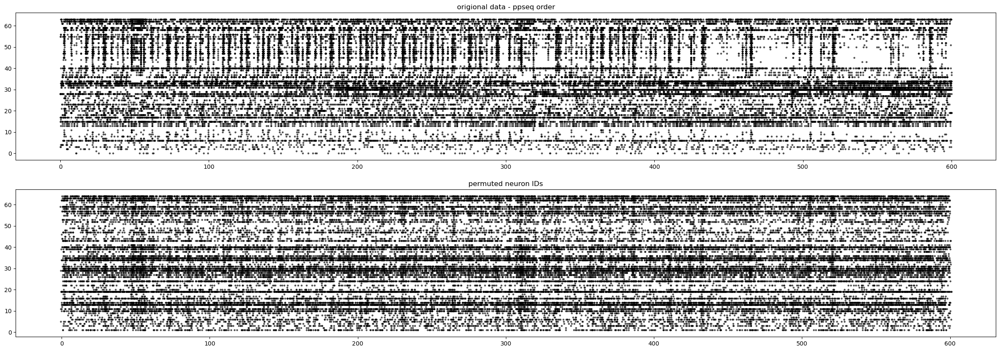

In [61]:
import random
N_neurons= max(unmasked_spikes_df.neuron)

fig,[ax1,ax2]= plt.subplots(2, 1,figsize=(30, 10))
ax1.set_title('origional data - ppseq order')
ax1.scatter(unmasked_spikes_df.timestamp, neuron_order,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)

# jitter up to 2s 
ts = unmasked_spikes_df.timestamp.values.copy()

# Loop through the time series and add/subtract a random value within the specified range
for i in range(len(ts)):
    random_value = random.uniform(0, 1)
    sign = random.choice([-1, 1]) # randomly choose whether to add or subtract
    ts[i] += sign * random_value
    
permuted_spikes = ts

# permuted_spikes = unmasked_spikes_df.timestamp.values


neurons_to_permute = unmasked_spikes_df.neuron.values.copy()
# randomly assign spikes to new neurons
permuted_neurons= np.random.permutation(neurons_to_permute)
permuted_neuron_order = permuted_neurons

ax2.set_title('permuted neuron IDs')
ax2.scatter(permuted_spikes, permuted_neurons,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)


permuted_df = pd.DataFrame(
    {'permuted_spikes' : permuted_spikes,
    'permuted_neurons' : permuted_neurons})
permuted_df.to_pickle(out_path +  "permuted_spikes_df")

# blank test

In [13]:
def save_params_as_json(args, save_path, file_name):
    config_filename = os.path.join(save_path, file_name)
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    with open(config_filename, 'w') as config_file:
        json.dump(args, config_file, indent=4)
    return(config_filename)

def create_spike_time_vectors(spike_times,clusters):
    spiketimevectors = []
    for i in np.unique(clusters):
        spiketimevectors = spiketimevectors + [spike_times[np.where(clusters==i)[0]]]
    return spiketimevectors

def write_text_file(spikes, filename="spike_data.txt"):
    f = open(filename, "w")
    for i, spike_train in enumerate(spikes):
        for t, spike_time in enumerate(spike_train):
            mssg = "{:.1f}\t{:10.4f}\n".format(i + 1, spike_time)
            f.write(mssg)
    f.close()
    return filename


type_ = 'blank_test'

model_dir = r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\"
CHECK_FOLDER = os.path.isdir(model_dir)

# If folder doesn't exist, then create it.
if not CHECK_FOLDER:
    os.makedirs(model_dir)
    print("created folder : ", model_dir)

json_ = {'full_path_to_data': dat_path,
 'mouse_implant_recording': mouse_session_recording,
 'output_filename': mouse_session_recording +'_'+ type_ ,
 'save_path': model_dir,
 'time_span': [behav_time_interval_start],
 'single_or_multiunits': 'both',
 'region': 'striatum',
 'use_emmett_curation': False,
 'max_firing_rate': 15.0,
 'align_to_zero': True,
 'shuffle': 'None',
 'visualise': True,
 'min_fano_factor': 0.5,
 'max_fano_factor': 12,
 'number_of_neurons':N_neurons }

params_filename= save_params_as_json(json_, json_["save_path"], "params_"+json_["output_filename"]+".json")

spike_times = create_spike_time_vectors(np.array(permuted_spikes),np.array(permuted_neurons))

data_filename = write_text_file(spikes=spike_times, filename= json_["save_path"] + json_["output_filename"]+".txt") 

print(f"    • data '.txt' file saved to:          {data_filename}")
print(f"    • parameters '.json' file saved to:   {params_filename}")


    • data '.txt' file saved to:          Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\178_2_2_blank_test.txt
    • parameters '.json' file saved to:   Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\params_178_2_2_blank_test.json


# standard insertion 

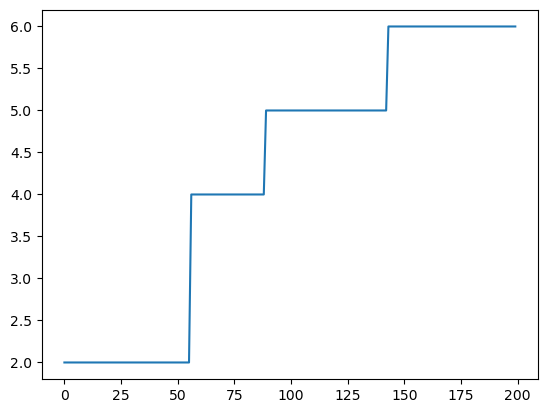

In [14]:
### choose randlonly and ans evenly as possible which seqs to implant: 

seq_list = list(out_df.seq_type)
indices = np.array([i for i in range(len(np.array(seq_list)))])

    
indices_all = []
for item in np.unique(seq_list):
    indices_all += [indices[np.array(seq_list) == item]]
    
chosen_inds = []
while len(chosen_inds) < 200:
    for i in range(len(indices_all)):
        if len(indices_all[i]) > 0:
            if len(chosen_inds) < 200:
                random_idx = np.random.choice(len(indices_all[i]))
                removed_value = indices_all[i][random_idx]
                indices_all[i] = np.delete(indices_all[i], random_idx)

                chosen_inds += [removed_value]
                
chosen_inds = np.sort(chosen_inds)


plt.plot(np.sort(out_df.seq_type.values[np.array(chosen_inds)]))

# filename = 'chosen_inds'
# with open(out_path + filename, 'wb') as fp:
#     pickle.dump(chosen_inds, fp)


In [15]:
### distribute sequences across timeframe so they are nice and seperated... 

max_time = round(max(permuted_spikes))

# Set the number of time points you want
num_points = len(chosen_inds)

# Generate a set of evenly spaced time points
time_points = np.linspace(10, max_time-10, num_points)

# Add some random variation to the spacing
time_points += np.random.normal(scale=0.3, size=num_points)

# Sort the time points in ascending order
time_points = np.sort(time_points)

print(min(np.diff(time_points)))
print("min diff should be at least 2s, if not try again")

#shuffle them
random.shuffle(time_points)
print(time_points)


1.667269313102679
min diff should be at least 2s, if not try again
[ 85.74107791 301.07459883 208.30872948 474.15854465 254.92640999
 141.56658793 135.83876243 495.00603968 438.8793896   35.72746946
 523.78430981 325.6868626  404.15087724 401.29871969 485.85399327
 290.47091652 293.74227544 518.37329461 150.29963993 360.81592456
 126.98863646 500.1678233  336.80758909 112.41582226 471.4382403
 287.36107082 278.7215747  316.59263446 509.50308855 346.09626144
 348.26088868 480.05125581 179.57337274  27.51792009 416.02045842
 156.57798118 162.08316199 164.93114331 375.02358497 354.31196397
 296.25153704 194.06048763  22.03897503 459.6405193   12.28795825
 561.9210233  465.28287852 529.77559867 498.19572341 512.43901149
 243.97174533 590.65044242 363.59187165 257.53716919  15.85694196
 147.32973488 138.90324065 281.35184116 407.34689019 351.87863742
 158.71352096 328.1888439  322.18379729 117.9883674  222.67708638
 576.54116083 272.86301836 249.15231443 506.53043719 246.69634205
  76.66682

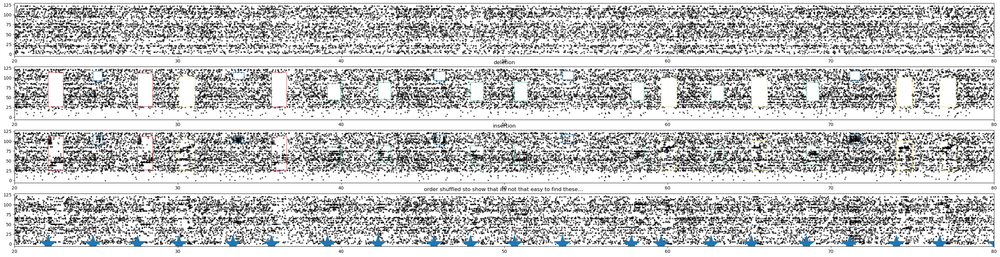

In [16]:
# reload origional  out_df 
out_df = pd.read_pickle(out_path + "all_extracted_spike_profiles")



# shift chosen inds to new distributed places
for i,index in enumerate(chosen_inds):
    profile = out_df.spike_profiles[index]   
    relative_spike_times = out_df.spike_profiles[index].timestamp.values - min(out_df.spike_profiles[index].timestamp.values)
    out_df.spike_profiles[index]['timestamp'] = relative_spike_times + time_points[i]

## delete patches first 
permuted_spikes_df = pd.read_pickle(out_path + "permuted_spikes_df")
permuted_neurons = (permuted_spikes_df.permuted_neurons.values)
permuted_spikes = permuted_spikes_df.permuted_spikes.values

updated_neurons = permuted_neurons
updated_spikes = permuted_spikes
updated_neuron_order = neuron_permute_loc[permuted_neurons.astype(int)-1]

rects = []
rects2 = []

for index in chosen_inds:

    profile = out_df.spike_profiles[index]    
    # Create a Rectangle patch
    top = max(out_df.neuron_order[index])
    bottom = min(out_df.neuron_order[index])
    left = min(profile.timestamp)
    right = max(profile.timestamp)

    timemask = (updated_spikes>left)*(updated_spikes<right)
    neuron_mask = (updated_neuron_order>bottom)*(updated_neuron_order<top)
    mask = np.invert(timemask * neuron_mask)

    updated_neurons = updated_neurons[mask]
    updated_spikes = updated_spikes[mask]
    updated_neuron_order = updated_neuron_order[mask]
    
    col_ = colors[int(out_df.seq_type[index])]
    rects +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
    rects2 +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]

## then implant seqs
spike_insertion = list(updated_spikes)
neuron_insertion = list(updated_neurons)
#save out for future plotting
seq_types = []
insertion_ids = []
profiles = []
for index in chosen_inds:
    profile = out_df.spike_profiles[index]   
    spike_insertion +=  list(profile.timestamp)
    neuron_insertion += list(profile.neuron)
    
    seq_types +=  [out_df.seq_type[index]]
    insertion_ids += [index]
    profiles += [profile]
    

insertion_df = pd.DataFrame(
{'seq_type' : seq_types,
'insertion_id' : insertion_ids,
'inserted_profile': profiles})

    


fig,[ax1,ax2,ax3,ax4]= plt.subplots(4, 1,figsize=(40, 10))
# plot origonal
ax1.scatter(permuted_spikes, permuted_neuron_order,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)
# plot deleted
ax2.set_title('deletion')


permuted_neuron_order_new = neuron_permute_loc[updated_neurons.astype(int)-1]

ax2.scatter(updated_spikes, permuted_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)

# Add the patch to the Axes
for rect in rects:
    ax2.add_patch(rect)

# # plot insertion
ax3.set_title('insertion')

inserted_neuron_order = neuron_permute_loc[np.array(neuron_insertion).astype(int)-1]

ax3.scatter(spike_insertion, inserted_neuron_order,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)
for rect in rects2:
    ax3.add_patch(rect)
    
ax4.set_title('order shuffled sto show that its not that easy to find these... ')

shuffled_order_permute_loc = np.random.permutation(neuron_permute_loc)
shuffle_permuted_neuron_order_new = shuffled_order_permute_loc[np.array(neuron_insertion).astype(int)-1]
ax4.scatter(spike_insertion, shuffle_permuted_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)


ax1.set_xlim([20,80])
ax2.set_xlim([20,80])
ax3.set_xlim([20,80])
ax4.set_xlim([20,80])


ax4.plot(time_points,np.zeros(len(time_points)), '*',markersize = 40)

In [17]:
## save out instertion data 
from datetime import date

today = date.today()


if not os.path.isdir(out_path):
    os.makedirs(out_path)
insertion_df.to_pickle(out_path +  "standard_insertion_spike_profiles_" + str(today))



## save this data out in correct format
import json
import os, pickle




def create_spike_time_vectors(spike_times,clusters):
    spiketimevectors = []
    for i in np.unique(clusters):
        spiketimevectors = spiketimevectors + [spike_times[np.where(clusters==i)[0]]]
    return spiketimevectors

def save_params_as_json(args, save_path, file_name):
    config_filename = os.path.join(save_path, file_name)
    if not os.path.exists(save_path):
        os.makedirs(save_path)
    with open(config_filename, 'w') as config_file:
        json.dump(args, config_file, indent=4)
    return(config_filename)

def write_text_file(spikes, filename="spike_data.txt"):
    f = open(filename, "w")
    for i, spike_train in enumerate(spikes):
        for t, spike_time in enumerate(spike_train):
            mssg = "{:.1f}\t{:10.4f}\n".format(i + 1, spike_time)
            f.write(mssg)
    f.close()
    return filename


type_ = 'standard_insertion'

model_dir = r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\" 
CHECK_FOLDER = os.path.isdir(model_dir)

# If folder doesn't exist, then create it.
if not CHECK_FOLDER:
    os.makedirs(model_dir)
    print("created folder : ", model_dir)

json_ = {'full_path_to_data': dat_path,
 'mouse_implant_recording': mouse_session_recording,
 'output_filename': mouse_session_recording + '_' +type_ ,
 'save_path': model_dir,
 'time_span': [behav_time_interval_start],
 'single_or_multiunits': 'both',
 'region': 'striatum',
 'use_emmett_curation': False,
 'max_firing_rate': 15.0,
 'align_to_zero': True,
 'shuffle': 'None',
 'visualise': True,
 'min_fano_factor': 0.5,
 'max_fano_factor': 12,
 'number_of_neurons':N_neurons }

params_filename= save_params_as_json(json_, json_["save_path"], "params_"+json_["output_filename"]+".json")

spike_times = create_spike_time_vectors(np.array(spike_insertion),np.array(neuron_insertion))

data_filename = write_text_file(spikes=spike_times, filename= json_["save_path"] + json_["output_filename"]+".txt") 

print(f"    • data '.txt' file saved to:          {data_filename}")
print(f"    • parameters '.json' file saved to:   {params_filename}")


    • data '.txt' file saved to:          Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\178_2_2_standard_insertion.txt
    • parameters '.json' file saved to:   Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\params_178_2_2_standard_insertion.json


# load things back in to test if it is working okay 

Z:\projects\sequence_squad\organised_data\ppseq_analysis\synthetic_data\178_2_2\striatum\standard_insertion_spike_profiles_2023-11-28


(20.0, 70.0)

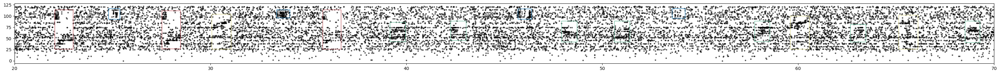

In [18]:
## load data back in to check it!

spikes_file= json_["save_path"] + json_["output_filename"]+".txt"

neuron_ids, spike_times= [], []
with open(spikes_file) as f:
    for (i, line) in enumerate(f.readlines()):
        [neuron_id, spike_time] = line.split(' ', 1)
        spike_time = eval(spike_time.split('\n')[0])
        neuron_id = eval(neuron_id.split('\t')[0])
        spike_times.append(spike_time)
        neuron_ids.append(neuron_id)
        
spikes_df = pd.DataFrame({'neuron':neuron_ids,'timestamp':spike_times}) 
        

print(out_path +  "standard_insertion_spike_profiles_" + str(today))
implanted_data = pd.read_pickle(out_path +  "standard_insertion_spike_profiles_" + str(today))

# for loading color and order data from awake alignment 
region = 'striatum'
saved_data_path = os.path.join("Z:\projects\sequence_squad\organised_data\ppseq_analysis\ppseq_awake_analysis\plots\\" + mouse_session_recording, region) + '\\'

with open(os.path.join(os.path.join(PP_PATH,file) + r"\analysis_output\reordered_recolored\neuron_index"), "rb") as input_file:
    new_neuron_index = pickle.load(input_file)
    

    
# # for 8 seqs:



new_neuron_permute_loc = np.zeros(len(new_neuron_index))
for i in range(len(neuron_index)):
    new_neuron_permute_loc[i] = int(list(neuron_index).index(i))


fig,ax= plt.subplots(1, 1,figsize=(40, 2.5))


neuron_order_test = new_neuron_permute_loc[spikes_df.neuron.values.astype(int)-1]
ax.scatter(spikes_df.timestamp.values, neuron_order_test ,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)


col_ = []
rects = []
implanted_seq_types = []
all_implanted_rectangles = []
for index, seq_type in enumerate(implanted_data.seq_type.values):
    timestamps = implanted_data.inserted_profile[index].timestamp.values
    neurons = implanted_data.inserted_profile[index].neuron.values

    left = min(timestamps)
    right = max(timestamps)
    
    implanted_neuron_order = neuron_permute_loc[(neurons-1).astype(int)]
    top = max(implanted_neuron_order)
    bottom = min(implanted_neuron_order)
    
    col_ = colors[int(seq_type)]
    rects +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
    
for rect in rects:
    ax.add_patch(rect)


ax.set_xlim([20,70])

#  flip spikes to create backwards data

(60.0, 100.0)

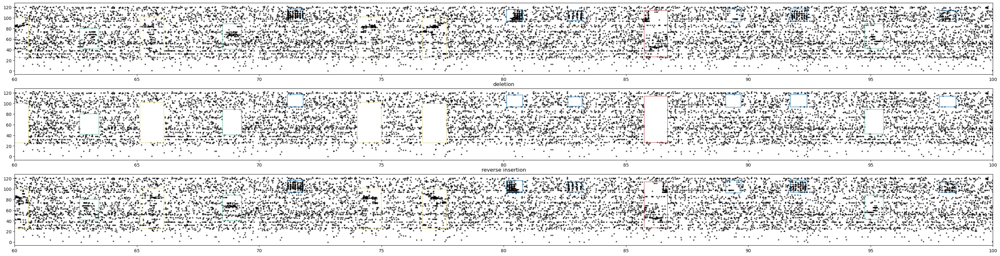

In [19]:
# reload origional  out_df 
out_df = pd.read_pickle(out_path + "all_extracted_spike_profiles")

# shift chosen inds to new distributed places
for i,index in enumerate(chosen_inds):
    profile = out_df.spike_profiles[index]   
    relative_spike_times = out_df.spike_profiles[index].timestamp.values - min(out_df.spike_profiles[index].timestamp.values)
    out_df.spike_profiles[index]['timestamp'] = relative_spike_times + time_points[i]


from matplotlib.patches import Rectangle

def reverse_ts(ts):
    new_ts = ts.copy()
    positive_delta = (new_ts - max(new_ts)) * -1
    reverse_ts = positive_delta + min(new_ts)
    if len(reverse_ts) > len(ts):
        print('F U')
    return(reverse_ts)

rects = []
rects2 = []
rects3 = []
for index in chosen_inds:
    
    profile = out_df.spike_profiles[index]    
    # Create a Rectangle patch
    top = max(out_df.neuron_order[index])
    bottom = min(out_df.neuron_order[index])
    left = min(profile.timestamp)
    right = max(profile.timestamp)
    
    col_ = colors[int(out_df.seq_type[index])]
    rects +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
    rects2 +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
    rects3 +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
    
fig,[ax1,ax2,ax3]= plt.subplots(3, 1,figsize=(40, 10))

# plot origonal
ax1.scatter(spike_insertion, inserted_neuron_order,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)
for rect in rects:
    ax1.add_patch(rect)

# plot deleted
ax2.set_title('deletion')

delted_permuted_neuron_order_new = neuron_permute_loc[updated_neurons.astype(int)-1]

ax2.scatter(updated_spikes, delted_permuted_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)

# Add the patch to the Axes
for rect in rects2:
    ax2.add_patch(rect)
    
## then implant seqs
reverse_spike_insertion = list(updated_spikes)
reverse_neuron_insertion = list(updated_neurons)
    
#save out for future plotting
seq_types = []
insertion_ids = []
profiles = []

for index in chosen_inds:
    profile = out_df.spike_profiles[index].copy() 
    reverse_time_series = reverse_ts(profile.timestamp.values)
    reverse_spike_insertion +=  list(reverse_time_series)
    reverse_neuron_insertion += list(profile.neuron)
    
    seq_types +=  [out_df.seq_type[index]]
    insertion_ids += [index]
    # reverse timestamps in saved out data
    profile['timestamp'] = reverse_time_series
    profiles += [profile]
    
backwards_insertion_df = pd.DataFrame(
{'seq_type' : seq_types,
'insertion_id' : insertion_ids,
'inserted_profile': profiles})
    

# # plot insertion
ax3.set_title('reverse insertion')

reverse_permuted_neuron_order_new = neuron_permute_loc[np.array(reverse_neuron_insertion).astype(int)-1]

ax3.scatter(reverse_spike_insertion, reverse_permuted_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)
for rect in rects3:
    ax3.add_patch(rect)



ax1.set_xlim([60,100])
ax2.set_xlim([60,100])
ax3.set_xlim([60,100])




In [20]:
## save out instertion data 

if not os.path.isdir(out_path):
    os.makedirs(out_path)
backwards_insertion_df.to_pickle(out_path +  "backwards_insertion_spike_profiles_" + str(today))


type_ = 'backwards_insertion'

model_dir = r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\" 
CHECK_FOLDER = os.path.isdir(model_dir)

# If folder doesn't exist, then create it.
if not CHECK_FOLDER:
    os.makedirs(model_dir)
    print("created folder : ", model_dir)

json_ = {'full_path_to_data': dat_path,
 'mouse_implant_recording': mouse_session_recording,
 'output_filename': mouse_session_recording + '_' + type_,
 'save_path': model_dir,
 'time_span': [behav_time_interval_start],
 'single_or_multiunits': 'both',
 'region': 'striatum',
 'use_emmett_curation': False,
 'max_firing_rate': 15.0,
 'align_to_zero': True,
 'shuffle': 'None',
 'visualise': True,
 'min_fano_factor': 0.5,
 'max_fano_factor': 12,
 'number_of_neurons':N_neurons }

params_filename= save_params_as_json(json_, json_["save_path"], "params_"+json_["output_filename"]+".json")

spike_times = create_spike_time_vectors(np.array(reverse_spike_insertion),np.array(reverse_neuron_insertion))

data_filename = write_text_file(spikes=spike_times, filename= json_["save_path"] + json_["output_filename"]+".txt") 

print(f"    • data '.txt' file saved to:          {data_filename}")
print(f"    • parameters '.json' file saved to:   {params_filename}")

    • data '.txt' file saved to:          Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\178_2_2_backwards_insertion.txt
    • parameters '.json' file saved to:   Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\params_178_2_2_backwards_insertion.json


# load data back in to check it!

Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\178_2_2_backwards_insertion.txt
Z:\projects\sequence_squad\organised_data\ppseq_analysis\synthetic_data\178_2_2\striatum\backwards_insertion_spike_profiles_2023-11-28


(60.0, 100.0)

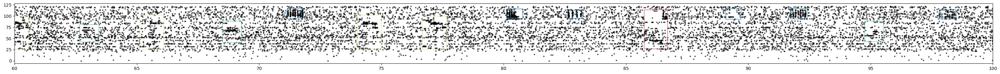

In [21]:
## load data back in to check it!

spikes_file= json_["save_path"] + json_["output_filename"]+".txt"
print(spikes_file)
neuron_ids, spike_times= [], []
with open(spikes_file) as f:
    for (i, line) in enumerate(f.readlines()):
        [neuron_id, spike_time] = line.split(' ', 1)
        spike_time = eval(spike_time.split('\n')[0])
        neuron_id = eval(neuron_id.split('\t')[0])
        spike_times.append(spike_time)
        neuron_ids.append(neuron_id)
        
spikes_df = pd.DataFrame({'neuron':neuron_ids,'timestamp':spike_times}) 
        

print(out_path +  "backwards_insertion_spike_profiles_" + str(today))
implanted_data = pd.read_pickle(out_path +  "backwards_insertion_spike_profiles_" + str(today))

# for loading color and order data from awake alignment 
region = 'striatum'
saved_data_path = os.path.join("Z:\projects\sequence_squad\organised_data\ppseq_analysis\ppseq_awake_analysis\plots\\" + mouse_session_recording, region) + '\\'

with open(os.path.join(os.path.join(PP_PATH,file) + r"\analysis_output\reordered_recolored\neuron_index"), "rb") as input_file:
    new_neuron_index = pickle.load(input_file)

    
# # for 8 seqs:



new_neuron_permute_loc = np.zeros(len(new_neuron_index))
for i in range(len(neuron_index)):
    new_neuron_permute_loc[i] = int(list(neuron_index).index(i))


fig,ax= plt.subplots(1, 1,figsize=(40, 2.5))


neuron_order_test = new_neuron_permute_loc[spikes_df.neuron.values.astype(int)-1]
ax.scatter(spikes_df.timestamp.values, neuron_order_test ,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)


col_ = []
rects = []
implanted_seq_types = []
all_implanted_rectangles = []
for index, seq_type in enumerate(implanted_data.seq_type.values):
    timestamps = implanted_data.inserted_profile[index].timestamp.values
    neurons = implanted_data.inserted_profile[index].neuron.values

    left = min(timestamps)
    right = max(timestamps)
    
    implanted_neuron_order = neuron_permute_loc[(neurons-1).astype(int)]
    top = max(implanted_neuron_order)
    bottom = min(implanted_neuron_order)
    
    col_ = colors[int(seq_type)]
    rects +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
    
for rect in rects:
    ax.add_patch(rect)


ax.set_xlim([60,100])

# warp data 

2.9195979899496933
min diff should be at least 2s, if not try again
[275.68341709 272.7638191  363.27135678 182.25628141 421.66331658
 167.65829146 430.42211055 576.40201005 115.10552764 342.83417085
 290.28140704 465.45728643 202.69346734 226.05025126  59.63316583
 424.58291457 299.04020101 126.7839196  185.1758794  541.36683417
 386.6281407  503.4120603   97.5879397  366.19095477 164.73869347
 313.63819095 526.76884422 447.93969849 497.57286432 322.39698492
 261.08542714 547.20603015  62.55276382 369.11055276 307.79899497
  24.59798995  82.98994975  21.67839196 389.54773869 339.91457286
 266.92462312 456.69849246 147.22110553 418.74371859 401.22613065
 433.34170854 515.09045226 161.81909548 564.72361809 588.08040201
 138.46231156  30.43718593 103.42713568 220.21105528 293.20100503
 231.88944724 520.92964824 179.33668342 150.14070352  56.71356784
 296.12060302 491.73366834 269.84422111 328.2361809   27.51758794
 281.52261307 383.70854271  94.66834171 453.77889447 100.50753769
 555.964

    • data '.txt' file saved to:          Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\178_2_2_warp_insertion0.2.txt
    • parameters '.json' file saved to:   Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\params_178_2_2_warp_insertion0.2.json
2.9195979899496933
min diff should be at least 2s, if not try again
[214.3718593  462.53768844 386.6281407  430.42211055 555.96482412
 258.16582915 170.57788945 573.48241206  50.87437186 278.60301508
 418.74371859 202.69346734 287.36180905 331.15577889 512.17085427
 459.61809045 348.67336683 453.77889447 433.34170854 249.40703518
 482.97487437 339.91457286 299.04020101 103.42713568 313.63819095
 436.26130653 150.14070352 377.86934673 112.18592965 293.20100503
 372.03015075 500.49246231  21.67839196 520.92964824 424.58291457
 404.14572864  42.11557789  80.07035176 161.81909548 529.68844221
 275.68341709 120.94472362 538.44723618 266.92462312 383.70854271
  

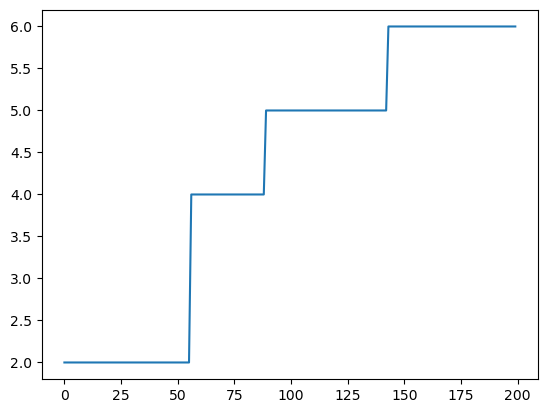

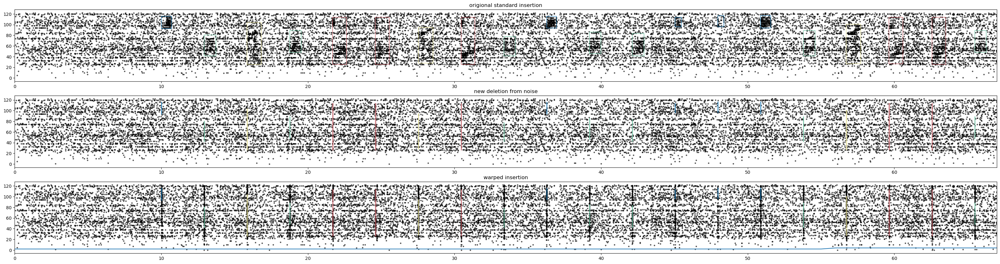

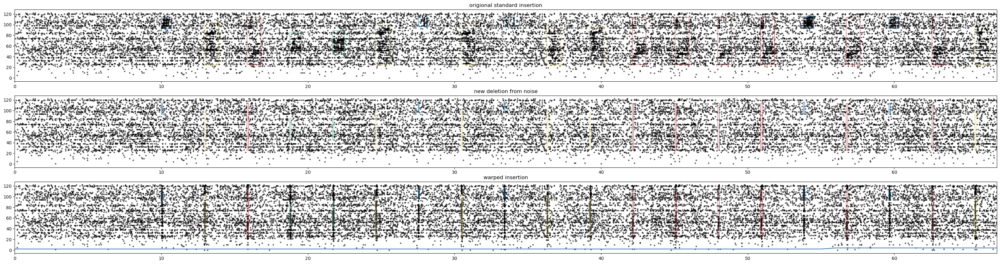

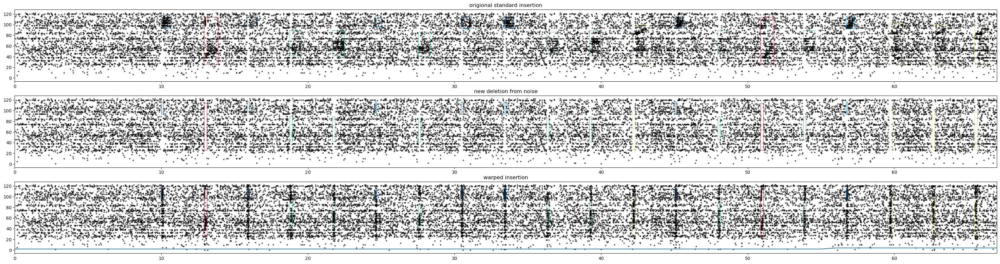

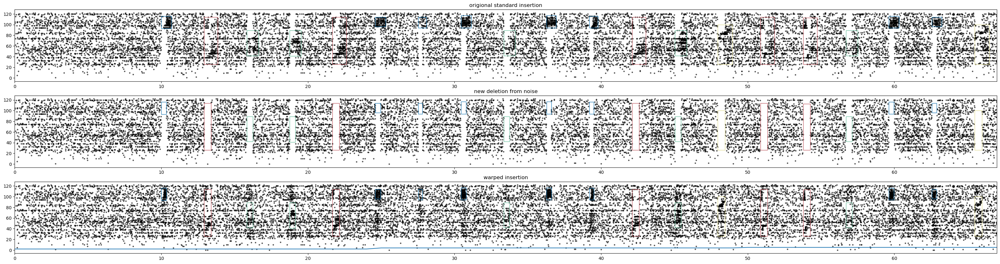

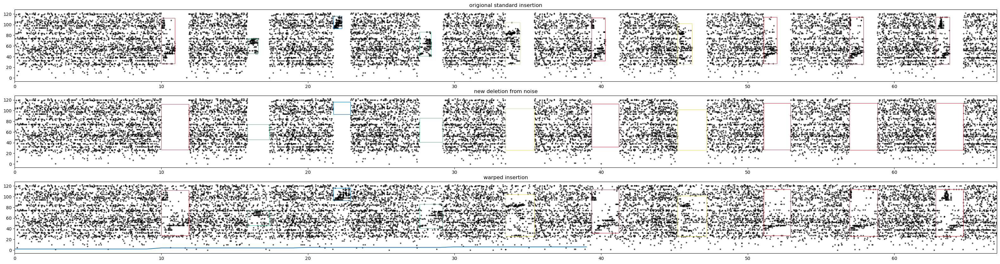

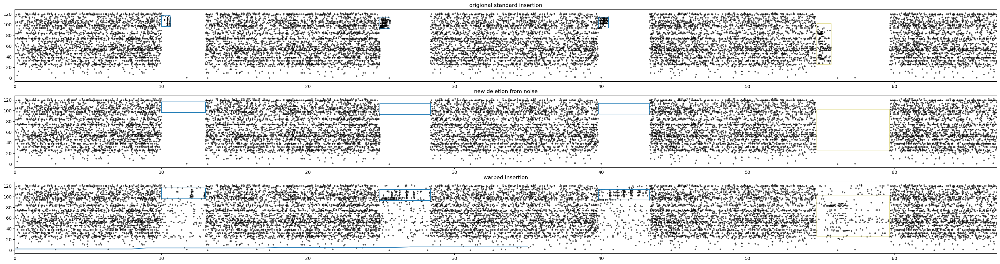

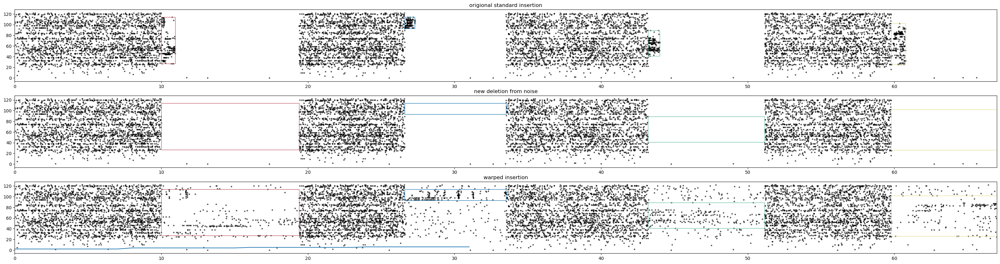

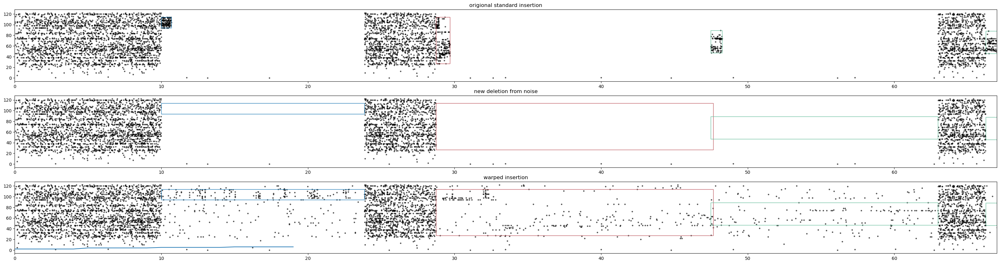

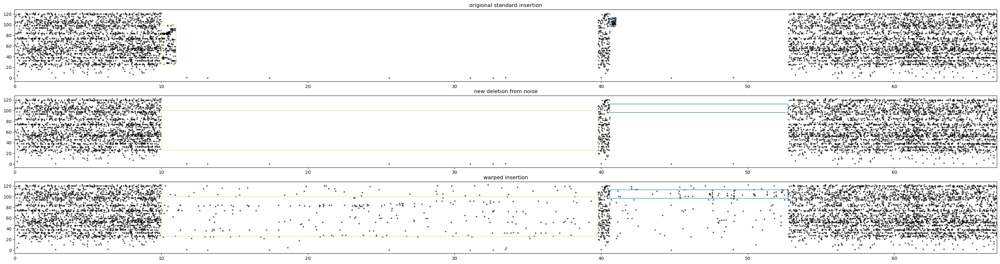

In [22]:
def stretch_or_compress_timeseries(orig,factor):
    sorted_index = np.argsort(orig)
    undo_sorting = [np.argsort(sorted_index)]
    
    sorted_orig = np.array(orig)[sorted_index]
    
    stretched = [sorted_orig[0]] + list(((sorted_orig[1::] - sorted_orig[0]) * factor) + sorted_orig[0])
    
    return(list(np.array(stretched)[undo_sorting][0]))

warps = [0.03, 0.1,0.2,0.5,2,5,10,20,30]

for warp in warps: 
    
    chosen_number= 200

    if warp == 2:
        chosen_number = 100
    if warp == 5:
        chosen_number = 40
    if warp == 10:
        chosen_number = 35
    if warp == 20:
        chosen_number = 30
    if warp == 30:
        chosen_number = 20


    ### choose randlonly and ans evenly as possible which seqs to implant: 

    seq_list = list(out_df.seq_type)
    indices = np.array([i for i in range(len(np.array(seq_list)))])


    indices_all = []
    for item in np.unique(seq_list):
        indices_all += [indices[np.array(seq_list) == item]]

    chosen_warp_inds = []
    while len(chosen_warp_inds) < chosen_number:
        for i in range(len(indices_all)):
            if len(indices_all[i]) > 0:
                if len(chosen_warp_inds) < 200:
                    random_idx = np.random.choice(len(indices_all[i]))
                    removed_value = indices_all[i][random_idx]
                    indices_all[i] = np.delete(indices_all[i], random_idx)

                    chosen_warp_inds += [removed_value]

    chosen_warp_inds = np.sort(chosen_warp_inds)


    plt.plot(np.sort(out_df.seq_type.values[np.array(chosen_warp_inds)]))



    ### distribute sequences across timeframe so they are nice and seperated... 

    max_time = round(max(permuted_spikes))

    # Set the number of time points you want
    num_points = len(chosen_warp_inds)

    # Generate a set of evenly spaced time points
    time_points = np.linspace(10, max_time-10, num_points)

    # Add some random variation to the spacing
    time_points += np.random.normal(scale=0, size=num_points)

    # Sort the time points in ascending order
    time_points = np.sort(time_points)

    print(min(np.diff(time_points)))
    print("min diff should be at least 2s, if not try again")

    #shuffle them
    random.shuffle(time_points)
    print(time_points)
    
    
    # reload origional  out_df 
    out_df = pd.read_pickle(out_path + "all_extracted_spike_profiles")

    # shift chosen inds to new distributed places
    for i,index in enumerate(chosen_warp_inds):
        profile = out_df.spike_profiles[index]   
        relative_spike_times = out_df.spike_profiles[index].timestamp.values - min(out_df.spike_profiles[index].timestamp.values)
        out_df.spike_profiles[index]['timestamp'] = relative_spike_times + time_points[i]


    permuted_spikes_df = pd.read_pickle(out_path + "permuted_spikes_df")
    permuted_neurons = permuted_spikes_df.permuted_neurons.values
    permuted_spikes = permuted_spikes_df.permuted_spikes.values

    updated_neurons = permuted_neurons
    updated_spikes = permuted_spikes
    updated_neuron_order = neuron_permute_loc[permuted_neurons.astype(int)-1]
    

    # define rectangles from origional implantation 
    rects = []
    for index in chosen_warp_inds:
        profile = out_df.spike_profiles[index]    
        # Create a Rectangle patch
        top = max(out_df.neuron_order[index])
        bottom = min(out_df.neuron_order[index])
        left = min(profile.timestamp)
        right = max(profile.timestamp)

        col_ = colors[int(out_df.seq_type[index])]
        rects +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]

    # warp data:
    
    seq_types = []
    insertion_ids = []
    profiles = []
    
    rects2 = []
    rects3 = []
    non_warp_timestamps = []
    
    warped_background_spikes = []
    warped_background_neurons = []
    
    for index in chosen_warp_inds:
        profile = out_df.spike_profiles[index]  
        
        #define background neurons prewarp
        top = max(out_df.neuron_order[index])
        bottom = min(out_df.neuron_order[index])
        left = min(profile.timestamp)
        right = max(profile.timestamp)
        background_range = np.invert((updated_neuron_order < top) * (updated_neuron_order > bottom))
        within_time_range = (updated_spikes > left) * (updated_spikes < right)
        bgrnd_mask = background_range * within_time_range

        # fix for error where there are no background spikes
        if not len(updated_spikes[bgrnd_mask]) == 0:
            warped_background_spikes_new = stretch_or_compress_timeseries(updated_spikes[bgrnd_mask],warp)

            warped_background_spikes += [warped_background_spikes_new]
            warped_background_neurons += [updated_neurons[bgrnd_mask]]
        else:
            warped_background_spikes += [[]]
            warped_background_neurons += [[]]
        
        non_warp_timestamps += [list(profile.timestamp.values)]
        warped_timestamps = stretch_or_compress_timeseries(profile.timestamp.values,warp)
        # warped timestamps in saved out data
        profile['timestamp'] = warped_timestamps
        
        seq_types +=  [out_df.seq_type[index]]
        insertion_ids += [index]
        profiles += [profile]
        
        top = max(out_df.neuron_order[index])
        bottom = min(out_df.neuron_order[index])
        left = min(profile.timestamp)
        right = max(profile.timestamp)
        
        col_ = colors[int(out_df.seq_type[index])]
        rects2 +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
        rects3 +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
        
    warp_insertion_df = pd.DataFrame(
    {'seq_type' : seq_types,
    'insertion_id' : insertion_ids,
    'inserted_profile': profiles})
    
    ## delete patches first 

    for i,index in enumerate(chosen_warp_inds):
        profile = warp_insertion_df.inserted_profile[i]    
        # Create a Rectangle patch - for warp we take a full rectangle -background spikes also 
        top = max(permuted_neurons)
        bottom = min(permuted_neurons)
        left = min(profile.timestamp)
        right = max(profile.timestamp)

        timemask = (updated_spikes>left)*(updated_spikes<right)
        neuron_mask = (updated_neuron_order>bottom)*(updated_neuron_order<top)
                
        # delete rectangles
        mask = np.invert(timemask * neuron_mask)

        updated_neurons = updated_neurons[mask]
        updated_spikes = updated_spikes[mask]
        updated_neuron_order = updated_neuron_order[mask]
        
        
        ## define deleted background for later use
        
        profile = out_df.spike_profiles[index]   
        top = max(out_df.neuron_order[index])
        bottom = min(out_df.neuron_order[index])
        left = min(profile.timestamp)
        right = max(profile.timestamp)
        timemask = (updated_spikes>left)*(updated_spikes<right)
        neuron_mask = (updated_neuron_order>bottom)*(updated_neuron_order<top)
        
        background_mask = timemask * neuron_mask
        newupdated_neurons = updated_neurons.copy()
        newupdated_spikes = updated_spikes.copy()

        


    ## then implant warps
    warped_spike_insertion = list(updated_spikes)
    warped_neuron_insertion = list(updated_neurons)

    non_warped_spike_insertion = list(updated_spikes)
    non_warped_neuron_insertion = list(updated_neurons)

    for index,item in enumerate(warp_insertion_df.insertion_id.values):
        profile = warp_insertion_df.inserted_profile[index]
        warped_spike_insertion += list(profile.timestamp)
        warped_neuron_insertion += list(profile.neuron)

        non_warped_spike_insertion += list(non_warp_timestamps[index])
        non_warped_neuron_insertion += list(profile.neuron)
        
        
        
        
        
        #also add warped background back in
        warped_spike_insertion += warped_background_spikes[index]
        warped_neuron_insertion += list(warped_background_neurons[index])
        # take timeframe
        
 
    ## Define figure
    fig,[ax1,ax2,ax3]= plt.subplots(3, 1,figsize=(40, 10))
    ax1.set_title('origional standard insertion')
    # plot origonal
    non_warped_neuron_insertion_order = neuron_permute_loc[np.array(non_warped_neuron_insertion).astype(int)-1]  
    ax1.scatter(non_warped_spike_insertion, non_warped_neuron_insertion_order,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)


    # plot deleted
    ax2.set_title('new deletion from noise')


    delted_permuted_neuron_order_new = neuron_permute_loc[updated_neurons.astype(int)-1]

    ax2.scatter(updated_spikes, delted_permuted_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)


    # # plot insertion
    ax3.set_title('warped insertion')

    warped_neuron_order = neuron_permute_loc[np.array(warped_neuron_insertion).astype(int)-1]  
    ax3.scatter(warped_spike_insertion,warped_neuron_order ,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)


    # Add the patch to the Axes
    for rect in rects:
        ax1.add_patch(rect)

    # Add the patch to the Axes
    for rect in rects2:
        ax2.add_patch(rect)

    # Add the patch to the Axes
    for rect in rects3:
        ax3.add_patch(rect)

    ax1.set_xlim([0,67])
    ax2.set_xlim([0,67])
    ax3.set_xlim([0,67])
    
    ## save out instertion data 

    if not os.path.isdir(out_path):
        os.makedirs(out_path)
    warp_insertion_df.to_pickle(out_path +  "warp_insertion" + str(warp)+ "_spike_profiles_" + str(today))


    type_ = 'warp_insertion' + str(warp)

    model_dir = r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\" 
    CHECK_FOLDER = os.path.isdir(model_dir)

    # If folder doesn't exist, then create it.
    if not CHECK_FOLDER:
        os.makedirs(model_dir)
        print("created folder : ", model_dir)

    json_ = {'full_path_to_data': dat_path,
     'mouse_implant_recording': mouse_session_recording,
     'output_filename': mouse_session_recording +'_' + type_,
     'save_path': model_dir,
     'time_span': [behav_time_interval_start],
     'single_or_multiunits': 'both',
     'region': 'striatum',
     'use_emmett_curation': False,
     'max_firing_rate': 15.0,
     'align_to_zero': True,
     'shuffle': 'None',
     'visualise': True,
     'min_fano_factor': 0.5,
     'max_fano_factor': 12,
     'number_of_neurons':N_neurons }

    params_filename= save_params_as_json(json_, json_["save_path"], "params_"+json_["output_filename"]+".json")

    spike_times = create_spike_time_vectors(np.array(warped_spike_insertion),np.array(warped_neuron_insertion))

    data_filename = write_text_file(spikes=spike_times, filename= json_["save_path"] + json_["output_filename"]+".txt") 

    print(f"    • data '.txt' file saved to:          {data_filename}")
    print(f"    • parameters '.json' file saved to:   {params_filename}")

# load data back in and plot to check it  

Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\178_2_2_warp_insertion30.txt
Z:\projects\sequence_squad\organised_data\ppseq_analysis\synthetic_data\178_2_2\striatum\warp_insertion30_spike_profiles_2023-11-28


(0.0, 67.0)

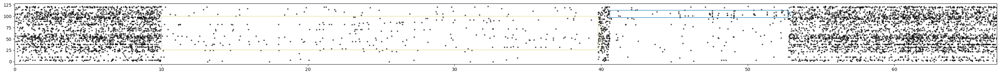

In [23]:
## load data back in to check it!


spikes_file = r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\" + mouse_session_recording + "_warp_insertion30.txt"

# spikes_file= json_["save_path"] + json_["output_filename"]+".txt"
print(spikes_file)
neuron_ids, spike_times= [], []
with open(spikes_file) as f:
    for (i, line) in enumerate(f.readlines()):
        [neuron_id, spike_time] = line.split(' ', 1)
        spike_time = eval(spike_time.split('\n')[0])
        neuron_id = eval(neuron_id.split('\t')[0])
        spike_times.append(spike_time)
        neuron_ids.append(neuron_id)
        
spikes_df = pd.DataFrame({'neuron':neuron_ids,'timestamp':spike_times}) 
        

print(out_path +  "warp_insertion" + str(warp)+ "_spike_profiles_" + str(today))
# implanted_data = pd.read_pickle(out_path +  "warp_insertion" + str(warp)+ "_spike_profiles_" + str(today))
implanted_data = pd.read_pickle(out_path +  "warp_insertion30" + "_spike_profiles_" + str(today))

# for loading color and order data from awake alignment 
region = 'striatum'
saved_data_path = os.path.join("Z:\projects\sequence_squad\organised_data\ppseq_analysis\ppseq_awake_analysis\plots\\" + mouse_session_recording, region) + '\\'

with open(os.path.join(os.path.join(PP_PATH,file) + r"\analysis_output\reordered_recolored\neuron_index"), "rb") as input_file:
    new_neuron_index = pickle.load(input_file)
    
# # for 8 seqs:



new_neuron_permute_loc = np.zeros(len(new_neuron_index))
for i in range(len(neuron_index)):
    new_neuron_permute_loc[i] = int(list(neuron_index).index(i))


fig,ax= plt.subplots(1, 1,figsize=(40, 2.5))


neuron_order_test = new_neuron_permute_loc[spikes_df.neuron.values.astype(int)-1]
ax.scatter(spikes_df.timestamp.values, neuron_order_test ,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)


col_ = []
rects = []
implanted_seq_types = []
all_implanted_rectangles = []
for index, seq_type in enumerate(implanted_data.seq_type.values):
    timestamps = implanted_data.inserted_profile[index].timestamp.values
    neurons = implanted_data.inserted_profile[index].neuron.values

    left = min(timestamps)
    right = max(timestamps)
    
    implanted_neuron_order = neuron_permute_loc[(neurons-1).astype(int)]
    top = max(implanted_neuron_order)
    bottom = min(implanted_neuron_order)
    
    col_ = colors[int(seq_type)]
    rects +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
    
for rect in rects:
    ax.add_patch(rect)


ax.set_xlim([0,67])

# drop spike percentages

2.9195979899496933
min diff should be at least 2s, if not try again
[176.41708543  24.59798995 377.86934673 272.7638191  439.18090452
 109.26633166 462.53768844 585.16080402 553.04522613  59.63316583
 471.29648241 383.70854271 488.81407035 334.07537688  18.75879397
 293.20100503 278.60301508 360.35175879 310.71859296  88.82914573
 234.80904523 231.88944724 369.11055276 158.89949749  36.27638191
 132.62311558 386.6281407  450.85929648 126.7839196  211.45226131
 205.61306533 541.36683417  42.11557789 249.40703518 497.57286432
  97.5879397  313.63819095  91.74874372 100.50753769 407.06532663
 185.1758794  506.33165829  47.95477387 307.79899497 281.52261307
 392.46733668 179.33668342 182.25628141 328.2361809  339.91457286
 226.05025126 372.03015075 459.61809045  56.71356784  10.
 436.26130653  74.23115578 258.16582915 579.32160804 336.99497487
 141.38190955  82.98994975 155.9798995  223.13065327 214.3718593
 144.30150754 316.55778894 351.59296482 480.05527638  62.55276382
 237.72864322 550

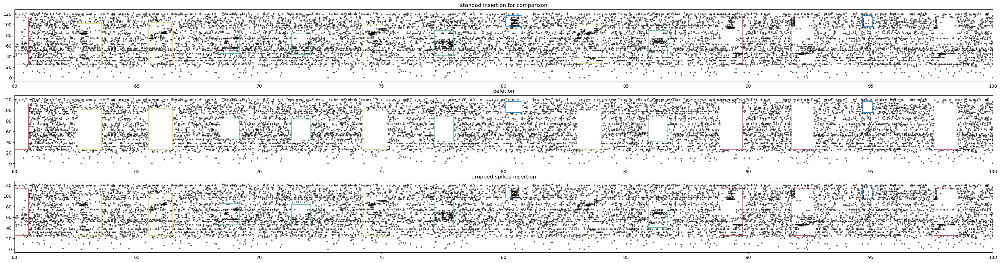

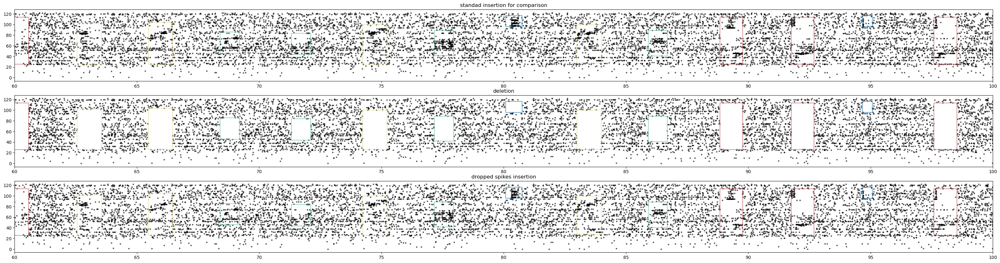

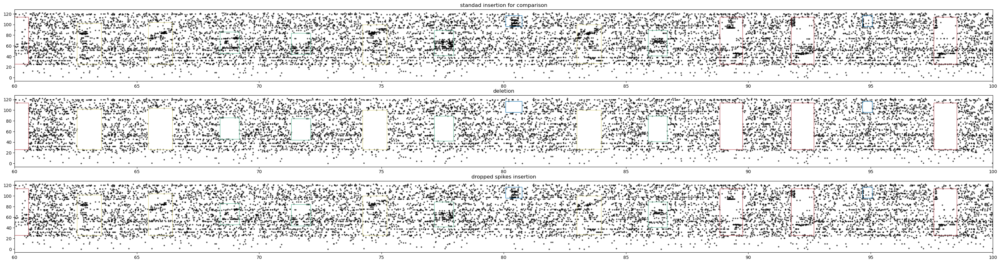

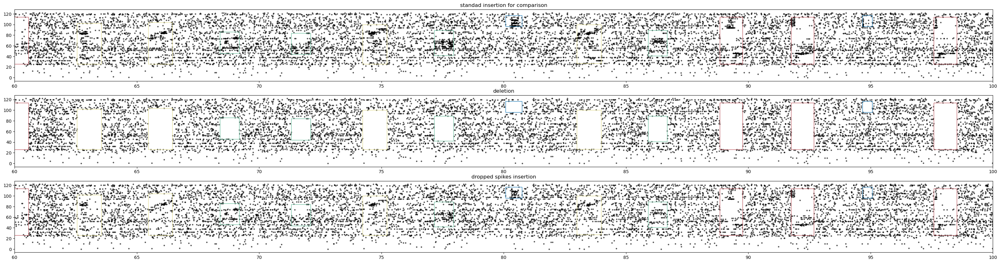

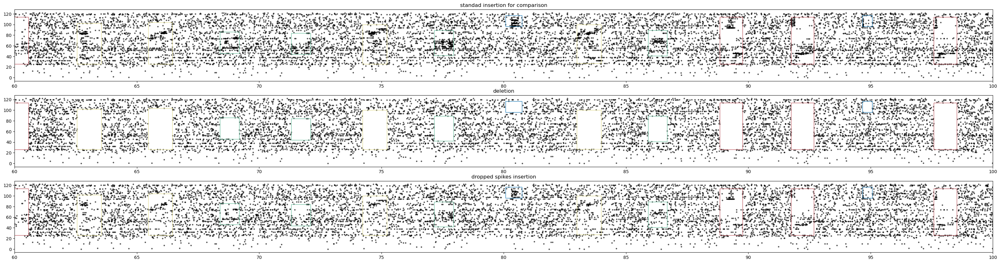

...

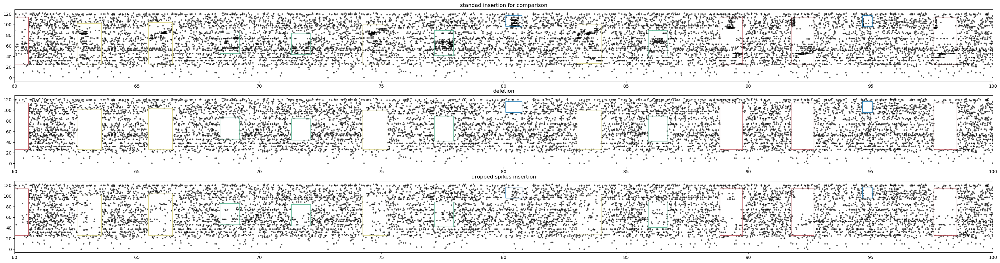

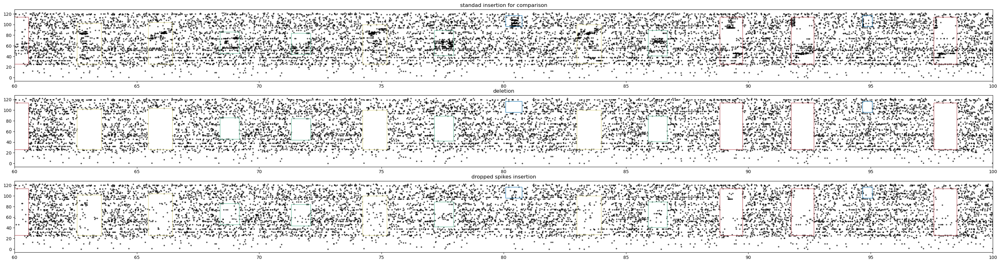

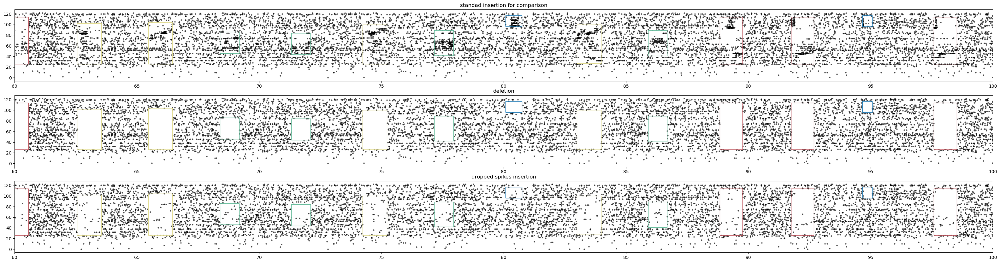

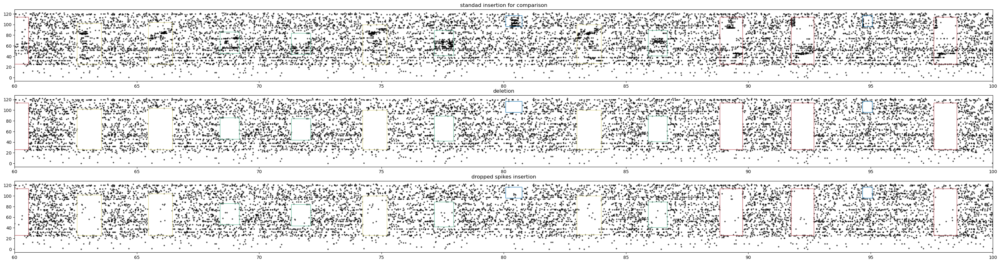

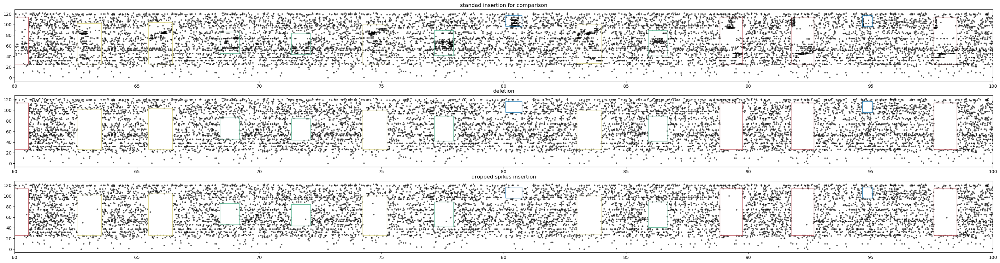

In [24]:

percentages = [90,80,70,60,50,40,30,20,15,10,5,1]


def select_values_to_remain(arr,Percentage_remaining):

    # Calculate the number of indices to select
    num_indices = int(Percentage_remaining / 100 * len(arr))

    # Randomly select the indices
    if num_indices == 0:
        num_indices += 1
    selected_indices = np.random.choice(len(arr), size=num_indices, replace=False)

    # Get the values from the array at the selected indices
    selected_values = arr[selected_indices]

    return selected_values,selected_indices 


# reload origional  out_df 
out_df = pd.read_pickle(out_path + "all_extracted_spike_profiles")


permuted_spikes_df = pd.read_pickle(out_path + "permuted_spikes_df")
permuted_neurons = permuted_spikes_df.permuted_neurons.values
permuted_spikes = permuted_spikes_df.permuted_spikes.values

updated_neurons = permuted_neurons
updated_spikes = permuted_spikes
updated_neuron_order = neuron_permute_loc[permuted_neurons.astype(int)-1]

### distribute sequences across timeframe so they are nice and seperated... 
max_time = round(max(permuted_spikes))

# Set the number of time points you want
num_points = len(chosen_inds)

# Generate a set of evenly spaced time points
time_points = np.linspace(10, max_time-10, num_points)

# Add some random variation to the spacing
time_points += np.random.normal(scale=0, size=num_points)

# Sort the time points in ascending order
time_points = np.sort(time_points)

print(min(np.diff(time_points)))
print("min diff should be at least 2s, if not try again")

#shuffle them
random.shuffle(time_points)
print(time_points)




# shift chosen inds to new distributed places
for i,index in enumerate(chosen_inds):
    profile = out_df.spike_profiles[index]   
    relative_spike_times = out_df.spike_profiles[index].timestamp.values - min(out_df.spike_profiles[index].timestamp.values)
    out_df.spike_profiles[index]['timestamp'] = relative_spike_times + time_points[i]



for Percentage_remaining in percentages:

    from matplotlib.patches import Rectangle

    rects = []
    rects2 = []
    rects3 = []
    for index in chosen_inds:

        profile = out_df.spike_profiles[index]    
        # Create a Rectangle patch
        top = max(out_df.neuron_order[index])
        bottom = min(out_df.neuron_order[index])
        left = min(profile.timestamp)
        right = max(profile.timestamp)

        col_ = colors[int(out_df.seq_type[index])]
        rects +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
        rects2 +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
        rects3 +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]


    ## delete patches first 
    for index in chosen_inds:

        profile = out_df.spike_profiles[index]    
        # Create a Rectangle patch
        top = max(out_df.neuron_order[index])
        bottom = min(out_df.neuron_order[index])
        left = min(profile.timestamp)
        right = max(profile.timestamp)

        timemask = (updated_spikes>left)*(updated_spikes<right)
        neuron_mask = (updated_neuron_order>bottom)*(updated_neuron_order<top)
        mask = np.invert(timemask * neuron_mask)

        updated_neurons = updated_neurons[mask]
        updated_spikes = updated_spikes[mask]
        updated_neuron_order = updated_neuron_order[mask]


    # ## then drop out spikes and implant seqs
    standard_spike_insertion = list(updated_spikes)
    standard_neuron_insertion = list(updated_neurons)

    dropped_spike_insertion = list(updated_spikes)
    dropped_neuron_insertion = list(updated_neurons)

    #save out for future plotting
    seq_types = []
    insertion_ids = []
    profiles = []

    for index in chosen_inds:
        profile = out_df.spike_profiles[index].copy()  
        # for plotting/visualisation purposes
        standard_spike_insertion +=  list(profile.timestamp.values)
        standard_neuron_insertion += list(profile.neuron.values)

        reminaing_times,reminaing_inds = select_values_to_remain(profile.timestamp.values,Percentage_remaining)
        reminaing_inds= np.sort(reminaing_inds)
        # drop out rows:
        profile.reset_index(drop=True, inplace=True)
        profile = profile.iloc[reminaing_inds]

        dropped_spike_insertion +=  list(profile.timestamp.values)
        dropped_neuron_insertion += list(profile.neuron.values)

        seq_types +=  [out_df.seq_type[index]]
        insertion_ids += [index]

        # save out dropped out profile
        profiles += [profile]

    dropped_insertion_df = pd.DataFrame(
    {'seq_type' : seq_types,
    'insertion_id' : insertion_ids,
    'inserted_profile': profiles})

    fig,[ax1,ax2,ax3]= plt.subplots(3, 1,figsize=(40, 10))

    # plot origonal
    ax1.set_title('standad insertion for comparison')
    permuted_neuron_order_new = neuron_permute_loc[np.array(standard_neuron_insertion).astype(int)-1]  

    ax1.scatter(standard_spike_insertion, permuted_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)
    for rect in rects:
        ax1.add_patch(rect)

    # plot deleted
    ax2.set_title('deletion')

    delted_permuted_neuron_order_new = neuron_permute_loc[np.array(updated_neurons).astype(int)-1]  

    ax2.scatter(updated_spikes, delted_permuted_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)

    # Add the patch to the Axes
    for rect in rects2:
        ax2.add_patch(rect)



    # # # plot insertion
    ax3.set_title('dropped spikes insertion')

    dropped_spikes_neuron_order = neuron_permute_loc[np.array(dropped_neuron_insertion).astype(int)-1]  

    ax3.scatter(dropped_spike_insertion, dropped_spikes_neuron_order,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)
    for rect in rects3:
        ax3.add_patch(rect)



    ax1.set_xlim([60,100])
    ax2.set_xlim([60,100])
    ax3.set_xlim([60,100])
        

    ## save out instertion data 
    if not os.path.isdir(out_path):
        os.makedirs(out_path)
    dropped_insertion_df.to_pickle(out_path +  "dropped_spikes_insertion_" + str(100-Percentage_remaining)+ "_dropped_"+"_insertion_spike_profiles_" + str(today))

    type_ = 'dropped_spikes_insertion_' + str(100-Percentage_remaining)

    model_dir = r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\" 
    CHECK_FOLDER = os.path.isdir(model_dir)

    # If folder doesn't exist, then create it.
    if not CHECK_FOLDER:
        os.makedirs(model_dir)
        print("created folder : ", model_dir)

    json_ = {'full_path_to_data': dat_path,
     'mouse_implant_recording': mouse_session_recording,
     'output_filename': mouse_session_recording + '_' + type_ ,
     'save_path': model_dir,
     'time_span': [behav_time_interval_start],
     'single_or_multiunits': 'both',
     'region': 'striatum',
     'use_emmett_curation': False,
     'max_firing_rate': 15.0,
     'align_to_zero': True,
     'shuffle': 'None',
     'visualise': True,
     'min_fano_factor': 0.5,
     'max_fano_factor': 12,
     'number_of_neurons':N_neurons }

    params_filename= save_params_as_json(json_, json_["save_path"], "params_"+json_["output_filename"]+".json")

    spike_times = create_spike_time_vectors(np.array(dropped_spike_insertion),np.array(dropped_neuron_insertion))

    data_filename = write_text_file(spikes=spike_times, filename= json_["save_path"] + json_["output_filename"]+".txt") 

    print(f"    • data '.txt' file saved to:          {data_filename}")
    print(f"    • parameters '.json' file saved to:   {params_filename}")

## load data back in to check it!

Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\178_2_2_dropped_spikes_insertion_90.txt
Z:\projects\sequence_squad\organised_data\ppseq_analysis\synthetic_data\178_2_2\striatum\dropped_spikes_insertion_99_dropped__insertion_spike_profiles_2023-11-28


(60.0, 100.0)

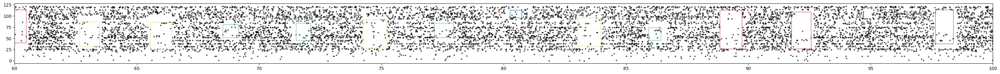

In [25]:
# ## load data back in to check it!
spikes_file = r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\"+ mouse_session_recording + "_dropped_spikes_insertion_90.txt"

# spikes_file= json_["save_path"] + json_["output_filename"]+".txt"
print(spikes_file)
neuron_ids, spike_times= [], []
with open(spikes_file) as f:
    for (i, line) in enumerate(f.readlines()):
        [neuron_id, spike_time] = line.split(' ', 1)
        spike_time = eval(spike_time.split('\n')[0])
        neuron_id = eval(neuron_id.split('\t')[0])
        spike_times.append(spike_time)
        neuron_ids.append(neuron_id)
        
spikes_df = pd.DataFrame({'neuron':neuron_ids,'timestamp':spike_times}) 
        

print(out_path +  "dropped_spikes_insertion_99"+ "_dropped_"+"_insertion_spike_profiles_" + str(today))
implanted_data = pd.read_pickle(out_path +  "dropped_spikes_insertion_90_dropped_"+"_insertion_spike_profiles_" + str(today))

# for loading color and order data from awake alignment 
region = 'striatum'
saved_data_path = os.path.join("Z:\projects\sequence_squad\organised_data\ppseq_analysis\ppseq_awake_analysis\plots\\" + mouse_session_recording, region) + '\\'

with open(os.path.join(os.path.join(PP_PATH,file) + r"\analysis_output\reordered_recolored\neuron_index"), "rb") as input_file:
    new_neuron_index = pickle.load(input_file)
    
# # for 8 seqs:



new_neuron_permute_loc = np.zeros(len(new_neuron_index))
for i in range(len(neuron_index)):
    new_neuron_permute_loc[i] = int(list(neuron_index).index(i))


fig,ax= plt.subplots(1, 1,figsize=(40, 2.5))


neuron_order_test = new_neuron_permute_loc[spikes_df.neuron.values.astype(int)-1]
ax.scatter(spikes_df.timestamp.values, neuron_order_test ,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)


col_ = []
rects = []
implanted_seq_types = []
all_implanted_rectangles = []
for index, seq_type in enumerate(implanted_data.seq_type.values):
    timestamps = implanted_data.inserted_profile[index].timestamp.values
    neurons = implanted_data.inserted_profile[index].neuron.values

    left = min(timestamps)
    right = max(timestamps)
    
    implanted_neuron_order = neuron_permute_loc[(neurons-1).astype(int)]
    top = max(implanted_neuron_order)
    bottom = min(implanted_neuron_order)
    
    col_ = colors[int(seq_type)]
    rects +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
    
for rect in rects:
    ax.add_patch(rect)


ax.set_xlim([60,100])

# disorder spikes 

1.629393047866472
min diff should be at least 2s, if not try again
[415.89101424 521.32517613 264.28243654 587.63237324 310.55602503
 255.17342483 170.33779002  12.81796725  50.81808641 275.67297866
 567.27584059  71.03722807 162.15205458 208.2793018  234.92490283
 463.28030845 515.21202593 535.8553477  214.3839857  468.53596163
  21.73697106 199.65764625 211.22289328  68.36416808 430.16253026
 118.45458058  95.2414853  196.49539926  30.27143276 141.29054325
 433.42962682 109.39856697 374.78798935 503.37227489 354.41196281
 427.50145965 345.5823859  544.84951419 138.66194938  76.94539743
 570.59008035 252.65987402 129.39380033 246.24163133 319.50700643
 317.05410298 112.46811316 538.30894598 413.14933016 552.65913462
 290.3788482  324.79178991 564.7759767  506.15177146 494.82781294
  89.07873473 529.60915067 349.01184884 511.70679274 336.76851804
 103.26343729  54.11917627 488.86981737 217.84837945 532.83490405
 590.8858468  106.38339426 126.73668002 150.21035015  83.02133705
 477.0995

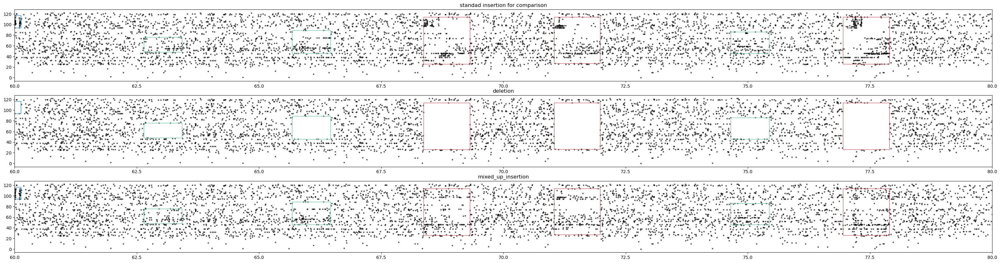

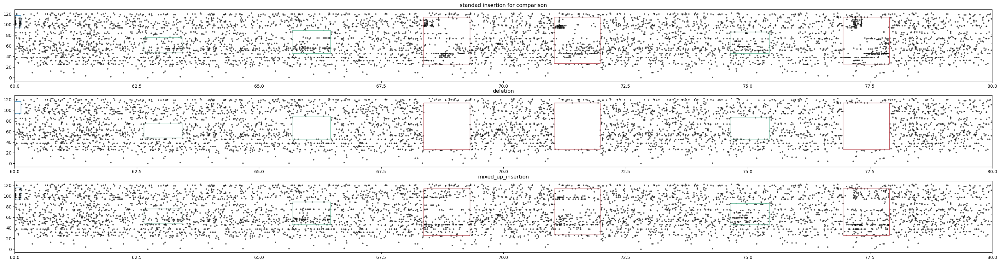

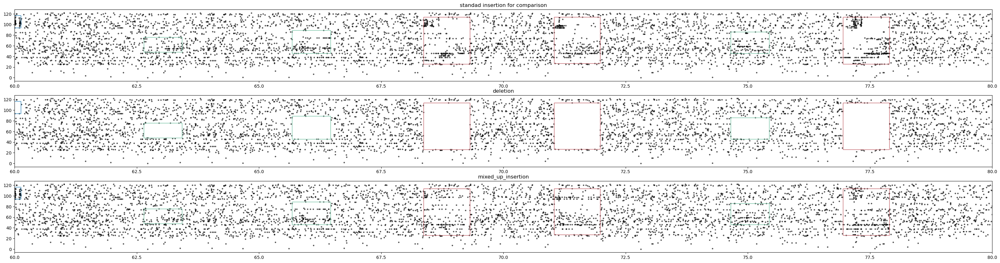

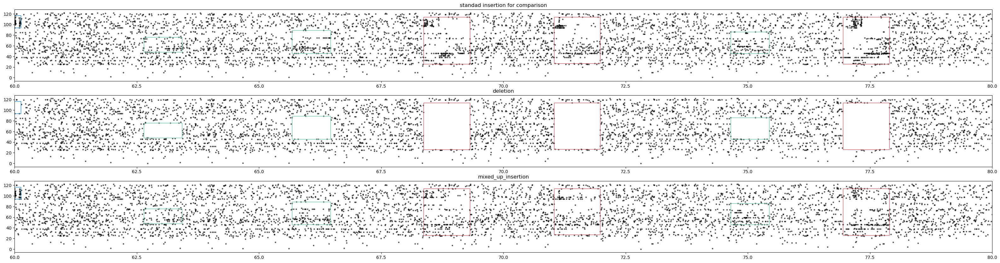

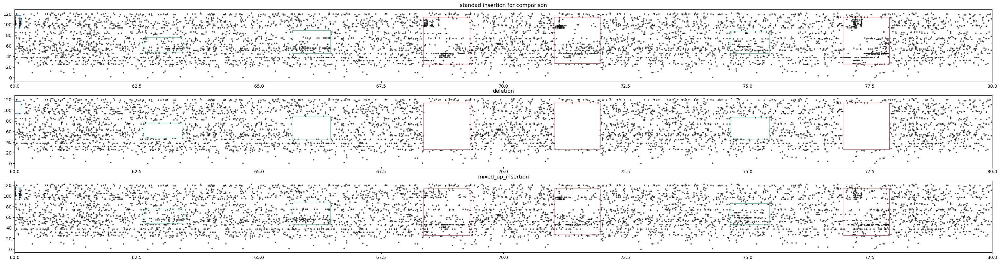

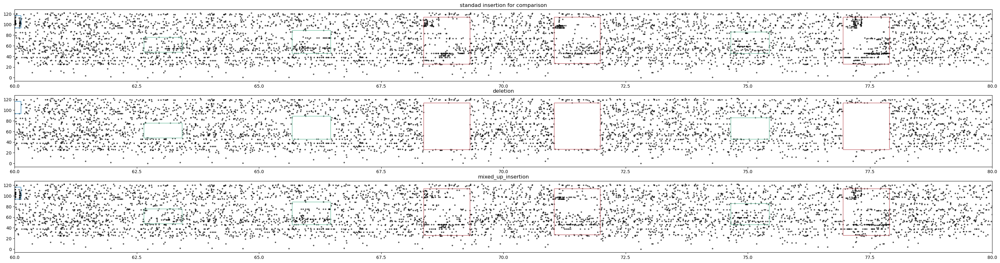

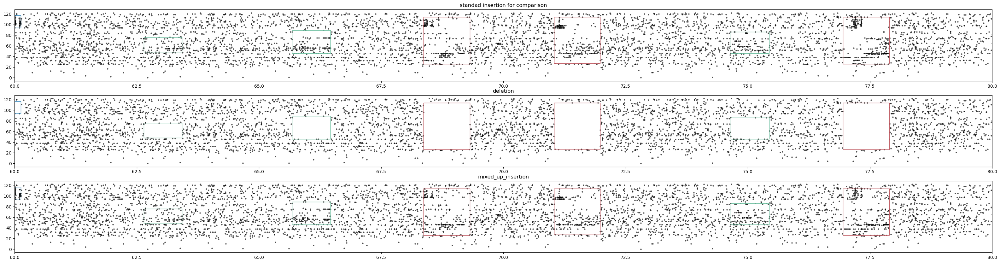

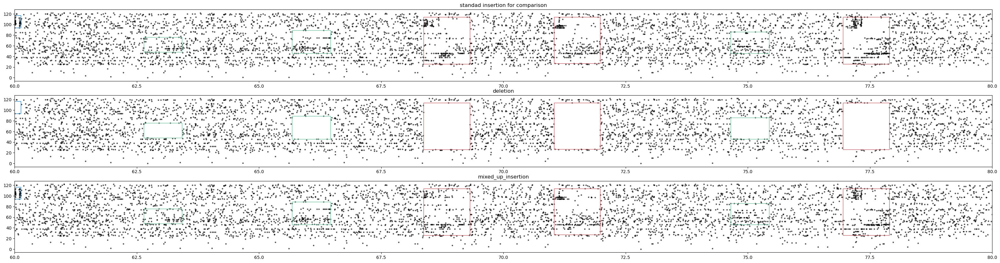

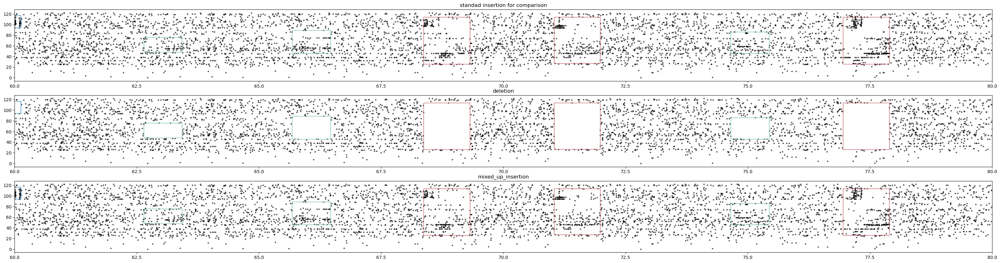

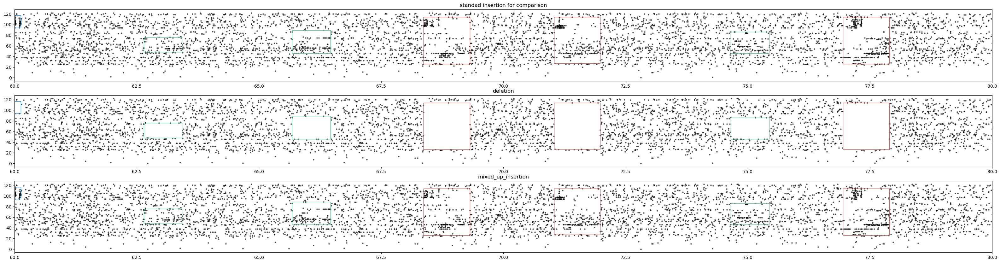

In [26]:
##### previous way of doing the disordering. 

### distribute sequences across timeframe so they are nice and seperated... 

max_time = round(max(permuted_spikes))

# Set the number of time points you want
num_points = len(chosen_inds)

# Generate a set of evenly spaced time points
time_points = np.linspace(10, max_time-10, num_points)

# Add some random variation to the spacing
time_points += np.random.normal(scale=0.3, size=num_points)

# Sort the time points in ascending order
time_points = np.sort(time_points)

print(min(np.diff(time_points)))
print("min diff should be at least 2s, if not try again")

#shuffle them
random.shuffle(time_points)
print(time_points)


# mix the spikss up in time - swap them with other neurons to different degrees

### maybe turn this whole thing into a loop? and the one above? 

shuffles = [100,90,80,70,60,50,40,30,20,10]

for shuffle_percentage in shuffles:
    

    def swap_percentage_of_values(array,percent):

        array2 = array.copy()

        number_of_elemets_to_change = int((percent/100)*len(array))
        # needs to be even
        if number_of_elemets_to_change%2 == 1:
            number_of_elemets_to_change = number_of_elemets_to_change-1

        array_indexes_to_change = []
        count = 0
        while count < number_of_elemets_to_change:
            random_index = random.randint(0, len(array)-1)
            # if its already been slected then move on
            if not random_index in array_indexes_to_change:
                array_indexes_to_change.append(random_index)
                count = count + 1

        counter = 0
        while len(array_indexes_to_change) > 0:
            index1 = array_indexes_to_change[random.randint(0, len(array_indexes_to_change)-1)]
            swap_value_1 = array[index1]
            index2 = array_indexes_to_change[random.randint(0, len(array_indexes_to_change)-1)]
            swap_value_2 = array[index2]
            if not index1 == index2:

                delete_list = [index1,index2]
                delete_list.sort(reverse=True)
                for item in delete_list:
                    delete_indx = np.where(np.array(array_indexes_to_change) == item)[0][0]
                    array_indexes_to_change.pop(delete_indx)

                array2[index1] = swap_value_2
                array2[index2] = swap_value_1

        return array2

    ## work on this, at the moment the swaps are not ideal, I think I should randomly reassign the spike to a different neuron in the pool of neurons - ie. so it gets closer to a blob of activity rather than a structured thing. 
    # ie. not a swap but a random reassignment 

    # reload origional  out_df 
    out_df = pd.read_pickle(out_path + "all_extracted_spike_profiles")
    

    permuted_spikes_df = pd.read_pickle(out_path + "permuted_spikes_df")
    permuted_neurons = permuted_spikes_df.permuted_neurons.values
    permuted_spikes = permuted_spikes_df.permuted_spikes.values

    updated_neurons = permuted_neurons
    updated_spikes = permuted_spikes
    updated_neuron_order = neuron_permute_loc[permuted_neurons.astype(int)-1]
    
    # shift chosen inds to new distributed places
    for i,index in enumerate(chosen_inds):
        profile = out_df.spike_profiles[index]   
        relative_spike_times = out_df.spike_profiles[index].timestamp.values - min(out_df.spike_profiles[index].timestamp.values)
        out_df.spike_profiles[index]['timestamp'] = relative_spike_times + time_points[i]



    from matplotlib.patches import Rectangle

    rects = []
    rects2 = []
    rects3 = []
    for index in chosen_inds:

        profile = out_df.spike_profiles[index]    
        # Create a Rectangle patch
        top = max(out_df.neuron_order[index])
        bottom = min(out_df.neuron_order[index])
        left = min(profile.timestamp)
        right = max(profile.timestamp)

        col_ = colors[int(out_df.seq_type[index])]
        rects +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
        rects2 +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
        rects3 +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]


    #delete patches:
    for index in chosen_inds:

        profile = out_df.spike_profiles[index]    
        # Create a Rectangle patch
        top = max(out_df.neuron_order[index])
        bottom = min(out_df.neuron_order[index])
        left = min(profile.timestamp)
        right = max(profile.timestamp)

        timemask = (updated_spikes>left)*(updated_spikes<right)
        neuron_mask = (updated_neuron_order>bottom)*(updated_neuron_order<top)
        mask = np.invert(timemask * neuron_mask)

        updated_neurons = updated_neurons[mask]
        updated_spikes = updated_spikes[mask]
        updated_neuron_order = updated_neuron_order[mask]
        
        
    ## then implant seqs
    swapped_spike_insertion = list(updated_spikes)
    swapped_neuron_insertion = list(updated_neurons)

    standard_spike_insertion = list(updated_spikes)
    standard_neuron_insertion = list(updated_neurons)

    #save out for future plotting
    seq_types = []
    insertion_ids = []
    profiles = []

    for index in chosen_inds:
        profile = out_df.spike_profiles[index]  

        standard_spike_insertion +=  list(profile.timestamp.values)
        standard_neuron_insertion += list(profile.neuron.values)

        jumbulled_ts = swap_percentage_of_values(profile.timestamp.values,shuffle_percentage)

        profile['timestamp'] = jumbulled_ts

        swapped_spike_insertion +=  list(profile.timestamp.values)
        swapped_neuron_insertion += list(profile.neuron.values)

        seq_types +=  [out_df.seq_type[index]]
        insertion_ids += [index]

        # save out dropped out profile
        profiles += [profile]

    jumbelled_insertion_df = pd.DataFrame(
    {'seq_type' : seq_types,
    'insertion_id' : insertion_ids,
    'inserted_profile': profiles})



    fig,[ax1,ax2,ax3]= plt.subplots(3, 1,figsize=(40, 10))

    # plot origonal
    ax1.set_title('standad insertion for comparison')
    permuted_neuron_order_new = neuron_permute_loc[np.array(standard_neuron_insertion).astype(int)-1]  

    ax1.scatter(standard_spike_insertion, permuted_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)
    for rect in rects:
        ax1.add_patch(rect)

    # plot deleted
    ax2.set_title('deletion')

    delted_permuted_neuron_order_new = neuron_permute_loc[updated_neurons.astype(int)-1]

    ax2.scatter(updated_spikes, delted_permuted_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)

    # Add the patch to the Axes
    for rect in rects2:
        ax2.add_patch(rect)




    # # plot insertion
    ax3.set_title('mixed_up_insertion')

    swapped_neuron_order_new = neuron_permute_loc[np.array(swapped_neuron_insertion).astype(int)-1]

    ax3.scatter(swapped_spike_insertion, swapped_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)
    for rect in rects3:
        ax3.add_patch(rect)



    ax1.set_xlim([60,80])
    ax2.set_xlim([60,80])
    ax3.set_xlim([60,80])

    ## save out instertion data 

    if not os.path.isdir(out_path):
        os.makedirs(out_path)
    jumbelled_insertion_df.to_pickle(out_path +  "swapped_spikes_insertion_" + str(shuffle_percentage)+ "_swap_percentage_"+"_insertion_spike_profiles_" + str(today))


    type_ = 'swapped_spikes_insertion_' + str(shuffle_percentage)

    model_dir = r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\" 
    CHECK_FOLDER = os.path.isdir(model_dir)

    # If folder doesn't exist, then create it.
    if not CHECK_FOLDER:
        os.makedirs(model_dir)
        print("created folder : ", model_dir)

    json_ = {'full_path_to_data': dat_path,
     'mouse_implant_recording': mouse_session_recording,
     'output_filename': mouse_session_recording + '_' + type_,
     'save_path': model_dir,
     'time_span': [behav_time_interval_start],
     'single_or_multiunits': 'both',
     'region': 'striatum',
     'use_emmett_curation': False,
     'max_firing_rate': 15.0,
     'align_to_zero': True,
     'shuffle': 'None',
     'visualise': True,
     'min_fano_factor': 0.5,
     'max_fano_factor': 12,
     'number_of_neurons':N_neurons }

    params_filename= save_params_as_json(json_, json_["save_path"], "params_"+json_["output_filename"]+".json")

    spike_times = create_spike_time_vectors(np.array(swapped_spike_insertion),np.array(swapped_neuron_insertion))

    data_filename = write_text_file(spikes=spike_times, filename= json_["save_path"] + json_["output_filename"]+".txt") 

    print(f"    • data '.txt' file saved to:          {data_filename}")
    print(f"    • parameters '.json' file saved to:   {params_filename}")

Load data back in to check it

Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\178_2_2_swapped_spikes_insertion_10.txt
Z:\projects\sequence_squad\organised_data\ppseq_analysis\synthetic_data\178_2_2\striatum\swapped_spikes_insertion_10_swap_percentage__insertion_spike_profiles_2023-11-28


(60.0, 80.0)

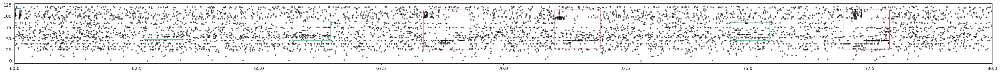

In [27]:
# ## load data back in to check it!

spikes_file = r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\"+ mouse_session_recording + "_swapped_spikes_insertion_10.txt"

# spikes_file= json_["save_path"] + json_["output_filename"]+".txt"
print(spikes_file)
neuron_ids, spike_times= [], []
with open(spikes_file) as f:
    for (i, line) in enumerate(f.readlines()):
        [neuron_id, spike_time] = line.split(' ', 1)
        spike_time = eval(spike_time.split('\n')[0])
        neuron_id = eval(neuron_id.split('\t')[0])
        spike_times.append(spike_time)
        neuron_ids.append(neuron_id)
        
spikes_df = pd.DataFrame({'neuron':neuron_ids,'timestamp':spike_times}) 
        

print(out_path +  "swapped_spikes_insertion_10" + "_swap_percentage_"+"_insertion_spike_profiles_" + str(today))
implanted_data = pd.read_pickle(out_path +  "swapped_spikes_insertion_10" + "_swap_percentage_"+"_insertion_spike_profiles_" + str(today))

# for loading color and order data from awake alignment 
region = 'striatum'
saved_data_path = os.path.join("Z:\projects\sequence_squad\organised_data\ppseq_analysis\ppseq_awake_analysis\plots\\" + mouse_session_recording, region) + '\\'

with open(os.path.join(os.path.join(PP_PATH,file) + r"\analysis_output\reordered_recolored\neuron_index"), "rb") as input_file:
    new_neuron_index = pickle.load(input_file)

    
# # for 8 seqs:



new_neuron_permute_loc = np.zeros(len(new_neuron_index))
for i in range(len(neuron_index)):
    new_neuron_permute_loc[i] = int(list(neuron_index).index(i))


fig,ax= plt.subplots(1, 1,figsize=(40, 2.5))


neuron_order_test = new_neuron_permute_loc[spikes_df.neuron.values.astype(int)-1]
ax.scatter(spikes_df.timestamp.values, neuron_order_test ,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)


col_ = []
rects = []
implanted_seq_types = []
all_implanted_rectangles = []
for index, seq_type in enumerate(implanted_data.seq_type.values):
    timestamps = implanted_data.inserted_profile[index].timestamp.values
    neurons = implanted_data.inserted_profile[index].neuron.values

    left = min(timestamps)
    right = max(timestamps)
    
    implanted_neuron_order = neuron_permute_loc[(neurons-1).astype(int)]
    top = max(implanted_neuron_order)
    bottom = min(implanted_neuron_order)
    
    col_ = colors[int(seq_type)]
    rects +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
    
for rect in rects:
    ax.add_patch(rect)


ax.set_xlim([60,80])

In [28]:
## work on this, at the moment the swaps are not ideal, I think I should randomly reassign the spike to a different neuron in the pool of neurons - ie. so it gets closer to a blob of activity rather than a structured thing. 
# ie. not a swap but a random reassignment 

# introduce background noise 

# adds noise into all neurons that are not part of the origional seq - so adds spike soutside the square and also some inside the square

    • data '.txt' file saved to:          Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\178_2_2_background_noise_insertion_20.txt
    • parameters '.json' file saved to:   Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\params_178_2_2_background_noise_insertion_20.json
    • data '.txt' file saved to:          Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\178_2_2_background_noise_insertion_40.txt
    • parameters '.json' file saved to:   Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\params_178_2_2_background_noise_insertion_40.json
    • data '.txt' file saved to:          Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\178_2_2_background_noise_insertion_80.txt
    • parameters '.json' file saved to:   Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_

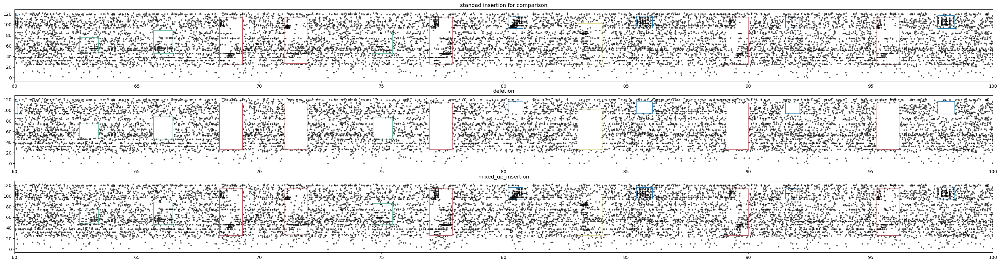

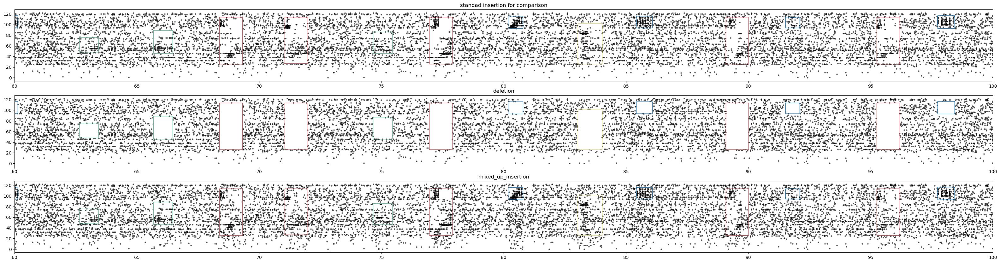

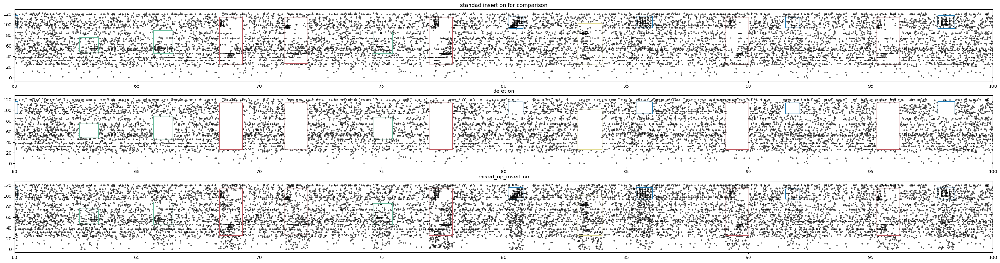

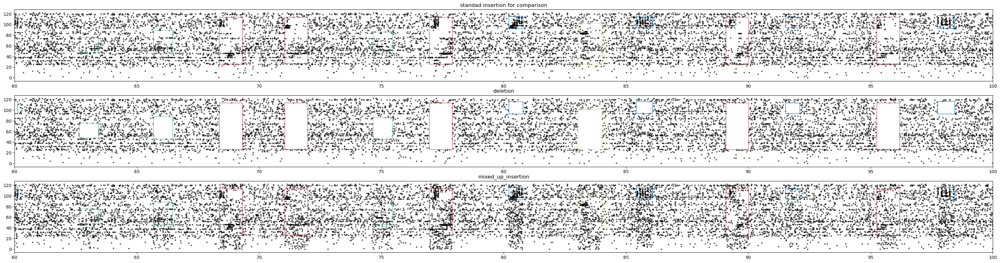

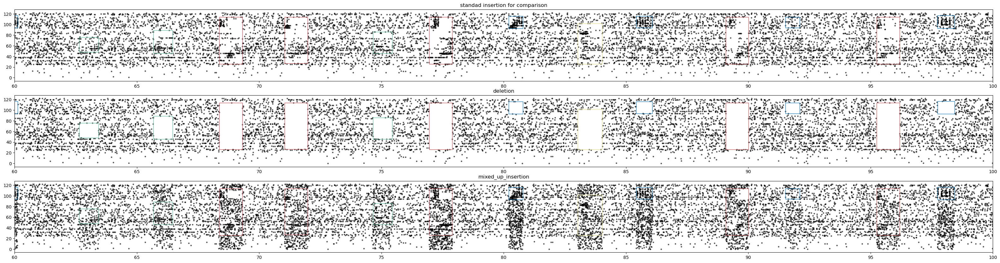

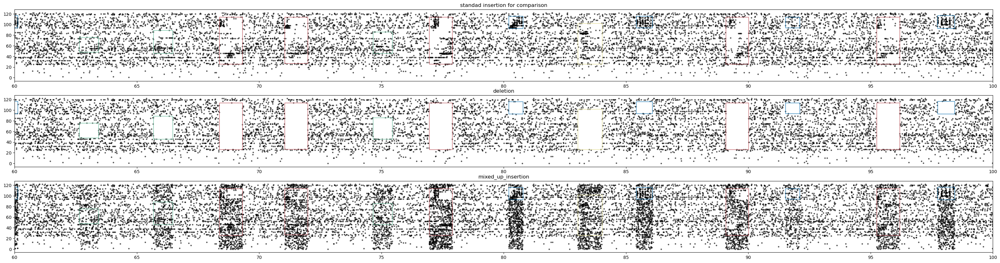

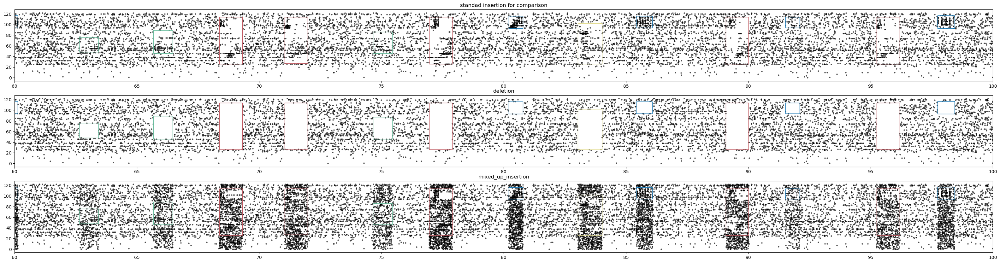

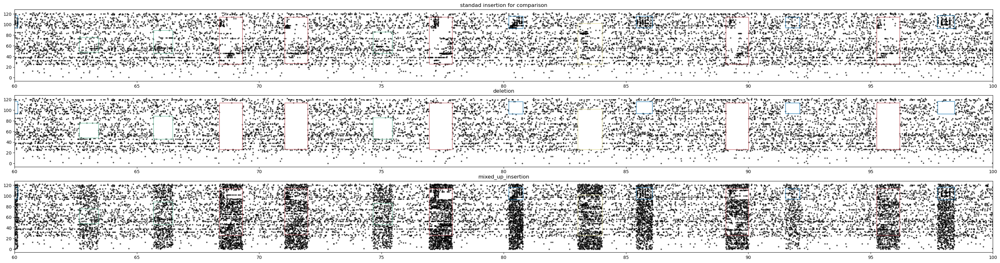

In [29]:
# add in extra spikes randonly - as a percentage of the total spikes to start with

percentages = [20,40,80,100,200,300,400, 500]


for percentage in percentages:
    
    # reload origional  out_df 
    out_df = pd.read_pickle(out_path + "all_extracted_spike_profiles")


    # shift chosen inds to new distributed places
    for i,index in enumerate(chosen_inds):
        profile = out_df.spike_profiles[index]   
        relative_spike_times = out_df.spike_profiles[index].timestamp.values - min(out_df.spike_profiles[index].timestamp.values)
        out_df.spike_profiles[index]['timestamp'] = relative_spike_times + time_points[i]


    permuted_spikes_df = pd.read_pickle(out_path + "permuted_spikes_df")
    permuted_neurons = permuted_spikes_df.permuted_neurons.values
    permuted_spikes = permuted_spikes_df.permuted_spikes.values

    updated_neurons = permuted_neurons
    updated_spikes = permuted_spikes
    updated_neuron_order = neuron_permute_loc[permuted_neurons.astype(int)-1]
    
    
    # create rectangles for plotting 
    rects = []
    rects2 = []
    rects3 = []
    for index in chosen_inds:
        profile = out_df.spike_profiles[index]    
        # Create a Rectangle patch
        top = max(out_df.neuron_order[index])
        bottom = min(out_df.neuron_order[index])
        left = min(profile.timestamp)
        right = max(profile.timestamp)

        col_ = colors[int(out_df.seq_type[index])]
        rects +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
        rects2 +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
        rects3 +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
        
    #delete patches:
    for index in chosen_inds:

        profile = out_df.spike_profiles[index]    
        # Create a Rectangle patch
        top = max(out_df.neuron_order[index])
        bottom = min(out_df.neuron_order[index])
        left = min(profile.timestamp)
        right = max(profile.timestamp)

        timemask = (updated_spikes>left)*(updated_spikes<right)
        neuron_mask = (updated_neuron_order>bottom)*(updated_neuron_order<top)
        mask = np.invert(timemask * neuron_mask)

        updated_neurons = updated_neurons[mask]
        updated_spikes = updated_spikes[mask]
        updated_neuron_order = updated_neuron_order[mask]
            
    
    ## implant seqs
    noise_added_spike_insertion = list(updated_spikes)
    noise_added_neuron_insertion = list(updated_neurons)

    standard_spike_insertion = list(updated_spikes)
    standard_neuron_insertion = list(updated_neurons)

    #save out for future plotting
    seq_types = []
    insertion_ids = []
    profiles = []

    for index in chosen_inds:
        profile = out_df.spike_profiles[index]  

        top = max(out_df.neuron_order[index])
        bottom = min(out_df.neuron_order[index])
        left = min(profile.timestamp)
        right = max(profile.timestamp)

        standard_spike_insertion +=  list(profile.timestamp.values)
        standard_neuron_insertion += list(profile.neuron.values)


        #add noise into all background cells - ie everything thats not involved in the sequence. add a certain number of spikes 

        n_neurons = len(np.unique(permuted_neurons))
        all_neurons = np.linspace(1,n_neurons,n_neurons)

        background_neurons=[]
        for neuron_ in all_neurons:
            if not neuron_ in profile.neuron.unique():
                background_neurons +=[int(neuron_)]

        iterations = int(len(profile.timestamp) * (percentage/100))

        for i in range(iterations):
            random_background_neuron = random.choice(background_neurons)
            random_spike_time = random.uniform(left, right)

            row = pd.DataFrame({'neuron': [random_background_neuron],
                    'timestamp': [random_spike_time] ,
                    'sequence_type_adjusted': ['implanted_noise'],
                     'sequence_type': ['implanted_noise'] ,
                     'seq_confidence': ['implanted_noise'] })

            profile= pd.concat([profile,row])

        noise_added_spike_insertion +=  list(profile.timestamp.values)
        noise_added_neuron_insertion += list(profile.neuron.values)

        # save out dropped out profile
        profiles += [out_df.spike_profiles[index]]

        seq_types +=  [out_df.seq_type[index]]
        insertion_ids += [index]
        
    
    # create insertion df
    background_noise_insertion_df = pd.DataFrame(
    {'seq_type' : seq_types,
    'insertion_id' : insertion_ids,
    'inserted_profile': profiles})


    #plot:
    fig,[ax1,ax2,ax3]= plt.subplots(3, 1,figsize=(40, 10))

    # plot origonal
    ax1.set_title('standad insertion for comparison')
    permuted_neuron_order_new = neuron_permute_loc[np.array(standard_neuron_insertion).astype(int)-1]  

    ax1.scatter(standard_spike_insertion, permuted_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)
    for rect in rects:
        ax1.add_patch(rect)

    # plot deleted
    ax2.set_title('deletion')

    delted_permuted_neuron_order_new = neuron_permute_loc[updated_neurons.astype(int)-1]

    ax2.scatter(updated_spikes, delted_permuted_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)

    # Add the patch to the Axes
    for rect in rects2:
        ax2.add_patch(rect)


    # # plot insertion
    ax3.set_title('mixed_up_insertion')

    noise_added_neuron_order_new = neuron_permute_loc[np.array(noise_added_neuron_insertion).astype(int)-1]

    ax3.scatter(noise_added_spike_insertion, noise_added_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)
    for rect in rects3:
        ax3.add_patch(rect)

    ax1.set_xlim([60,100])
    ax2.set_xlim([60,100])
    ax3.set_xlim([60,100])

    
    ## save out instertion data 

    if not os.path.isdir(out_path):
        os.makedirs(out_path)
    background_noise_insertion_df.to_pickle(out_path +  "background_noise_insertion_" + str(percentage)+"_spike_profiles_" + str(today))


    type_ = 'background_noise_insertion_' + str(percentage)

    model_dir = r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\"
    CHECK_FOLDER = os.path.isdir(model_dir)

    # If folder doesn't exist, then create it.
    if not CHECK_FOLDER:
        os.makedirs(model_dir)
        print("created folder : ", model_dir)

    json_ = {'full_path_to_data': dat_path,
     'mouse_implant_recording': mouse_session_recording,
     'output_filename': mouse_session_recording + '_' + type_,
     'save_path': model_dir,
     'time_span': [behav_time_interval_start],
     'single_or_multiunits': 'both',
     'region': 'striatum',
     'use_emmett_curation': False,
     'max_firing_rate': 15.0,
     'align_to_zero': True,
     'shuffle': 'None',
     'visualise': True,
     'min_fano_factor': 0.5,
     'max_fano_factor': 12,
     'number_of_neurons':N_neurons }

    params_filename= save_params_as_json(json_, json_["save_path"], "params_"+json_["output_filename"]+".json")

    spike_times = create_spike_time_vectors(np.array(noise_added_spike_insertion),np.array(noise_added_neuron_insertion))

    data_filename = write_text_file(spikes=spike_times, filename= json_["save_path"] + json_["output_filename"]+".txt") 

    print(f"    • data '.txt' file saved to:          {data_filename}")
    print(f"    • parameters '.json' file saved to:   {params_filename}")

load data to check it 

Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\178_2_2_background_noise_insertion_500.txt


(60.0, 100.0)

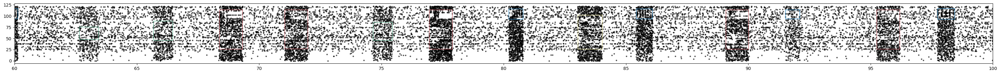

In [30]:
# ## load data back in to check it!

spikes_file = r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\"+ mouse_session_recording + "_background_noise_insertion_500.txt"

# spikes_file= json_["save_path"] + json_["output_filename"]+".txt"
print(spikes_file)
neuron_ids, spike_times= [], []
with open(spikes_file) as f:
    for (i, line) in enumerate(f.readlines()):
        [neuron_id, spike_time] = line.split(' ', 1)
        spike_time = eval(spike_time.split('\n')[0])
        neuron_id = eval(neuron_id.split('\t')[0])
        spike_times.append(spike_time)
        neuron_ids.append(neuron_id)
        
spikes_df = pd.DataFrame({'neuron':neuron_ids,'timestamp':spike_times}) 
        

# print(out_path +  "swapped_spikes_insertion_100" + "_swap_percentage_"+"_insertion_spike_profiles_" + str(today))
implanted_data = pd.read_pickle(out_path +  "background_noise_insertion_" + str(percentage)+"_spike_profiles_" + str(today))

# for loading color and order data from awake alignment 
region = 'striatum'
saved_data_path = os.path.join("Z:\projects\sequence_squad\organised_data\ppseq_analysis\ppseq_awake_analysis\plots\\" + mouse_session_recording, region) + '\\'

with open(os.path.join(os.path.join(PP_PATH,file) + r"\analysis_output\reordered_recolored\neuron_index"), "rb") as input_file:
    new_neuron_index = pickle.load(input_file)

    
# # for 8 seqs:



new_neuron_permute_loc = np.zeros(len(new_neuron_index))
for i in range(len(neuron_index)):
    new_neuron_permute_loc[i] = int(list(neuron_index).index(i))


fig,ax= plt.subplots(1, 1,figsize=(40, 2.5))


neuron_order_test = new_neuron_permute_loc[spikes_df.neuron.values.astype(int)-1]
ax.scatter(spikes_df.timestamp.values, neuron_order_test ,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)


col_ = []
rects = []
implanted_seq_types = []
all_implanted_rectangles = []
for index, seq_type in enumerate(implanted_data.seq_type.values):
    timestamps = implanted_data.inserted_profile[index].timestamp.values
    neurons = implanted_data.inserted_profile[index].neuron.values

    left = min(timestamps)
    right = max(timestamps)
    
    implanted_neuron_order = neuron_permute_loc[(neurons-1).astype(int)]
    top = max(implanted_neuron_order)
    bottom = min(implanted_neuron_order)
    
    col_ = colors[int(seq_type)]
    rects +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
    
for rect in rects:
    ax.add_patch(rect)


ax.set_xlim([60,100])

In [31]:
implanted_data.inserted_profile[0]

,neuron,timestamp,sequence_type,seq_confidence,sequence_type_adjusted
833,2,416.245014,5.0,0.47,-1.0
2190,4,416.127514,2.0,0.86,2.0
2191,4,416.140914,2.0,0.85,2.0
2192,4,416.145314,2.0,0.91,2.0
2193,4,416.469314,2.0,0.73,-1.0
...,...,...,...,...,...
132131,115,416.549114,5.0,0.74,-1.0
132132,115,416.644214,5.0,0.68,-1.0
136146,116,416.661314,5.0,0.86,5.0
140438,117,416.555014,2.0,0.82,2.0


In [115]:
len(["background_noise_insertion_10","background_noise_insertion_100","background_noise_insertion_20","background_noise_insertion_300","background_noise_insertion_40","background_noise_insertion_400","background_noise_insertion_500","background_noise_insertion_80","backwards_insertion","dropped_spikes_insertion_10","dropped_spikes_insertion_20","dropped_spikes_insertion_30","dropped_spikes_insertion_40","dropped_spikes_insertion_50","dropped_spikes_insertion_60","dropped_spikes_insertion_70","dropped_spikes_insertion_80","dropped_spikes_insertion_90","standard_insertion","swapped_spikes_insertion_10","swapped_spikes_insertion_100","swapped_spikes_insertion_20","swapped_spikes_insertion_30","swapped_spikes_insertion_40","swapped_spikes_insertion_50","swapped_spikes_insertion_60","swapped_spikes_insertion_70","swapped_spikes_insertion_80","swapped_spikes_insertion_90","warp_insertion0.03","warp_insertion0.1","warp_insertion0.2","warp_insertion0.5","warp_insertion10","warp_insertion2","warp_insertion20","warp_insertion30","warp_insertion5"])

38

In [2785]:
items = []
for item in os.listdir(r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\"):
    if ".txt" in item:       
        new = '"' + item[0:-4] + '"' + ','
        items += [new]

In [2788]:
a = ["178_1_7_background_noise_insertion_100","178_1_7_background_noise_insertion_20","178_1_7_background_noise_insertion_200","178_1_7_background_noise_insertion_300","178_1_7_background_noise_insertion_40","178_1_7_background_noise_insertion_400","178_1_7_background_noise_insertion_500","178_1_7_background_noise_insertion_80","178_1_7_backwards_insertion","178_1_7_blank_test","178_1_7_dropped_spikes_insertion_10","178_1_7_dropped_spikes_insertion_20","178_1_7_dropped_spikes_insertion_30","178_1_7_dropped_spikes_insertion_40","178_1_7_dropped_spikes_insertion_50","178_1_7_dropped_spikes_insertion_60","178_1_7_dropped_spikes_insertion_70","178_1_7_dropped_spikes_insertion_80","178_1_7_dropped_spikes_insertion_90","178_1_7_standard_insertion","178_1_7_swapped_spikes_insertion_10","178_1_7_swapped_spikes_insertion_100","178_1_7_swapped_spikes_insertion_20","178_1_7_swapped_spikes_insertion_30","178_1_7_swapped_spikes_insertion_40","178_1_7_swapped_spikes_insertion_50","178_1_7_swapped_spikes_insertion_60","178_1_7_swapped_spikes_insertion_70","178_1_7_swapped_spikes_insertion_80","178_1_7_swapped_spikes_insertion_90","178_1_7_warp_insertion0.03","178_1_7_warp_insertion0.1","178_1_7_warp_insertion0.2","178_1_7_warp_insertion0.5","178_1_7_warp_insertion10","178_1_7_warp_insertion2","178_1_7_warp_insertion20","178_1_7_warp_insertion30","178_1_7_warp_insertion5"]

In [669]:
len(a)

42

In [668]:
a = ["_blank_test","_backwards_insertion", "_standard_insertion","_background_noise_insertion_20","_background_noise_insertion_40","_background_noise_insertion_80","_background_noise_insertion_100","_background_noise_insertion_200","_background_noise_insertion_300","_background_noise_insertion_400","_background_noise_insertion_500","_dropped_spikes_insertion_10","_dropped_spikes_insertion_20","_dropped_spikes_insertion_30","_dropped_spikes_insertion_40","_dropped_spikes_insertion_50","_dropped_spikes_insertion_60","_dropped_spikes_insertion_70","_dropped_spikes_insertion_80","_dropped_spikes_insertion_85","_dropped_spikes_insertion_90","_dropped_spikes_insertion_95","_dropped_spikes_insertion_99","_swapped_spikes_insertion_10","_swapped_spikes_insertion_20","_swapped_spikes_insertion_30","_swapped_spikes_insertion_40","_swapped_spikes_insertion_50","_swapped_spikes_insertion_60","_swapped_spikes_insertion_70","_swapped_spikes_insertion_80","_swapped_spikes_insertion_90","_swapped_spikes_insertion_100","_warp_insertion0.03","_warp_insertion0.1","_warp_insertion0.2","_warp_insertion0.5","_warp_insertion2","_warp_insertion5","_warp_insertion10","_warp_insertion20","_warp_insertion30"]




In [2764]:
my_string = 'test'
new_string = '"' + item[0:-4] + '"'
print(new_string)


"178_1_7_background_noise_insertion_100"


In [2662]:
len(os.listdir(r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\"))

40

In [2772]:
new_string

'"178_1_7_background_noise_insertion_100"'

In [2753]:
item

214

In [2752]:
item[0:-4]

IndexError: invalid index to scalar variable.

In [2509]:
    
top
bottom
left
right

89.53846733668345

(60.0, 100.0)

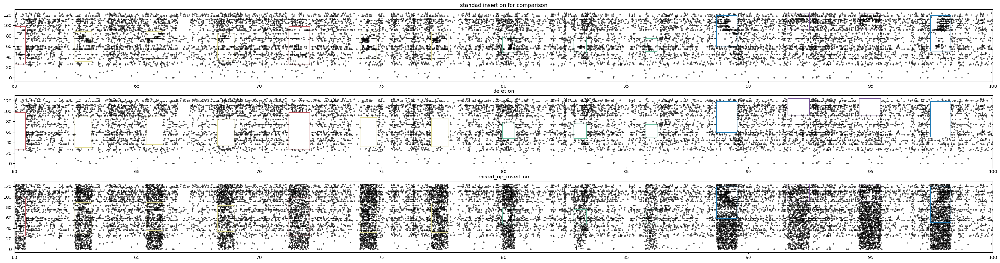

In [2644]:
# reload origional  out_df 
out_df = pd.read_pickle(out_path + "all_extracted_spike_profiles")


# shift chosen inds to new distributed places
for i,index in enumerate(chosen_inds):
    profile = out_df.spike_profiles[index]   
    relative_spike_times = out_df.spike_profiles[index].timestamp.values - min(out_df.spike_profiles[index].timestamp.values)
    out_df.spike_profiles[index]['timestamp'] = relative_spike_times + time_points[i]


permuted_spikes = unmasked_spikes_df.timestamp
permuted_neurons = np.random.permutation(unmasked_spikes_df.neuron.values)
permuted_neuron_order = neuron_permute_loc[permuted_neurons.astype(int)-1]

from matplotlib.patches import Rectangle

rects = []
rects2 = []
rects3 = []
for index in chosen_inds:
    
    profile = out_df.spike_profiles[index]    
    # Create a Rectangle patch
    top = max(out_df.neuron_order[index])
    bottom = min(out_df.neuron_order[index])
    left = min(profile.timestamp)
    right = max(profile.timestamp)
    
    col_ = colors[int(out_df.seq_type[index])]
    rects +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
    rects2 +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
    rects3 +=  [Rectangle((left, bottom), right-left, top-bottom, linewidth=1, edgecolor=col_, facecolor='none') ]
    
    
## then implant seqs
noise_added_spike_insertion = list(updated_spikes)
noise_added_neuron_insertion = list(updated_neurons)

standard_spike_insertion = list(updated_spikes)
standard_neuron_insertion = list(updated_neurons)

#save out for future plotting
seq_types = []
insertion_ids = []
profiles = []

for index in chosen_inds:
    profile = out_df.spike_profiles[index]  
    
    top = max(out_df.neuron_order[index])
    bottom = min(out_df.neuron_order[index])
    left = min(profile.timestamp)
    right = max(profile.timestamp)

    standard_spike_insertion +=  list(profile.timestamp.values)
    standard_neuron_insertion += list(profile.neuron.values)
    
    
    #add noise into all background cells - ie everything thats not involved in the sequence. add a certain number of spikes 

    n_neurons = len(np.unique(permuted_neurons))
    all_neurons = np.linspace(1,n_neurons,n_neurons)

    background_neurons=[]
    for neuron_ in all_neurons:
        if not neuron_ in profile.neuron.unique():
            background_neurons +=[int(neuron_)]
            
    iterations = int(len(profile.timestamp) * (percentage/100))
    
    for i in range(iterations):
        random_background_neuron = random.choice(background_neurons)
        random_spike_time = random.uniform(left, right)

        row = pd.DataFrame({'neuron': [random_background_neuron],
                'timestamp': [random_spike_time] ,
                'sequence_type_adjusted': ['implanted_noise'],
                 'sequence_type': ['implanted_noise'] ,
                 'seq_confidence': ['implanted_noise'] })

        profile= pd.concat([profile,row])
    
    noise_added_spike_insertion +=  list(profile.timestamp.values)
    noise_added_neuron_insertion += list(profile.neuron.values)
            
    # save out dropped out profile
    profiles += [profile]
    
    seq_types +=  [out_df.seq_type[index]]
    insertion_ids += [index]
    
background_noise_insertion_df = pd.DataFrame(
{'seq_type' : seq_types,
'insertion_id' : insertion_ids,
'inserted_profile': profiles})



fig,[ax1,ax2,ax3]= plt.subplots(3, 1,figsize=(40, 10))

# plot origonal
ax1.set_title('standad insertion for comparison')
permuted_neuron_order_new = neuron_permute_loc[np.array(standard_neuron_insertion).astype(int)-1]  

ax1.scatter(standard_spike_insertion, permuted_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)
for rect in rects:
    ax1.add_patch(rect)

# plot deleted
ax2.set_title('deletion')

delted_permuted_neuron_order_new = neuron_permute_loc[updated_neurons.astype(int)-1]

ax2.scatter(updated_spikes, delted_permuted_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)

# Add the patch to the Axes
for rect in rects2:
    ax2.add_patch(rect)




# # plot insertion
ax3.set_title('mixed_up_insertion')

noise_added_neuron_order_new = neuron_permute_loc[np.array(noise_added_neuron_insertion).astype(int)-1]

ax3.scatter(noise_added_spike_insertion, noise_added_neuron_order_new,marker = 'o', s=10, linewidth=0,color = 'black' ,alpha=0.7)
for rect in rects3:
    ax3.add_patch(rect)



ax1.set_xlim([60,100])
ax2.set_xlim([60,100])
ax3.set_xlim([60,100])

In [2618]:
## save out instertion data 

if not os.path.isdir(out_path):
    os.makedirs(out_path)
warp_insertion_df.to_pickle(out_path +  "background_noise_" + str(percentage)+ "_swap_percentage_"+"_insertion_spike_profiles_" + str(today))


type_ = 'background_noise_insertion_' + str(shuffle_percentage)

model_dir = r"Z:\projects\sequence_squad\organised_data\ppseq_data\prepared_data\synthetic_data\striatum\\" + type_ + '\\'
CHECK_FOLDER = os.path.isdir(model_dir)

# If folder doesn't exist, then create it.
if not CHECK_FOLDER:
    os.makedirs(model_dir)
    print("created folder : ", model_dir)

json_ = {'full_path_to_data': dat_path,
 'mouse_implant_recording': mouse_session_recording,
 'output_filename': mouse_session_recording,
 'save_path': model_dir,
 'time_span': [behav_time_interval_start],
 'single_or_multiunits': 'both',
 'region': 'striatum',
 'use_emmett_curation': False,
 'max_firing_rate': 15.0,
 'align_to_zero': True,
 'shuffle': 'None',
 'visualise': True,
 'min_fano_factor': 0.5,
 'max_fano_factor': 12,
 'number_of_neurons':N_neurons }

params_filename= save_params_as_json(json_, json_["save_path"], "params_"+json_["output_filename"]+".json")

spike_times = create_spike_time_vectors(np.array(reverse_spike_insertion),np.array(reverse_neuron_insertion))

data_filename = write_text_file(spikes=spike_times, filename= json_["save_path"] + json_["output_filename"]+".txt") 

print(f"    • data '.txt' file saved to:          {data_filename}")
print(f"    • parameters '.json' file saved to:   {params_filename}")

,neuron,timestamp,sequence_type_adjusted,sequence_type,seq_confidence
2947,2,89.359567,6.0,6.0,1.00
2948,2,89.306667,6.0,6.0,1.00
2949,2,89.302267,6.0,6.0,1.00
2950,2,89.293467,6.0,6.0,1.00
2951,2,89.283267,6.0,6.0,1.00
...,...,...,...,...,...
159343,125,89.133467,6.0,6.0,0.92
159344,125,89.106467,6.0,6.0,0.91
159345,125,89.050067,6.0,6.0,0.87
159346,125,89.000467,6.0,6.0,0.89


pandas.core.frame.DataFrame

In [1448]:
# build json

mouse_session_recording

'178_1_7'

In [1451]:
behav_time_interval_start

[5400, 6000]

In [1455]:
json

{'full_path_to_data': 'Z:\\projects\\sequence_squad\\organised_data\\animals\\\\EJT178_implant1\\recording7_30_03_2022',
 'mouse_implant_recording': '178_1_7',
 'output_filename': '178_1_7',
 'save_path': 'Z:\\projects\\sequence_squad\\organised_data\\ppseq_data\\prepared_data\\synthetic_data\\striatum\\\\',
 'time_span': [[5400, 6000]],
 'single_or_multiunits': 'both',
 'region': 'striatum',
 'use_emmett_curation': False,
 'max_firing_rate': 15.0,
 'align_to_zero': True,
 'shuffle': 'None',
 'visualise': True,
 'min_fano_factor': 0.5,
 'max_fano_factor': 12,
 'number_of_neurons': 125}

In [1389]:
{'full_path_to_data': 'Z:\\projects\\sequence_squad\\organised_data\\animals\\\\EJT238_implant1\\recording7_r6_L5013-12-2022',
 'mouse_implant_recording': '238_1_7',
 'output_filename': '238_1_7',
 'save_path': 'Z:\\projects\\sequence_squad\\organised_data\\ppseq_data\\prepared_data\\\\striatum\\Long_Awake\\',
 'time_span': [[4092, 5867]],
 'single_or_multiunits': 'both',
 'region': 'striatum',
 'use_emmett_curation': False,
 'max_firing_rate': 15.0,
 'align_to_zero': True,
 'shuffle': 'None',
 'visualise': True,
 'min_fano_factor': 0.5,
 'max_fano_factor': 12,
 'number_of_neurons': 51}

[99,
 93,
 95,
 11,
 98,
 10,
 43,
 40,
 112,
 83,
 64,
 122,
 43,
 113,
 109,
 64,
 98,
 121,
 112,
 122,
 78,
 116,
 116,
 112,
 35,
 123,
 40,
 29,
 59,
 42,
 111,
 9,
 118,
 65,
 31,
 113,
 99,
 60,
 10,
 16,
 7,
 30,
 102,
 102,
 65,
 114,
 23,
 108,
 31,
 71,
 49,
 114,
 9,
 95,
 25,
 107,
 108,
 29,
 109,
 114,
 122,
 113,
 111,
 95,
 74,
 113,
 58,
 64,
 121,
 113,
 93,
 114,
 98,
 58,
 113,
 102,
 51,
 31,
 33,
 107,
 56,
 114,
 11,
 64,
 42,
 112,
 114,
 103,
 15,
 36,
 57,
 87,
 91,
 99,
 31,
 16,
 74,
 64,
 54,
 108,
 116,
 114,
 114,
 95,
 38,
 112,
 109,
 44,
 34,
 112,
 98,
 8,
 26,
 60,
 111,
 98,
 113,
 30,
 112,
 113,
 42,
 95,
 62,
 2,
 86,
 31,
 16,
 113,
 93,
 46,
 65,
 31,
 40,
 122,
 96,
 121,
 122,
 106,
 95,
 118,
 93,
 116,
 103,
 40,
 43,
 80,
 121,
 112,
 10,
 103,
 51,
 55,
 116,
 2,
 121,
 113,
 123,
 73,
 8,
 9,
 107,
 98,
 10,
 114,
 36,
 113,
 114,
 31,
 113,
 114,
 34,
 99,
 42,
 75,
 95,
 13,
 70,
 105,
 56,
 114,
 103,
 96,
 49,
 9,
 98,
 98,
 8,
 13

'Z:\\projects\\sequence_squad\\organised_data\\animals\\\\EJT178_implant1\\recording7_30_03_2022'

In [1381]:
permuted_spikes[mask]

0         130.0120
1         170.5895
2         198.5397
3         209.6549
4         245.6716
            ...   
159421    597.6315
159422    597.7382
159423    599.1378
159424    599.6052
159425    599.7829
Name: timestamp, Length: 159239, dtype: float64

In [1374]:
profile.timestamp

4016      46.8585
5853      46.7978
5854      46.8262
5855      46.9169
7116      46.8134
           ...   
149697    46.7401
149698    46.7593
152703    46.7055
158444    46.6862
158445    46.8430
Name: timestamp, Length: 179, dtype: float64

In [1358]:
permuted_neurons[mask]

array([99, 93, 95, ..., 20, 71, 96], dtype=int64)

3045      553.5250
3046      553.5690
3047      553.6005
3048      553.6332
3049      553.6504
            ...   
159378    553.7087
159379    553.7111
159380    553.8646
159381    553.9713
159382    554.0009
Name: timestamp, Length: 358, dtype: float64

In [1338]:
mask

0         False
1         False
2         False
3         False
4         False
          ...  
159421    False
159422    False
159423    False
159424    False
159425    False
Name: timestamp, Length: 159426, dtype: bool

In [1320]:
# implant these into the noise: 



array([  1,   2,   3,   4,   6,   7,   8,  11,  13,  14,  15,  16,  18,
        20,  21,  22,  23,  24,  26,  27,  28,  29,  31,  33,  34,  35,
        37,  38,  39,  41,  42,  43,  44,  45,  46,  47,  49,  50,  51,
        53,  55,  57,  58,  59,  62,  63,  64,  66,  67,  68,  69,  70,
        71,  72,  73,  74,  75,  76,  77,  78,  79,  80,  81,  82,  83,
        84,  85,  87,  88,  89,  90,  91,  92,  93,  94,  95,  97,  99,
       100, 102, 103, 104, 105, 106, 107, 109, 110, 111, 112, 114, 115,
       116, 117, 118, 119, 121, 122, 127, 129, 130, 131, 132, 133, 134,
       135, 136, 137, 138, 139, 142, 143, 144, 146, 147, 148, 149, 150,
       151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163,
       164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176,
       177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189,
       190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202,
       203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 21

In [1325]:
left

553.5193

,neuron,timestamp,sequence_type_adjusted,sequence_type,seq_confidence
3045,2,553.5250,6.0,6.0,1.00
3046,2,553.5690,6.0,6.0,1.00
3047,2,553.6005,6.0,6.0,1.00
3048,2,553.6332,6.0,6.0,1.00
3049,2,553.6504,6.0,6.0,1.00
...,...,...,...,...,...
159378,125,553.7087,6.0,6.0,0.93
159379,125,553.7111,6.0,6.0,0.92
159380,125,553.8646,6.0,6.0,0.88
159381,125,553.9713,6.0,6.0,0.86


In [1283]:
random_idx

33

In [1276]:
indices_all[1]

array([66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82,
       83])

In [1284]:
arr

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51,
       52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65])

In [1255]:
# Define the list
lst = list(out_df.seq_type)

# Define the number of indices to select
num_indices = 200

# Determine the number of unique values in the list
num_groups = len(set(lst))

# Calculate the stride length based on the number of unique values and the desired number of indices
stride = max(len(lst) // num_indices, 1)

# Initialize a dictionary to keep track of the number of items selected from each group
group_counts = {val: 0 for val in set(lst)}

# Initialize a list to store the selected indices
selected_indices = []

# Iterate over the list and select an index every stride length
for i in range(0, len(lst), stride):
    # Check if all groups have been covered
    if len(group_counts) == num_groups:
        break
        
    # If not all groups have been covered, select the next index and update the group counts
    selected_indices.append(i)
    group_counts[lst[i]] += 1
    if group_counts[lst[i]] == len([val for val in lst if val == lst[i]]):
        del group_counts[lst[i]]

# If not all groups have been covered, select additional indices from the remaining groups
while len(selected_indices) < num_indices:
    for i, val in enumerate(lst):
        if i not in selected_indices and val in group_counts:
            selected_indices.append(i)
            group_counts[val] += 1
            if group_counts[val] == len([v for v in lst if v == val]):
                del group_counts[val]
            if len(selected_indices) == num_indices:
                break
    if len(group_counts) == 0:
        break

print(selected_indices)


[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199]


In [1256]:
stride

1

In [1239]:
group_sizes = (list(out_df.seq_type).count(1.0),list(out_df.seq_type).count(3.0),list(out_df.seq_type).count(4.0),list(out_df.seq_type).count(5.0),list(out_df.seq_type).count(6.0))
print(group_sizes)
# Calculate the weight of each group based on its size
weights = [size/sum(groups) for size in group_sizes]

# Initialize a list to store the selected items
selected_items = []

# Select items from each group based on its weight
for i, group_size in enumerate(group_sizes):
    num_items = round(weights[i] * total_items)
    selected_items += random.sample(range(1, group_size+1), num_items)

(66, 18, 62, 42, 48)


In [1252]:
import random

# Define the groups
groups = (list(out_df.seq_type).count(1.0),list(out_df.seq_type).count(3.0),list(out_df.seq_type).count(4.0),list(out_df.seq_type).count(5.0),list(out_df.seq_type).count(6.0))

# Define the total number of items to select
total_items = 200

# Calculate the weight of each group based on its size
weights = [size/sum(groups) for size in groups]

# Initialize a dictionary to store the selected items from each group
selected_items = {i: [] for i in range(len(groups))}

# Select items from each group based on its weight
for i, group_size in enumerate(groups):
    num_items = round(weights[i] * total_items)
    selected_items[i] = random.sample(range(1, group_size+1), num_items)

# Combine the selected items from all groups and shuffle the list
final_selection = []
for i in range(total_items):
    for j in range(len(groups)):
        if i < len(selected_items[j]):
            final_selection.append(selected_items[j][i]+groups[j])


print(final_selection)


[131, 32, 106, 50, 58, 112, 23, 74, 63, 70, 120, 36, 89, 72, 63, 91, 27, 78, 65, 80, 111, 30, 103, 67, 50, 110, 35, 68, 57, 65, 122, 33, 111, 62, 67, 123, 28, 67, 58, 77, 118, 24, 97, 55, 94, 87, 21, 86, 73, 57, 109, 34, 118, 69, 81, 94, 26, 124, 79, 72, 71, 20, 116, 68, 76, 103, 25, 117, 74, 86, 70, 31, 110, 66, 75, 99, 71, 78, 74, 83, 93, 60, 51, 100, 83, 53, 92, 119, 113, 81, 95, 86, 96, 76, 73, 80, 91, 64, 60, 77, 102, 82, 93, 78, 123, 75, 87, 68, 65, 56, 69, 69, 77, 61, 90, 84, 120, 49, 66, 106, 92, 83, 59, 108, 121, 44, 84, 104, 101, 80, 78, 121, 108, 70, 83, 127, 90, 51, 85, 97, 95, 71, 49, 126, 105, 84, 62, 102, 70, 59, 96, 124, 64, 54, 54, 113, 75, 46, 79, 79, 63, 88, 73, 112, 71, 107, 104, 55, 72, 109, 53, 115, 80, 68, 117, 66, 125, 100, 98, 82, 105, 76, 116, 88, 88, 107, 130, 122, 89, 114, 82, 85, 81, 99, 95, 79, 85, 84, 74, 101, 96]


In [1250]:
selected_items

{0: [2,
  62,
  47,
  7,
  11,
  51,
  60,
  20,
  46,
  33,
  35,
  23,
  59,
  64,
  49,
  65,
  6,
  29,
  32,
  53,
  15,
  43,
  13,
  42,
  36,
  40,
  24,
  30,
  54,
  55,
  27,
  48,
  45,
  52,
  56,
  50,
  25,
  28,
  26,
  3,
  10,
  39,
  19,
  5,
  44,
  21,
  8,
  34,
  66,
  31,
  58,
  37,
  63,
  61,
  14,
  41],
 1: [12, 5, 11, 10, 16, 14, 9, 6, 1, 4, 18, 8, 7, 13, 2],
 2: [35,
  2,
  9,
  30,
  46,
  16,
  33,
  6,
  50,
  26,
  15,
  41,
  57,
  5,
  40,
  42,
  18,
  28,
  10,
  1,
  7,
  21,
  14,
  58,
  34,
  11,
  4,
  56,
  22,
  12,
  48,
  54,
  29,
  24,
  43,
  23,
  45,
  47,
  60,
  13,
  52,
  62,
  39,
  55,
  36,
  49,
  3,
  32,
  27,
  8,
  59,
  20,
  37],
 3: [23,
  25,
  40,
  39,
  35,
  17,
  15,
  38,
  7,
  26,
  10,
  20,
  8,
  37,
  13,
  16,
  12,
  31,
  34,
  1,
  28,
  22,
  21,
  19,
  36,
  18,
  4,
  24,
  33,
  6,
  5,
  2,
  30,
  42,
  27,
  41],
 4: [46,
  45,
  37,
  12,
  5,
  32,
  16,
  28,
  31,
  41,
  22,
  35,
  27,
  

In [1227]:
permuted_spikes

0         130.0120
1         170.5895
2         198.5397
3         209.6549
4         245.6716
            ...   
159421    597.6315
159422    597.7382
159423    599.1378
159424    599.6052
159425    599.7829
Name: timestamp, Length: 159426, dtype: float64

In [1229]:
import random

groups = [19, 3, 23, 6, 11]
total_items = 50

# Calculate the weight of each group based on its size
weights = [size/sum(groups) for size in groups]

# Initialize a list to store the selected items
selected_items = []

# Select items from each group based on its weight
for i, group_size in enumerate(groups):
    num_items = round(weights[i] * total_items)
    selected_items += random.sample(range(1, group_size+1), num_items)

# If the number of selected items is less than total_items, select additional items from the largest group
while len(selected_items) < total_items:
    largest_group_index = groups.index(max(groups))
    selected_items.append(random.randint(1, groups[largest_group_index]))

print(selected_items)


[6, 8, 7, 9, 11, 4, 19, 18, 16, 17, 2, 14, 5, 3, 15, 1, 3, 20, 18, 4, 21, 10, 8, 12, 16, 23, 22, 17, 15, 9, 5, 2, 7, 13, 14, 19, 6, 5, 2, 4, 3, 7, 8, 11, 5, 1, 9, 10, 4, 2]


In [1450]:
    
behav_time_interval_start

[5400, 6000]

In [1218]:
permuted_neuron_order

array([ 38.,  87., 110., ..., 114.,  51.,   6.])

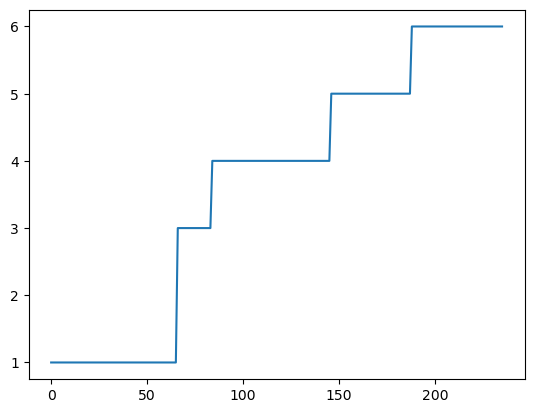

In [1190]:
plt.plot(out_df.seq_type)

In [1201]:
constant_firing_spike_times

array([130.012 , 170.5895, 198.5397, ..., 599.1378, 599.6052, 599.7829])

In [1202]:
consting_firing_neuron_order

array([110.,   6.,  63., ...,  80.,  47., 114.])

In [1200]:
out_df

,seq_type,midpoints,neuron_order,spike_profiles
0,1.0,13.8,"[75.0, 69.0, 26.0, 103.0, 103.0, 103.0, 103.0,...",neuron timestamp sequence_type_adjus...
1,1.0,16.6,"[75.0, 26.0, 103.0, 103.0, 103.0, 103.0, 103.0...",neuron timestamp sequence_type_adjus...
2,1.0,20.3,"[75.0, 75.0, 75.0, 75.0, 71.0, 71.0, 71.0, 103...",neuron timestamp sequence_type_adjus...
3,1.0,28.8,"[71.0, 55.0, 26.0, 99.0, 21.0, 103.0, 103.0, 1...",neuron timestamp sequence_type_adjus...
4,1.0,32.9,"[75.0, 71.0, 71.0, 103.0, 103.0, 103.0, 84.0, ...",neuron timestamp sequence_type_adjus...
...,...,...,...,...
231,6.0,497.9,"[93.0, 93.0, 93.0, 93.0, 93.0, 93.0, 93.0, 93....",neuron timestamp sequence_type_adjus...
232,6.0,512.3,"[93.0, 93.0, 93.0, 93.0, 93.0, 93.0, 93.0, 93....",neuron timestamp sequence_type_adjus...
233,6.0,521.0,"[93.0, 93.0, 93.0, 69.0, 69.0, 69.0, 69.0, 69....",neuron timestamp sequence_type_adjus...
234,6.0,538.0,"[93.0, 93.0, 93.0, 93.0, 93.0, 93.0, 93.0, 93....",neuron timestamp sequence_type_adjus...


In [1198]:
list(out_df.seq_type).count(6.0)

48

In [1029]:
### in a 600s timespan 
# implant 200 fake seqs 

# randomly insert seqs across the timespan. 







,seq_type,midpoints,neuron_order,spike_profiles
0,1,13.8,"[75.0, 69.0, 26.0, 103.0, 103.0, 103.0, 103.0,...",neuron timestamp sequence_type_adjus...
1,1,16.6,"[75.0, 26.0, 103.0, 103.0, 103.0, 103.0, 103.0...",neuron timestamp sequence_type_adjus...
2,1,20.3,"[75.0, 75.0, 75.0, 75.0, 71.0, 71.0, 71.0, 103...",neuron timestamp sequence_type_adjus...
3,1,28.8,"[71.0, 55.0, 26.0, 99.0, 21.0, 103.0, 103.0, 1...",neuron timestamp sequence_type_adjus...
4,1,32.9,"[75.0, 71.0, 71.0, 103.0, 103.0, 103.0, 84.0, ...",neuron timestamp sequence_type_adjus...
...,...,...,...,...
61,1,500.8,"[75.0, 75.0, 71.0, 26.0, 103.0, 84.0, 84.0, 84...",neuron timestamp sequence_type_adjus...
62,1,545.6,"[71.0, 71.0, 26.0, 103.0, 103.0, 103.0, 103.0,...",neuron timestamp sequence_type_adjus...
63,1,549.7,"[75.0, 75.0, 71.0, 69.0, 69.0, 26.0, 26.0, 103...",neuron timestamp sequence_type_adjus...
64,1,557.2,"[26.0, 26.0, 103.0, 56.0, 36.0, 36.0, 102.0, 4...",neuron timestamp sequence_type_adjus...


In [1011]:
out_df

,seq_type,midpoints,neuron_order,spike_profiles
0,4.0,2.4,"[75.0, 71.0, 26.0, 26.0, 80.0, 80.0, 80.0, 80....",neuron timestamp sequence_type_adjus...
1,4.0,16.0,"[75.0, 75.0, 75.0, 69.0, 26.0, 26.0, 103.0, 10...",neuron timestamp sequence_type_adjus...
2,4.0,19.6,"[66.0, 75.0, 75.0, 62.0, 80.0, 80.0, 80.0, 80....",neuron timestamp sequence_type_adjus...
3,4.0,22.4,"[75.0, 75.0, 122.0, 80.0, 80.0, 80.0, 80.0, 80...",neuron timestamp sequence_type_adjus...
4,4.0,28.0,"[103.0, 80.0, 80.0, 80.0, 120.0, 120.0, 68.0, ...",neuron timestamp sequence_type_adjus...
...,...,...,...,...
71,4.0,549.1,"[103.0, 84.0, 62.0, 46.0, 65.0, 80.0, 80.0, 80...",neuron timestamp sequence_type_adjus...
72,4.0,552.2,"[71.0, 103.0, 36.0, 36.0, 62.0, 80.0, 80.0, 80...",neuron timestamp sequence_type_adjus...
73,4.0,556.3,"[71.0, 26.0, 26.0, 26.0, 62.0, 62.0, 80.0, 80....",neuron timestamp sequence_type_adjus...
74,4.0,559.8,"[71.0, 55.0, 26.0, 62.0, 80.0, 80.0, 80.0, 80....",neuron timestamp sequence_type_adjus...


In [1012]:
out_df

,seq_type,midpoints,neuron_order,spike_profiles
0,4.0,2.4,"[75.0, 71.0, 26.0, 26.0, 80.0, 80.0, 80.0, 80....",neuron timestamp sequence_type_adjus...
1,4.0,16.0,"[75.0, 75.0, 75.0, 69.0, 26.0, 26.0, 103.0, 10...",neuron timestamp sequence_type_adjus...
2,4.0,19.6,"[66.0, 75.0, 75.0, 62.0, 80.0, 80.0, 80.0, 80....",neuron timestamp sequence_type_adjus...
3,4.0,22.4,"[75.0, 75.0, 122.0, 80.0, 80.0, 80.0, 80.0, 80...",neuron timestamp sequence_type_adjus...
4,4.0,28.0,"[103.0, 80.0, 80.0, 80.0, 120.0, 120.0, 68.0, ...",neuron timestamp sequence_type_adjus...
...,...,...,...,...
71,4.0,549.1,"[103.0, 84.0, 62.0, 46.0, 65.0, 80.0, 80.0, 80...",neuron timestamp sequence_type_adjus...
72,4.0,552.2,"[71.0, 103.0, 36.0, 36.0, 62.0, 80.0, 80.0, 80...",neuron timestamp sequence_type_adjus...
73,4.0,556.3,"[71.0, 26.0, 26.0, 26.0, 62.0, 62.0, 80.0, 80....",neuron timestamp sequence_type_adjus...
74,4.0,559.8,"[71.0, 55.0, 26.0, 62.0, 80.0, 80.0, 80.0, 80....",neuron timestamp sequence_type_adjus...


In [941]:
final_filtered_group_neuron_orders

array([array([ 75.,  69., 103., 103., 103., 103., 103.,  36.,  80.,  80.,  80.,
               80.,  80.,  80.,  80.,  80.,  80.,  80.,  80.,  80.,  80.,  80.,
               87.,  87.,  52.,  79.,  79.,  45.,  68., 105.,  73., 117.,  29.,
               29.,  27.,  27.,  27.,  27.,  27.,  27.,  27.,  27.,  27.,  27.,
               27.,  27.,  27.,  34.,  34.,  33.,  33.,  33.,  33., 113., 113.,
               70.,  70., 115.,  42.,  24.,  28.,  28.,  28., 106., 106.,  23.,
               35.,  35.,  35.,  35.,  35.,  35.,  35.,  35.,  35.,  35.,  35.,
              108.,  86.,  86.,  54.,  61.,  61., 101.,  64.,  97.,  51.,  51.,
               51.,  49., 110., 110., 110., 110., 110., 110., 110., 110., 110.,
              110., 110., 110., 110., 110., 110., 110., 110., 110., 110.,  30.,
               30.,  30.,  30.,  30.,  30.,  30.,  30.,  30.,  30.,  30.,  30.,
               30.,  30.,  30.,  30., 114., 114., 114., 114., 114., 114., 114.,
              114., 114., 114., 116., 11

In [ ]:
##### just take 25 -75% of the data (not too many spikes and not too few)

# plot some of these ontop of each other and draw selection box 

# do this for all seqs 

# randomly extract these boxes from the chosen timepoints

# insert them into noise (fr matched data)

# save out exact locations of implanted data so I can see if ppseq finds them later 

# run ppseq sleep on this! 


#manipulate these extacted boxes in different ways to create other datasets 



C:\Users\Emmett\AppData\Local\Temp\ipykernel_3308\3152262265.py:2: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  final_filtered_group_spike_profiles = np.array(group_spike_profiles)[filter_mask]


In [756]:
spikes_to_background = []
spikes_to_other = []

### apply box filters.... 
for i in range(len(filtered_groups)):

    # spikemask
    timeframe = [(filtered_groups[0][0] * bin_size)+remainder1,(filtered_groups[0][-1] * bin_size)-remainder2]
    
    
    

    # mask for spike times and for neurons
    mask1 = (unmasked_spikes_df.timestamp>timeframe[0])*(unmasked_spikes_df.timestamp<timeframe[-1])
    mask2 = [x in neurons_to_keep.astype(int) for x in unmasked_spikes_df[mask].neuron]

    unmasked_spikes_df[mask][mask2].sequence_type_adjusted

    background_mask = unmasked_spikes_df[mask][mask2].sequence_type_adjusted < 0 
    seq_spike_mask = unmasked_spikes_df[mask][mask2].sequence_type_adjusted > 0 



    seq_types_present = list(unmasked_spikes_df[mask][mask2][seq_spike_mask].sequence_type_adjusted.values.astype(int))
    background_spikes = len(unmasked_spikes_df[mask][mask2][background_mask].timestamp)
    seq_spikes = seq_types_present.count(i)
    other_seqs = len(seq_types_present) - seq_types_present.count(i)

    spikes_to_background +=[seq_spikes/background_spikes]
    spikes_to_other +=[seq_spikes/other_seqs]

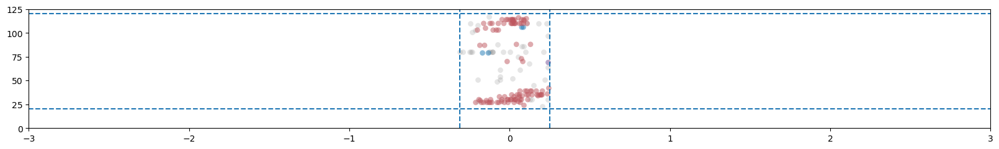

In [720]:
unmasked_spikes_df[mask1].neuron

4680        7
7014        9
13909      14
14228      16
14229      16
         ... 
149593    121
149594    121
152542    122
152543    122
152544    122
Name: neuron, Length: 157, dtype: int64

In [730]:
unmasked_spikes_df[mask1][30:40]

,neuron,timestamp,sequence_type_adjusted,sequence_type,seq_confidence
46396,52,13.6494,1.0,1.0,0.80
48891,55,13.8736,1.0,1.0,0.85
53528,59,13.6720,-1.0,1.0,0.50
55704,61,13.6164,1.0,1.0,0.93
55705,61,13.6550,1.0,1.0,0.95
57623,65,13.5882,1.0,1.0,0.98
57624,65,13.6234,1.0,1.0,1.00
57625,65,13.6364,1.0,1.0,1.00
57626,65,13.6581,1.0,1.0,1.00
57627,65,13.6702,1.0,1.0,1.00


In [729]:
unmasked_spikes_df[mask1][mask2][30:40]

,neuron,timestamp,sequence_type_adjusted,sequence_type,seq_confidence
46396,52,13.6494,1.0,1.0,0.80
55704,61,13.6164,1.0,1.0,0.93
55705,61,13.6550,1.0,1.0,0.95
57623,65,13.5882,1.0,1.0,0.98
57624,65,13.6234,1.0,1.0,1.00
57625,65,13.6364,1.0,1.0,1.00
57626,65,13.6581,1.0,1.0,1.00
57627,65,13.6702,1.0,1.0,1.00
57628,65,13.6777,1.0,1.0,1.00
57629,65,13.6888,1.0,1.0,1.00


In [710]:
neuron_permute_loc[ylims[0]:ylims[-1]]


array([  1.,  58.,  77.,  41.,  62., 102.,  46.,  22., 122.,  65.,  80.,
        15.,  60.,  32.,  98.,  57., 120.,  95.,  67.,  87.,   8.,  47.,
        52.,  79.,  76.,  45.,  11.,  20.,  68.,   7.,  91., 105., 100.,
        72.,  73., 111.,  25.,  48., 117.,  90.,  29.,  10., 119., 118.,
        27., 121.,  34.,  33.,  85., 113., 109.,  70., 115.,  42.,  31.,
        24.,  28., 124.,  40., 106.,  43.,  37.,  38.,   2.,  23., 123.,
        35.,  89., 104.,  81., 108.,  78.,  86.,  12.,  54.,  92.,  14.,
        61., 101.,  64.,   4.,  97.,  51.,   6.,  50.,  53.,  49.,  96.,
        44.,  13.,  63., 110.,  30., 114., 107., 116.,  16., 112.,   9.,
        17.])

In [727]:
neuron_permute_loc

array([ 19.,  93.,  59.,  18.,  66.,  74.,  75.,  71.,  69.,  55.,  26.,
         3.,  99.,   0.,  21., 103.,   5.,  56.,  84.,  36.,   1.,  58.,
        77.,  41.,  62., 102.,  46.,  22., 122.,  65.,  80.,  15.,  60.,
        32.,  98.,  57., 120.,  95.,  67.,  87.,   8.,  47.,  52.,  79.,
        76.,  45.,  11.,  20.,  68.,   7.,  91., 105., 100.,  72.,  73.,
       111.,  25.,  48., 117.,  90.,  29.,  10., 119., 118.,  27., 121.,
        34.,  33.,  85., 113., 109.,  70., 115.,  42.,  31.,  24.,  28.,
       124.,  40., 106.,  43.,  37.,  38.,   2.,  23., 123.,  35.,  89.,
       104.,  81., 108.,  78.,  86.,  12.,  54.,  92.,  14.,  61., 101.,
        64.,   4.,  97.,  51.,   6.,  50.,  53.,  49.,  96.,  44.,  13.,
        63., 110.,  30., 114., 107., 116.,  16., 112.,   9.,  17.,  39.,
        88.,  83.,  82.,  94.])

In [673]:
timeframe

[13.490000000000023, 14.049999999999978]

In [651]:
background_spikes

38

In [592]:
background_keep_mask = unmasked_spikes_df[mask].sequence_type_adjusted <= 0
background_spikes = len(unmasked_spikes_df[mask][background_keep_mask].timestamp)


background_remove_mask = unmasked_spikes_df[mask].sequence_type_adjusted >= 0
seq_types_present = list(unmasked_spikes_df[mask][background_remove_mask].sequence_type_adjusted.values.astype(int))
spikes = unmasked_spikes_df[mask][background_remove_mask].timestamp

break

seq_spikes = seq_types_present.count(i)
other_seqs = len(seq_types_present) - seq_types_present.count(i)

0.35000000000002274
0.35000000000002274
0.35000000000002274
0.35000000000002274
0.35000000000002274
0.35000000000002274
0.35000000000002274


In [633]:
unmasked_spikes_df

-1

In [ ]:
neurons_to_keep = neuron

ylims

array([  1,  58,  77,  41,  62, 102,  46,  22, 122,  65,  80,  15,  60,
        32,  98,  57, 120,  95,  67,  87,   8,  47,  52,  79,  76,  45,
        11,  20,  68,   7,  91, 105, 100,  72,  73, 111,  25,  48, 117,
        90,  29,  10, 119, 118,  27, 121,  34,  33,  85, 113, 109,  70,
       115,  42,  31,  24,  28, 124,  40, 106,  43,  37,  38,   2,  23,
       123,  35,  89, 104,  81, 108,  78,  86,  12,  54,  92,  14,  61,
       101,  64,   4,  97,  51,   6,  50,  53,  49,  96,  44,  13,  63,
       110,  30, 114, 107, 116,  16, 112,   9,  17])

In [603]:
neurons_to_keep = neuron_permute_loc[ylims[0]:ylims[-1]]

unmasked_spikes_df[mask].

,neuron,timestamp,sequence_type,seq_confidence,sequence_type_adjusted
4680,7,13.8539,6.0,0.59,-1.0
7014,9,14.0407,5.0,0.79,5.0
13909,14,13.7376,1.0,0.47,-1.0
14228,16,13.5873,1.0,0.72,-1.0
14229,16,13.5988,1.0,0.79,1.0
...,...,...,...,...,...
149593,121,13.9661,1.0,0.93,1.0
149594,121,14.0042,1.0,0.96,1.0
152542,122,13.7234,1.0,0.64,-1.0
152543,122,13.8422,1.0,0.82,1.0


In [ ]:
# throw out any where the neuron to background or neuron to other seq ratio is bad...,

for ind in range(len(filtered_groups)):
    
    ind = 10

    # spikemask
    timeframe = [(filtered_groups[ind][0] * bin_size),(filtered_groups[ind][-1] * bin_size)]


    # plot background in grey 
    mask = (unmasked_spikes_df.timestamp>timeframe[0])*(unmasked_spikes_df.timestamp<timeframe[-1])
    background_keep_mask = unmasked_spikes_df[mask].sequence_type_adjusted <= 0
    background_spikes = len(unmasked_spikes_df[mask][background_keep_mask].timestamp)


    background_remove_mask = unmasked_spikes_df[mask].sequence_type_adjusted >= 0
    seq_types_present = list(unmasked_spikes_df[mask][background_remove_mask].sequence_type_adjusted.values.astype(int))
    spikes = unmasked_spikes_df[mask][background_remove_mask].timestamp
    
    break

    seq_spikes = seq_types_present.count(i)
    other_seqs = len(seq_types_present) - seq_types_present.count(i)

In [ ]:
## run this for all seqs
## plot all box filters on exmaple timeseries 

In [ ]:
### 

In [485]:
unmasked_spikes_df[mask][background_keep_mask].timestamp - mid_point_time, neuron_order[mask][background_keep_mask]

(5441      381.2729
 6609      380.8701
 6610      381.0591
 6611      381.2047
 6612      381.5084
             ...   
 156814    381.6477
 156815    381.9647
 158005    380.8987
 158006    381.6373
 159102    381.1012
 Name: timestamp, Length: 146, dtype: float64,
 array([ 75.,  71.,  71.,  71.,  71.,  71.,  69.,  26.,  56.,  58.,  41.,
         62.,  62.,  80.,  80.,  80.,  80.,  80.,  80.,  60.,  60.,  32.,
         32.,  67.,  67.,   8.,   8.,   8.,  52.,  52.,  79.,  79.,  79.,
         79.,  79.,  79.,  79.,  79.,  79.,  79.,  79.,  76.,  76.,  20.,
         20.,  72.,  72.,  72.,  90.,  90.,  90.,  90.,  90.,  90.,  90.,
         90.,  90.,  90.,  90.,  90.,  90.,  90.,  90.,  90.,  33.,  70.,
         70.,  70.,  28.,  28., 124., 124.,  38.,  38.,  38.,  23., 104.,
        104., 104.,  81.,  86.,  86.,  54.,  54.,  92.,  92.,  92.,  92.,
         92.,  92.,  92.,  92.,  92.,  92.,  92.,  92.,  61., 101.,  64.,
         97.,  97.,  97.,  97.,  97.,  97.,  97.,  51.,  51.,  51.,

In [486]:
mid_point_time

19.6

In [453]:
(filtered_groups[test][0] * bin_size)-0.5 - mid_point_time

-1.1000000000000227

In [449]:
((filtered_groups[test][0] * bin_size)-0.5)

327.5

In [439]:
min(unmasked_spikes_df[mask][background_remove_mask].timestamp)

192.9558

In [447]:
mid_point_time

0.10000000000002274

[26,
 62,
 1,
 58,
 1,
 1,
 1,
 113,
 1,
 1,
 86,
 1,
 80,
 1,
 55,
 85,
 157,
 5,
 16,
 76,
 90,
 2,
 1,
 97,
 90,
 189,
 103,
 103,
 59,
 145,
 123,
 1,
 113,
 92,
 64,
 71,
 181,
 126,
 15,
 4,
 78,
 1,
 27,
 160,
 2,
 185,
 1,
 145,
 1,
 1,
 64,
 81,
 6,
 129,
 163,
 1,
 5,
 1,
 90,
 3,
 5,
 1,
 124,
 2,
 1,
 74,
 128,
 106,
 49,
 140,
 62,
 1,
 1,
 63,
 1,
 109,
 2,
 2,
 2,
 2,
 3,
 149,
 54,
 283,
 1,
 1,
 131,
 120,
 70,
 193,
 122,
 90,
 90,
 97,
 129,
 1,
 69,
 120,
 122,
 72,
 4,
 1,
 84,
 82,
 132,
 10,
 164,
 1,
 166,
 1,
 117,
 135,
 9,
 120,
 88,
 108,
 283,
 2,
 2,
 111,
 117,
 99,
 121,
 127,
 16,
 1,
 340,
 218,
 207,
 1,
 113,
 94,
 131,
 65,
 158,
 177,
 108,
 113,
 1,
 99,
 154,
 1,
 126,
 6,
 2,
 256,
 1,
 156,
 148,
 27,
 102,
 1,
 1,
 1,
 102,
 135,
 1,
 13,
 178,
 4,
 1,
 120,
 119,
 9,
 5,
 225,
 4,
 219,
 13,
 1,
 331,
 1,
 207,
 146,
 12,
 151,
 66,
 67,
 1,
 132,
 170,
 2,
 1,
 286,
 8,
 170,
 282,
 2,
 3,
 232,
 208,
 122,
 4,
 1,
 102,
 89,
 3,
 144,
 161,

In [359]:
spikes_per_group

[26]

(array([178.,   3.,   7.,   4.,   9.,   3.,   5.,   2.,   1.,   2.]),
 array([  0. ,  30.9,  61.8,  92.7, 123.6, 154.5, 185.4, 216.3, 247.2,
        278.1, 309. ]),
 <BarContainer object of 10 artists>)

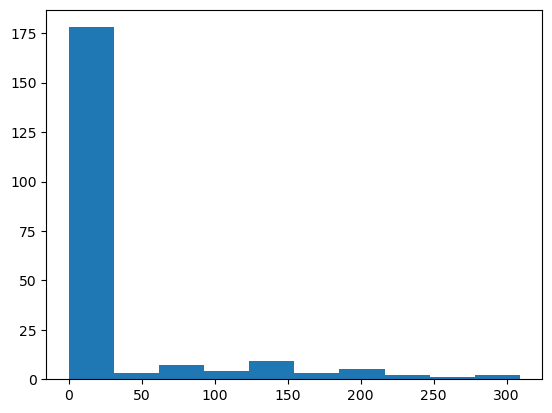

In [314]:
.sequence_type_adjusted.values.astype(i

In [306]:
group

(2995, 2996)

In [289]:
spikes_present

array([6, 6, 6, 6, 1, 6, 6, 1, 1, 1, 1, 1, 1, 1, 1, 1, 6, 6, 1, 1, 6, 6,
       6, 6, 6, 6, 6, 6, 6, 1, 1, 1, 1, 1, 6, 1, 1, 1, 6, 6])

In [ ]:
ax1.scatter(unmasked_spikes_df[mask][background_remove_mask].timestamp, neuron_order[mask][background_remove_mask],marker = 'o', s=20, linewidth=0,color = c_ ,alpha=1)

In [276]:
for groups

[(0, 2),
 (13, 18),
 (20, 20),
 (28, 30),
 (32, 32),
 (60, 60),
 (63, 63),
 (67, 71),
 (73, 73),
 (79, 79),
 (81, 85),
 (97, 97),
 (99, 104),
 (108, 108),
 (113, 117),
 (142, 146),
 (162, 167),
 (187, 189),
 (192, 193),
 (197, 201),
 (213, 218),
 (226, 226),
 (229, 229),
 (232, 235),
 (247, 251),
 (281, 286),
 (297, 301),
 (314, 318),
 (336, 340),
 (374, 380),
 (393, 398),
 (408, 408),
 (411, 415),
 (427, 431),
 (443, 446),
 (458, 462),
 (484, 490),
 (499, 504),
 (511, 512),
 (514, 514),
 (518, 521),
 (523, 523),
 (550, 552),
 (554, 558),
 (562, 562),
 (569, 574),
 (587, 587),
 (590, 594),
 (596, 596),
 (598, 598),
 (606, 610),
 (621, 624),
 (632, 633),
 (636, 640),
 (681, 685),
 (687, 687),
 (689, 690),
 (693, 693),
 (697, 698),
 (700, 700),
 (711, 711),
 (713, 713),
 (716, 720),
 (725, 725),
 (728, 728),
 (730, 734),
 (767, 771),
 (781, 783),
 (785, 791),
 (831, 836),
 (847, 850),
 (852, 852),
 (867, 867),
 (869, 872),
 (877, 877),
 (887, 891),
 (919, 920),
 (923, 923),
 (942, 942),


['---',
 '#BE575F',
 '#69BD9D',
 '#E2DC92',
 '#1C79B5',
 '#724F94',
 '#C6963E',
 '#264999']

In [266]:
colors[i+1]

'#C6963E'

In [253]:
N_neurons= bkgd_log_proportions_array.shape[1]

marker_rows = latent_event_history_df.loc[latent_event_history_df['seq_type']==-1.0]
seperators = marker_rows.index
num_iters = seperators.size
sequence_events = latent_event_history_df.iloc[marker_rows.iloc[-2].name + 1 : -1, : ]
sequence_type, sequence_times = sequence_events["seq_type"].to_numpy().astype(int), sequence_events["timestamp"].to_numpy()
print(sequence_events)

colordict = {
             1:  red, 
             2:  green,
             3:  yellow,
             4:  blue,
             5:  purple,
             6:  gold,
             7:  dark_blue,
             'background' : "black",
             -1: "black"
             }

red,green,yellow,blue,purple,gold,dark_blue


colors = np.empty(unmasked_spikes_df.size).astype(str)
neuron_spike_division = np.zeros((N_neurons,6 + 1))
k = 1 # Larger equals less print statements
print_points = np.linspace(0,1,int(100/k))*len(unmasked_spikes_df)
print_counter = 0
for spike in range(len(unmasked_spikes_df)): 
    assignment = assignment_history_df.iloc[spike,-1]
    neuron_id = int(unmasked_spikes_df.iloc[spike,0] - 1)
    if assignment == -1: 
        seq_type = -1
    else: 
        seq_type = int(sequence_events['seq_type'].loc[sequence_events['assignment_id'] == assignment].values[0])
    
    neuron_spike_division[neuron_id,int(seq_type)-1] += 1
    colors[spike] = colordict[seq_type]
    
    # Print every % done
    if spike > print_points[print_counter]:
        print(str(print_counter*k) + '%\t',end='')
        print_counter = print_counter + 1

        assignment_id   timestamp  seq_type  seq_warp   amplitude
677858            1.0   41.139655       5.0       1.0  201.976278
677859            2.0   28.555568       4.0       1.0   18.205673
677860            3.0   19.762473       4.0       1.0   88.334788
677861            4.0    1.423745       5.0       1.0    4.903351
677862            5.0    7.740003       3.0       1.0  136.689906
...               ...         ...       ...       ...         ...
679686         1829.0  577.787011       4.0       1.0   13.245541
679687         1830.0  593.883886       6.0       1.0   10.669645
679688         1831.0  586.644734       4.0       1.0   17.132559
679689         1832.0  590.366349       2.0       1.0   11.953080
679690         1833.0  572.734233       5.0       1.0    2.944672

[1833 rows x 5 columns]
0%	1%	2%	3%	4%	5%	6%	7%	8%	9%	10%	11%	12%	13%	14%	15%	16%	17%	18%	19%	20%	21%	22%	23%	24%	25%	26%	27%	28%	29%	30%	31%	32%	33%	34%	35%	36%	37%	38%	39%	40%	41%	42%	43%	44%	45%	46%	47%	4

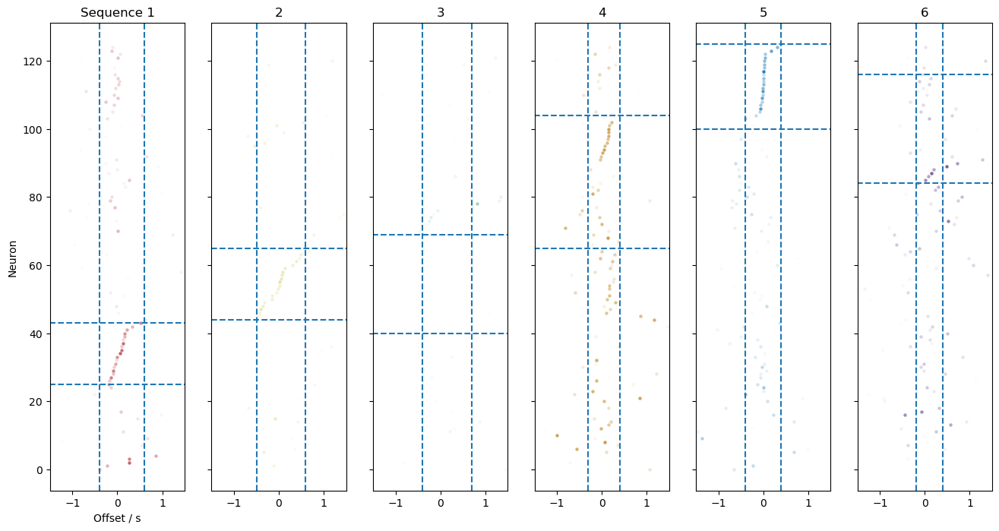

In [254]:
neworder_byeye = [0,2,1,5,3,4]

N_neurons= bkgd_log_proportions_array.shape[1]
lastIter_neurResp = neuron_response_df.iloc[-N_neurons:]

plotdata = lastIter_neurResp.to_numpy()

fig, ax = plt.subplots(1,6,figsize=(16,8),sharey=True)

approx_seq_interval = np.array([[-0.4, 0.6],
                                [-0.5, 0.6],
                                [-0.4, 0.7],
                                [-0.3, 0.4],
                                [-0.4, 0.4],
                                [-0.2, 0.4]])

involved_neurons = np.array([[25, 43],
                             [44, 65],
                             [40, 69],
                             [65, 104],
                             [100, N_neurons],
                             [84, 116]])

for i in range(6):
    weights = np.exp(plotdata[:,i])
    weights = np.abs(weights)/max(weights)
    #weights = weights**(1/2)
    for neuron in range(N_neurons):
        #ax[i].scatter(plotdata[neuron,neworder_byeye[i]+5],neuron_permute_loc[neuron],c=colordict[float(neworder_byeye[i]+1)],alpha=weights[neuron],s=1)
        ax[i].scatter(plotdata[neuron,neworder_byeye[i]+6],neuron_permute_loc[neuron],c=colordict[float(neworder_byeye[i]+1)],alpha=neuron_spike_division[neuron,neworder_byeye[i]]/np.sum(neuron_spike_division[neuron,:]),s=10,linewidths=0)
#         ax[i].scatter(plotdata[neuron,neworder_byeye[i]+6],neuron_permute_loc[neuron],c=colordict[float(neworder_byeye[i]+1)],s=10,linewidths=0)
    ax[i].set_xlim([-1.5,1.5])
    lim = approx_seq_interval[i, :]
    n_envolved = involved_neurons[i, :]
    
    ax[i].axvline(lim[0], ymin=0, ymax=N_neurons, linestyle="--")
    ax[i].axvline(lim[1], ymin=0, ymax=N_neurons, linestyle="--")
    
    ax[i].axhline(n_envolved[0], xmin=-1.5, xmax=1.5, linestyle="--")
    ax[i].axhline(n_envolved[1], xmin=-1.5, xmax=1.5, linestyle="--")
    
    if i == 0: 
        ax[i].set_title("Sequence %g" %int(i+1))
        ax[i].set_xlabel("Offset / s")
        ax[i].set_ylabel("Neuron")
    else:
        ax[i].set_title("%g" %int(i+1))

In [248]:
# decide which sequences to take forward. 


In [249]:
def squared_kernel(time_axis, sequence_time, square_limit=np.array([-0.5, 0.5]), amp=1.0):
    n_points = len(time_axis)
    values = np.zeros(shape=n_points)
    within_square = np.logical_and(time_axis > sequence_time+square_limit[0], 
                                   time_axis < sequence_time+square_limit[1])
    values[within_square] = amp
    return values

def get_target_sequence_type(time_span, n_points, sequence_times, sequence_type, 
                             kernel_function, approx_seq_interval):
    
    n_sequences = len(np.unique(sequence_type))
    time_axis = np.linspace(time_span[0], time_span[1], num=n_points)
    out_signal = np.zeros(shape=(n_sequences, n_points))
    
    for i in range(n_sequences):
        square_lim = approx_seq_interval[i, :]
        times_for_seq_i = sequence_times[sequence_type==i+1]
        for s_time in times_for_seq_i:
            out_signal[i, :] = out_signal[i, :] + kernel_function(time_axis, s_time, square_limit=square_lim)
    out_signal = np.clip(out_signal, a_min=0, a_max=1)
    return time_axis, out_signal.astype(np.float32)

In [250]:
# This must match the input size for later training
n_points = 5000
time_span = [0, 300]


# I need to fix this to match the order or remove the order
inv_approx_seq_interval = np.flip(approx_seq_interval, axis=0)
aux = np.copy(inv_approx_seq_interval[-2, :])
inv_approx_seq_interval[-2, :] = np.copy(inv_approx_seq_interval[-1, :])
inv_approx_seq_interval[-1, :] = aux
#######################################
inv_involved_neurons = np.flip(involved_neurons, axis=0)
aux = np.copy(inv_involved_neurons[-2, :])
inv_involved_neurons[-2, :] = np.copy(inv_involved_neurons[-1, :])
inv_involved_neurons[-1, :] = aux
#######################################

seq_interval = dict(zip(np.unique(sequence_type), inv_approx_seq_interval))
seq_involved_neurons = dict(zip(np.unique(sequence_type), inv_involved_neurons))

time_axis, out_signal = get_target_sequence_type(time_span, n_points, sequence_times, sequence_type, 
                                                 squared_kernel, inv_approx_seq_interval)

C:\Users\Emmett\AppData\Local\Temp\ipykernel_3308\182121480.py:25: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  centroids = np.array(centroids)


(50.0, 100.0)

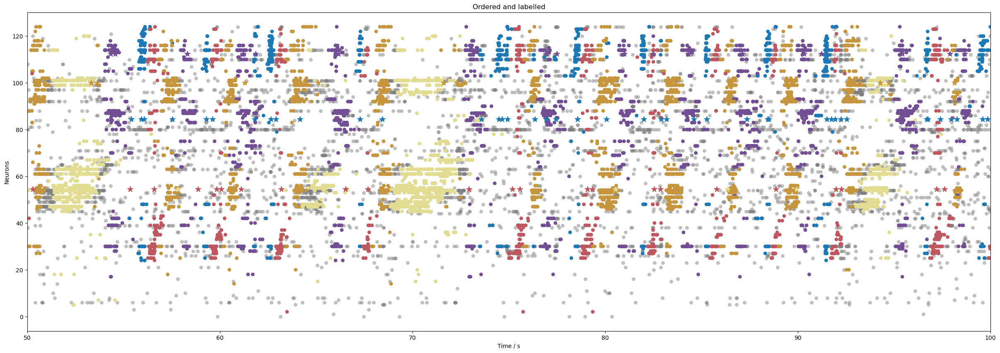

In [251]:
timeframe = [50,100]
#mask
# spikemask
mask = (unmasked_spikes_df.timestamp>timeframe[0])*(unmasked_spikes_df.timestamp<timeframe[-1])

fig, ax = plt.subplots(1, 1,figsize=(30, 10))

colors = ['---',red,green,yellow,blue,purple,gold,dark_blue]
1 ### plot ordered ppseq spikes as above:

# plot background in grey 
background_keep_mask = unmasked_spikes_df[mask].sequence_type_adjusted <= 0
ax.scatter(unmasked_spikes_df[mask][background_keep_mask].timestamp, neuron_order[mask][background_keep_mask],marker = 'o', s=40, linewidth=0,color = 'grey' ,alpha=0.5)
# mask to remove background neurons from the color plot
background_remove_mask = unmasked_spikes_df[mask].sequence_type_adjusted >= 0
c_ = np.array(colors)[unmasked_spikes_df[mask][background_remove_mask].sequence_type_adjusted.values.astype(int)]
ax.scatter(unmasked_spikes_df[mask][background_remove_mask].timestamp, neuron_order[mask][background_remove_mask],marker = 'o', s=40, linewidth=0,color = c_ ,alpha=1)




centroids= [[None]]
for range_ in involved_neurons:
    centroids += [range_[0] + np.diff(range_)[0]/2]
centroids = np.array(centroids)
for i in range(len(sequence_times)):
    ax.scatter(sequence_times[i],centroids[sequence_type[i]],color=colordict[float(sequence_type[i])],marker="*",s=100)
ax.set_title("Ordered and labelled")
ax.set_xlabel("Time / s")
ax.set_ylabel("Neurons")
# ax.set_ylim([0,number_of_neurons])
# ax.set_yticks([0,number_of_neurons])
ax.set_xlim(timeframe)




In [244]:
latent_event_history_df.iloc[marker_rows.iloc[-2].name + 1 : -1, : ]

,assignment_id,timestamp,seq_type,seq_warp,amplitude
677858,1.0,41.139655,5.0,1.0,201.976278
677859,2.0,28.555568,4.0,1.0,18.205673
677860,3.0,19.762473,4.0,1.0,88.334788
677861,4.0,1.423745,5.0,1.0,4.903351
677862,5.0,7.740003,3.0,1.0,136.689906
...,...,...,...,...,...
679686,1829.0,577.787011,4.0,1.0,13.245541
679687,1830.0,593.883886,6.0,1.0,10.669645
679688,1831.0,586.644734,4.0,1.0,17.132559
679689,1832.0,590.366349,2.0,1.0,11.953080


In [243]:
sequence_events["timestamp"]

677858     41.139655
677859     28.555568
677860     19.762473
677861      1.423745
677862      7.740003
             ...    
679686    577.787011
679687    593.883886
679688    586.644734
679689    590.366349
679690    572.734233
Name: timestamp, Length: 1833, dtype: float64

In [241]:
sequence_times

array([ 41.13965522,  28.55556795,  19.76247322, ..., 586.64473373,
       590.36634879, 572.73423344])

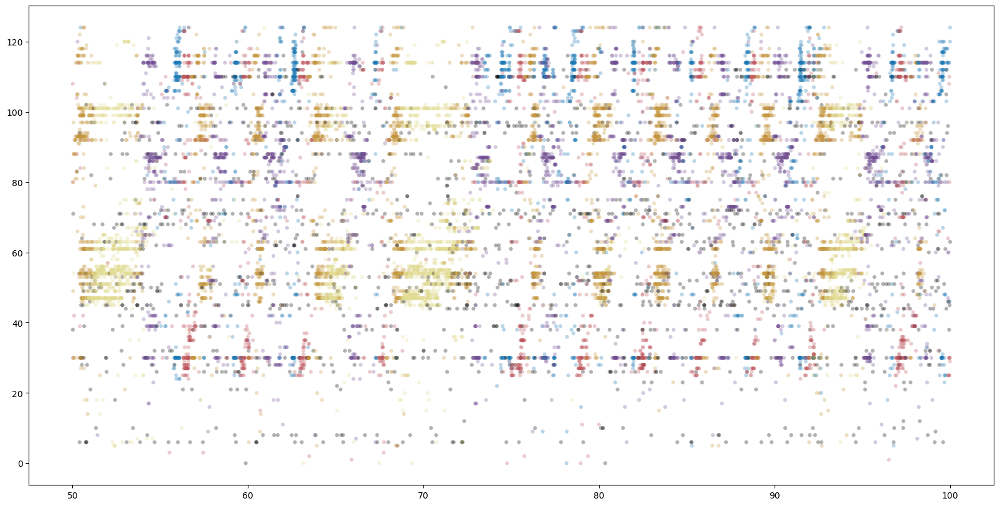

In [255]:
plot_between = [50, 100]
plotsubset = np.intersect1d(np.where(unmasked_spikes_df.timestamp.values > (plot_between[0])),np.where(unmasked_spikes_df.timestamp.values < (plot_between[1])))
neuron_order = neuron_permute_loc[unmasked_spikes_df.neuron.values.astype(int)-1]
fig, ax = plt.subplots(figsize=(20,10))
ax.scatter(unmasked_spikes_df.timestamp.values[plotsubset],neuron_order[plotsubset],s=20,linewidth=0,color=colors[plotsubset], alpha=0.3)

# centroids = np.array([None, 170, 140, 105, 40, 70])
# for i in range(len(sequence_times)):
#     ax.scatter(sequence_times[i],centroids[sequence_type[i]],color=colordict[float(sequence_type[i])],marker="*",s=14)
# ax.set_title("Ordered and labelled")
# ax.set_xlabel("Time / s")
# ax.set_ylabel("Neurons")
# ax.set_ylim([0,number_of_neurons])
# ax.set_yticks([0,number_of_neurons])
# ax.set_xlim(plot_between)

# for i in range(len(np.unique(sequence_type))):
#     ax.plot(time_axis, out_signal[i, :]*centroids[i+1], color=colordict[float(i+1)])
#     ax.axhline(y=seq_involved_neurons[i+1][0], xmin=np.amin(time_axis), 
#                xmax=np.amax(time_axis), color=colordict[i+1], lw=1)
#     ax.axhline(y=seq_involved_neurons[i+1][1], xmin=np.amin(time_axis), 
#                xmax=np.amax(time_axis), color=colordict[i+1], lw=1)
# plt.show()

In [227]:
sequence_times

array([ 41.13965522,  28.55556795,  19.76247322, ..., 586.64473373,
       590.36634879, 572.73423344])

In [228]:
latent_event_history_df_split[latent_timespan_mask][amplitude_mask].timestamp

336471    54.351972
336473    58.294398
336492    56.608277
336497    50.419736
336506    59.285290
            ...    
336764    85.823496
336765    83.473140
336766    77.519319
336767    92.572946
336768    82.328725
Name: timestamp, Length: 128, dtype: float64

In [194]:
neuron_order[mask][background_keep_mask]

IndexError: boolean index did not match indexed array along dimension 0; dimension is 125 but corresponding boolean dimension is 159426

In [188]:
plotsubset[neuron_permute_loc]

IndexError: arrays used as indices must be of integer (or boolean) type

In [189]:
plotsubset

array([     8,      9,     10, ..., 158420, 158421, 158422], dtype=int64)

In [190]:
neuron_permute_loc

array([ 19.,  93.,  59.,  18.,  66.,  74.,  75.,  71.,  69.,  55.,  26.,
         3.,  99.,   0.,  21., 103.,   5.,  56.,  84.,  36.,   1.,  58.,
        77.,  41.,  62., 102.,  46.,  22., 122.,  65.,  80.,  15.,  60.,
        32.,  98.,  57., 120.,  95.,  67.,  87.,   8.,  47.,  52.,  79.,
        76.,  45.,  11.,  20.,  68.,   7.,  91., 105., 100.,  72.,  73.,
       111.,  25.,  48., 117.,  90.,  29.,  10., 119., 118.,  27., 121.,
        34.,  33.,  85., 113., 109.,  70., 115.,  42.,  31.,  24.,  28.,
       124.,  40., 106.,  43.,  37.,  38.,   2.,  23., 123.,  35.,  89.,
       104.,  81., 108.,  78.,  86.,  12.,  54.,  92.,  14.,  61., 101.,
        64.,   4.,  97.,  51.,   6.,  50.,  53.,  49.,  96.,  44.,  13.,
        63., 110.,  30., 114., 107., 116.,  16., 112.,   9.,  17.,  39.,
        88.,  83.,  82.,  94.])

In [145]:
neuron_spike_division[neuron,neworder_byeye[i]]/np.sum(neuron_spike_division[neuron,:])

0.08070500927643785

In [142]:
neuron_spike_division

array([[0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
 

In [132]:
neuron_spike_division[neuron,neworder_byeye[i]]/np.sum(neuron_spike_division[neuron,:])

C:\Users\Emmett\AppData\Local\Temp\ipykernel_3308\2568767661.py:1: RuntimeWarning: invalid value encountered in double_scalars
  neuron_spike_division[neuron,neworder_byeye[i]]/np.sum(neuron_spike_division[neuron,:])


nan

In [133]:
neuron_spike_division[neuron,neworder_byeye[i]]

0.0

In [134]:
np.sum(neuron_spike_division[neuron,:])

0.0

In [137]:
neuron_spike_division

array([[0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
 

In [16]:
# talk to rod about the alpha stuff, and work out how to do this. 
# Also ask about why he filtered and got rid of some neurons - doe sthis make a difference?
# Also ask aboutonly using last iteration? does this matter? is this the best way to do this? maybe it is? can we average across? would that be betetr or just needlessly complex? 

[19,
 8,
 6,
 10,
 5,
 11,
 13,
 11,
 13,
 11,
 13,
 15,
 14,
 13,
 12,
 24,
 16,
 11,
 13,
 13,
 13,
 10,
 16,
 30,
 18,
 21,
 21,
 14,
 21,
 13,
 16,
 18,
 12,
 8,
 23,
 24,
 59,
 49,
 46,
 28,
 9,
 12,
 9,
 2,
 4,
 4,
 3,
 6,
 3,
 7,
 5,
 17,
 35,
 45,
 31,
 44,
 35,
 41,
 48,
 27,
 33,
 26,
 13,
 15,
 19,
 10,
 18,
 15,
 16,
 13,
 16,
 16,
 19,
 19,
 12,
 5,
 14,
 18,
 15,
 18,
 14,
 20,
 16,
 16,
 16,
 18,
 15,
 11,
 16,
 21,
 34,
 46,
 19,
 7,
 20,
 21,
 12,
 17,
 5,
 14,
 21,
 18,
 26,
 17,
 16,
 14,
 12,
 13,
 13,
 24,
 19,
 21,
 12,
 16,
 13,
 19,
 21,
 5,
 4,
 9,
 29,
 44,
 63,
 50,
 48,
 20,
 19,
 7,
 8,
 13,
 14,
 38,
 44,
 24,
 23,
 14,
 21,
 25,
 17,
 19,
 11,
 9,
 35,
 13,
 24,
 9,
 9,
 11,
 12,
 10,
 11,
 29,
 16,
 15,
 12,
 8,
 11,
 14,
 22,
 16,
 14,
 13,
 19,
 14,
 10,
 30,
 12,
 17,
 9,
 27,
 68,
 50,
 37,
 15,
 7,
 8,
 5,
 4,
 6,
 5,
 7,
 13,
 13,
 36,
 51,
 26,
 24,
 29,
 54,
 13,
 8,
 9,
 26,
 17,
 19,
 22,
 15,
 28,
 16,
 32,
 18,
 9,
 18,
 26,
 22,
 6,
 20,
 13

In [32]:
neuron_spike_division = np.zeros((N_neurons,6 + 1))

In [33]:
neuron_spike_division

array([[0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
 

,x1,x2,x3,x4,x5,x6,x7,x8,x9,x10,x11,x12,x13,x14,x15,x16,x17,x18
62375,-10.908468,-9.472944,-9.867683,-13.963212,-14.009763,-8.629973,4.724373,-0.296808,0.586045,-6.681109,0.472550,-3.084473,4.166107,0.271779,2.578557,8.449707,6.407030,15.899557
62376,-8.397775,-10.827675,-5.380396,-11.050981,-3.937883,-2.638715,1.402381,1.262523,1.174892,0.750644,-0.328930,0.006581,6.045389,3.155030,0.248300,116.623955,0.009040,0.008620
62377,-8.184337,-11.453160,-5.655925,-7.673388,-7.143237,-6.071607,-0.784228,-12.842356,0.126481,-0.947029,0.242036,0.191562,0.285436,631.630460,0.107521,0.299189,0.034133,0.020409
62378,-9.617328,-10.206480,-7.300535,-7.069354,-6.350506,-7.100028,-3.260082,1.059528,-0.678298,-0.844873,0.323911,0.143470,1.496402,0.284097,0.421195,0.281522,0.088884,0.063879
62379,-7.574718,-5.960654,-4.753909,-8.232491,-5.170323,-6.600489,-0.959616,-4.383681,1.539693,0.050141,-0.640310,-0.198090,0.219305,5.929277,0.199823,0.473089,0.043074,0.014546
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62495,-2.770151,-2.994643,-8.732548,-4.409251,-3.475882,-9.194577,0.158145,11.593369,-0.948988,-0.496607,-0.088201,-0.131241,0.039268,26.262101,0.745809,0.167667,0.015553,0.185986
62496,-4.331293,-3.706480,-9.617573,-4.357055,-2.730555,-4.570751,-0.004149,5.745616,1.054531,-0.556468,0.203175,-0.249467,0.011596,7.142364,0.711849,0.212511,0.051137,0.023191
62497,-5.302287,-3.344162,-11.758846,-4.504711,-3.720913,-5.935485,0.180209,5.761189,0.074049,-0.334517,0.292990,-0.202598,0.092781,45.534385,0.485304,0.237386,0.061513,0.017719
62498,-8.878267,-4.158775,-9.434139,-4.936076,-4.428847,-5.895618,-0.272313,4.580330,0.025168,-0.535403,0.224693,-0.092263,0.814904,62.265251,0.366972,0.174699,0.025910,0.017296
